# Sentiment Analysis using Doc2Vec

Word2Vec is dope. In short, it takes in a corpus, and churns out vectors for each of those words. What's so special about these vectors you ask? Well, similar words are near each other. Furthermore, these vectors represent how we use the words. For example, `v_man - v_woman` is approximately equal to `v_king - v_queen`, illustrating the relationship that "man is to woman as king is to queen". This process, in NLP voodoo, is called **word embedding**. These representations have been applied widely. This is made even more awesome with the introduction of Doc2Vec that represents not only words, but entire sentences and documents. Imagine being able to represent an entire sentence using a fixed-length vector and proceeding to run all your standard classification algorithms. Isn't that amazing?

However, Word2Vec documentation is shit. The C-code is nigh unreadable (700 lines of highly optimized, and sometimes weirdly optimized code). I personally spent a lot of time untangling Doc2Vec and crashing into ~50% accuracies due to implementation mistakes. This tutorial aims to help other users get off the ground using Word2Vec for their own research. We use Word2Vec for **sentiment analysis** by attempting to classify the Cornell IMDB movie review corpus (http://www.cs.cornell.edu/people/pabo/movie-review-data/).

The source code used in this demo can be found at https://github.com/linanqiu/word2vec-sentiments

## Setup

### Modules

We use `gensim`, since `gensim` has a much more readable implementation of Word2Vec (and Doc2Vec). Bless those guys. We also use `numpy` for general array manipulation, and `sklearn` for Logistic Regression classifier.

In [1]:
# gensim modules
from gensim import utils
from gensim.models.doc2vec import LabeledSentence
from gensim.models import Doc2Vec

# numpy
import numpy
import string
from string import digits
import os

import matplotlib.pyplot as plt

# classifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report


from sklearn.linear_model import SGDClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import SVC
from sklearn.svm import LinearSVC


# random
import random
import time


C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\gensim\utils.py:1197: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")


### Input Format

We can't input the raw reviews from the Cornell movie review data repository. Instead, we clean them up by converting everything to lower case and removing punctuation. I did this via bash, and you can do this easily via Python, JS, or your favorite poison. This step is trivial.

The result is to have five documents:

- `test-neg.txt`: 12500 negative movie reviews from the test data
- `test-pos.txt`: 12500 positive movie reviews from the test data
- `train-neg.txt`: 12500 negative movie reviews from the training data
- `train-pos.txt`: 12500 positive movie reviews from the training data
- `train-unsup.txt`: 50000 Unlabelled movie reviews

Each of the reviews should be formatted as such:

```
once again mr costner has dragged out a movie for far longer than necessary aside from the terrific sea rescue sequences of which there are very few i just did not care about any of the characters most of us have ghosts in the closet and costner s character are realized early on and then forgotten until much later by which time i did not care the character we should really care about is a very cocky overconfident ashton kutcher the problem is he comes off as kid who thinks he s better than anyone else around him and shows no signs of a cluttered closet his only obstacle appears to be winning over costner finally when we are well past the half way point of this stinker costner tells us all about kutcher s ghosts we are told why kutcher is driven to be the best with no prior inkling or foreshadowing no magic here it was all i could do to keep from turning it off an hour in
this is an example of why the majority of action films are the same generic and boring there s really nothing worth watching here a complete waste of the then barely tapped talents of ice t and ice cube who ve each proven many times over that they are capable of acting and acting well don t bother with this one go see new jack city ricochet or watch new york undercover for ice t or boyz n the hood higher learning or friday for ice cube and see the real deal ice t s horribly cliched dialogue alone makes this film grate at the teeth and i m still wondering what the heck bill paxton was doing in this film and why the heck does he always play the exact same character from aliens onward every film i ve seen with bill paxton has him playing the exact same irritating character and at least in aliens his character died which made it somewhat gratifying overall this is second rate action trash there are countless better films to see and if you really want to see this one watch judgement night which is practically a carbon copy but has better acting and a better script the only thing that made this at all worth watching was a decent hand on the camera the cinematography was almost refreshing which comes close to making up for the horrible film itself but not quite
```

The sample up there contains two movie reviews, each one taking up one entire line. Yes, **each document should be on one line, separated by new lines**. This is extremely important, because our parser depends on this to identify sentences.

In [4]:
# read the IMDb dataset
doclengths = []
def load_process_data():
    
    for set_type in ['train', 'test']:
        for sentiment in ['pos', 'neg']:
            txt_filename = set_type + "-"+ sentiment + "own.txt"
            with open(txt_filename, 'w', encoding="utf-8") as the_file:
                path = os.getcwd() + "\\dataset poging 3\\aclImdb\\" + set_type + "\\"+ sentiment
                file_array = []
                for filename in os.listdir(path):
                    file  = open(path + "\\" + filename, 'r', encoding='utf-8')
                    for line in file.readlines():
                        doclengths.append(len(line.split()))
                        line = line.lower()
                        line = line.replace("<br />", "")
                        #line = line.translate(str.maketrans('', '', string.punctuation))
                        line = line.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))
                        remove_digits = str.maketrans('', '', digits)
                        line = line.translate(remove_digits)
                        print(line)
                        the_file.write(line+"\n")
            the_file.close()


In [5]:
load_process_data()


bromwell high is a cartoon comedy  it ran at the same time as some other programs about school life  such as  teachers   my  years in the teaching profession lead me to believe that bromwell high s satire is much closer to reality than is  teachers   the scramble to survive financially  the insightful students who can see right through their pathetic teachers  pomp  the pettiness of the whole situation  all remind me of the schools i knew and their students  when i saw the episode in which a student repeatedly tried to burn down the school  i immediately recalled           at            high  a classic line  inspector  i m here to sack one of your teachers  student  welcome to bromwell high  i expect that many adults of my age think that bromwell high is far fetched  what a pity that it isn t 
homelessness  or houselessness as george carlin stated  has been an issue for years but never a plan to help those on the street that were once considered human who did everything from going to s

i enjoyed this film yet hated it because i wanted to help this guy  i am in my fifties and have a lot of friends in the music business   who are now still trying to become adults    no more fans groupies money etc   and they are having such a hard time adjusting to a regular life   as they see the new bands etc getting the spotlight   it is almost like they have to begin anew   this film is a testament to what a lot of the old rockers from the  s and  s are going through now    and that s where i find the film sad and depressing but it portrays the life of an old rock star abandoned and lost in a believable way the young girl who arrives at his decrepit home reminds me of hollis maclaren  outrageous    and she is one lady in a film you will cheer for  this film is a must have for folks in their  s who have seen the rise and fall of bands people who knew the members  and have watched them hurt as age creeps in and popularity fades this is an almost perfect movie    sad but in a way posi

this movie is far better than the original the jerk  i would highly recommend it to anyone who like quirky humor  we have incorporated almost as many lines from this movie into our daytime discourse as we have from monty python the card game with the hobos and then with mr  suicide  the scene at the dinner table and his distaste for turtle soup  the original the jerk was too choreographed ans staged  while i like steve martin  he seemed like he was trying to hard  the jerk too is a spoof and will be enjoyed by anyone  the jerk too is family friendly unlike the original the jerk 
honestly  when i saw this movie years ago i immediately wanted to turn it off  as i sat there for the next  minutes or so  i realized that the actor playing navin stole the show  his facial expressions and comedic demeanor makes me shake my head as to why he hasn t been in more comedies  he has this  marty feldman  thing going for him but much  much more talent   taking nothing away from marty  the movie really

louis creed  a doctor from chicago  moves to a large house near a small town  since he is going to be giving classes in the university of maine s  along with him  is his wife rachel and their two kids  ellie and gage as well as ellie s cat  church  soon  they met their new neighbor and old man named judd crandall judd not only warns louis and rachel about the danger that is the highway that runs past their house that is constantly a way used by big trucks  but also show to the family a pet cemetery that is located near their house  judd starts to talk about the importance of the pet cemetery  but rachel is against to talk about death and spirituality with her children  since she has traumas from her sister zelda s death during the first week of the family in the new house  louis already has dead people to deal with  victor pascow  a student who has been fatally injured in an automobile accident  addresses his dying words to louis personally  even though the two men are strangers  on th

bill crain s rarer than rare  slasher  movie certainly doesn t follow the standard stalk and slash guidelines that have become so essential of its counterparts  the bogeyman this time around uses grenades and small arms as well as an awesome array of melee weapons    a sin that s virtually unacceptable in most post halloween genre pieces  but there s still just enough familiarity to keep slasher buffs from checking the rule book and the plot never strays too far from the path that you ve grown to expect  just as wally koz s surprisingly decent  was seemingly put together with help from various members of his family  mirage seems to have been a joint production from relatives of the director  looking through the credits i noticed numerous  crains  listed in key positions throughout the construction of the feature  but despite fairly good distribution across the globe  the movie failed to make an impression either side of the atlantic and now it has become pretty much a phantom of the vh

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



this movie shows us once again  how genius the japanese directors are and were  this movie could be seen as a sort of a  silent   movie tetsuo   well eisenstein     
filmed just after the war  this story was made in order to highlight anglo american relations after the war  it ended up receiving the honour of being the first royal premiere after wwii remarkably the film tangles together the royal air force  sigmund freud psychology  the founding fathers of america and various others up the long stairs  special effects in its infancy  and beyond the heavenly gates without losing any of its integrity  although sounding absurd  this clever script leads and dances the viewer between heaven and earth with the skill of a mountain goat and a presents a charming ease rarely matched in cinema since  be prepared to have your heart warmed by this sweet  innocent and charming love story  roger livesey acts like a man possessed to steal the show     british cinema should cry when it remembers how g

star pickford and director tourneur    along with his two favorite cameramen and assistant clarence brown doing the editing    bring great beauty and intelligence to this story of poor  isolated scottish islanders    the same territory that michael powell would stake twenty years later for his first great success  visions of wind and wave  sunbacked silhouettes of lovers do not merely complement the story  they are the story of struggle against hardship the actors bring the dignity of proud people to their roles and pickford is brilliant as her character struggles with her duties as head of the clan  wavering between comedy and thoughtfulness  here with her father s bullwhip lashing wayward islanders to church  there seated with her guest s walking stick in her hand like a scepter  discussing her lover  played by matt moore see if you can pick out future star leatrice joy in the ensemble  i tried  but failed 
the silent film the pride of the clan starring mary pickford was supposed to 

i have read the short story by norman maclean  and the movie did justice to norman maclean s writing  my husband tends to reread it occasionally  and i myself have read it over and scenes of the movie keeps coming to mind  we have videos of many of redford s movies and we have watched  a river runs through it  many times  redford is part of the  famdamily  as he is always around  we never get tired of redford s perception of norman maclean writings  and the beauty of montana  the script reminds me very much of my own upbringing as my father had the same calling as mr  maclean s father  according to  a river runs through it    methodists are baptists who can read   a line which by the way is not in the short story  but i think that is a funny line  my husband and i are well read baptists i have heard a movie critic state that the pace of this movie is too slow  i disagree  as one search for inner peace  this is the type of movie that will make you contemplate the beauty of nature in th

as much as i like big epic pictures   i ll spare you the namedropping   it s great to kick back with a few beers and a simple action flick sometimes  films where the plot takes a backseat to the set pieces  films where the dialogue isn t so cleverly written that it ties itself in endless knots of purple prose  there are hundreds of films that fit the bill    but in my opinion gone in sixty seconds is one of the better ones it s an update of the movie that shares its name  it also shares that picture s ethos  but not quite it s execution  whatever was great about the original has been streamlined  whatever was streamlined was also amped up thanks to a bigger budget  often these kinds of endeavours are recipes for complete disaster   see the pug ugly remake of the italian job for one that blew it   but here  thanks to a cast of mostly excellent actors  sixty succeeds the plot and much of the dialogue isn t much to write imdb about  often you ll have scenes where the same line of dialogue

it is one of the better indian movies i have seen lately  instead of crappy song and dance or slum dog movies  all the actors have showed the right emotions at the right intensity with right timing  it is the hallmark of a good movie  that it make the viewer go back and research the subject  which exactly what i did checking on harilal  i always enjoy akshay khanna s subtle style of acting and interestingly he had rather a complicated relationship with his own father vinod khanna  albeit not as dramatic as gandhis and wonder how it helped him essay this character  i was impressed by the direction and  thumbs up for anil kapoor for producing such a classy movie 
this movie is simply awesome it was a very sensitive issue and movie was superb this movie did not create any controversy in india  as far as i know  and its publicity was also kept low initially i thought that this movie would simply be a waste of time since most of the indian directors and producers used to change the theme ev

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



don t spend your money or your time on this pitiful piece of film in the guise of cinematography when every third word is devoted to foul language and there is no real plot as well as having a cast of old actors who are still giving the same dated performances from the past and have not evolved in their careers  leaves a lot to be said  i was expecting something better from award winning actor benicio del toro  the vision that others may have of puertorricans will be irreversibly distorted by such trash as maldeamores  a foul word at a given moment in a film may be used to emphasize a given point of view and may even be funny or sad depending on its context  see the movie elsa and fred for example  but it should not permeate the plot  the movie is a total embarrassment and there was absolutely nothing funny or even cute about this film 
this film is a good example of how through media manipulation you can sell a film that is no more than a very unfunny tv sitcom  in puerto rico the dai

when i d seen the name of this movie  i d always thought it was a musical  like  the harvey girls   it s not  it s a pudding that overcooked  hit the kitchen ceiling  and was pried off and cobbled together  no music and not a period piece but thoroughly improbable it starts with patriarch james woods telling the eldest of his three daughters  a small child who grows to be barbara stanwyck  that she must maintain the family name and home we thus think it is going to be a historical intergenerational tale  and it is  for a brief time  then it turns into the story of cold hearted stanwyck s fight against lawyer george brent  why is she so dead set against him  well  why else  as we learn in a strange flashback sequence narrated by stanwyck  she had once thought she could inherit some money  for her sisters as well as herself  of course  by marrying  she hit on someone she took to be a country bumpkin  who was in fact budding lawyer brent lest anyone think the child they had  a young man o

i ll be blunt and to the point  this film is not good at all  the film buff part of me hated the acting  script  story  direction and almost all of the editing  amanda peet has proven that she can act  as she was a high point of  the whole nine yards   so she should have avoided this movie with a ten foot pole  however  the infantile part of me found this film to be very funny  if you can forget about how underpar the production quality is  and if you find smut jokes funny  then you should be all right  and for those of you who can t get off your pedestal  thats your choice  my inner child hasen t died  and i laughed a fair bit  even then  only a  out of ten  because as a movie  it really does stink 
it just seems bizarre that someone read this script  and thought   this is funny  i mean  it s so hilarious it just has to be made   who was this person  is he or she the person really responsible for this  are they the one s who owe me for my time  more so than the director writer this fi

this film  originally released at christmas    was long thought lost  a very poor copy has resurfaced and made into a cd  now for sale  don t buy it  the film is unspeakably terrible  the casting is poor  the script is awful  and the directing is dreadful picture roland young singing and dancing  and that was the highlight perhaps this movie was lost deliberately 
well i just paid a dollar for a dvd of this movie  and it wasn t even worth that  it seems to be from a poor print and is in the public domain  i am guessing neagle   despite her glory  awards  and reputation   is a homely british gal who can t sing or dance or act some of the fine old hollywood character actors on display here must have thought they were doing a classic  director herbert wilcox  neagle s husband  always thought anna was the most exciting and talented femme on the screen  he was mistaken  she was improbably popular in britain before and after wwii  her  serious  roles are even more ludicrous than her musical 

poor paul mercurio  after landing the role of scott hastings in strictly ballroom  the best film in history  he managed to find himself doing a lot of rubbish  none of the characters in this film is very unlikable  or even hateable  but mercurio s lead is the sort of person you prefer to ignore   completely unloveable and he wears overalls  big mistake in costume design  that one 
pointless boring film with charismatic mercurio completely wasted  released for a minute on a thursday in maybe one local cinema and avoided by the entire population of sydney except me and four others back of beyond is a project seemingly created by a producer looking for a fee  local actors like john polson and terry serio deserve better  well polson has morphed into a director of lame thrillers like swimfan and hide and seek  and terry serio seems never to get a guernsey apart from thug roles  but paul mercurio should have become one of australia s greatest exports on screen  roles like this are major disa

i don t know why  but for some sick reason  i think since i ve been on the disney sequel binge  i decided to just go ahead and see  dalmations  the first movie that was a remake of the disney cartoon classic starring glenn close as cruella de vil  it seemed like a sure hit  but it was just a bomb  i think the reason why these movies don t work is because  dalmations  the original  was a cartoon  it just worked better and was more appealing to the kids as well as adults  this was not really that fun because it s adults running around trying to act like cartoons instead of just actual human beings  i understand they re trying to make sure that it s appealing to the kids  but it s ridicules to see the way these actors are behaving in the film  and  dalmations s story isn t really that good cruella de vil has been in prison for a while  but things change when she is proved that she now loves animals and is a pleasant human being  but her reputation is now damaged as a puppy napper  but she

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



high heels are tricksy things  they can elevate women  or cross dressing men  to newfound heights  put forward a sharp statement of style and bring a touch of fragile elegance  alternatively  they can be a perilous foot pain that will inevitably lead to trips  falls and ultimate tragedy  tacones lejanos is more of a disappointment trip than a stylish high riser almodóvar s mother daughter drama is stylish for sure  but in terms of plot it s a tongue tied and tedious affair full of confusing  complex characters that never fully engage or make sense  a few moments of comedy aside  tacones lejanos just isn t interesting  the best bit comes at the beginning in a marvellously macabre case of manslaughter orchestrated by a child  from this brilliant bit of black comedy things are looking up  but then the film comes to a heel there s solid enough acting performances and there s some stylish  arty direction that you d expect from almodóvar  but otherwise tacones lejanos isn t an impressive pie

good deaths  good mask  cool axe  good looking girls    but watch out    no plot and little scares completely lower it s standards  they tried to make an  i know what you did last summer   but ended up making a  scream   but hey  what do people expect from a horror movie  answers totally vary  rent it if you want  but i regret ever seeing it 
the secret is   this movie blows  sorry  but it just did      spoiler    in this bad riff on i know what you did last summer and scream  beth  played admirably by dorie barton  joins several friends on a spring break trip  the group rents a fancy house and tries to enjoy a fun vacation  then  the deaths begin  first one then another then another of the friends is murdered  leading to a sad and trite climax with predictable results  one note  dorie barton is the poor man s reese witherspoonshe looks like reese  acts like reese and could pass for reese in a police lineup  maybe that s how they cast her  anyhoo  decent cinematography and fair acting

having just seen this on tmc  it s fresh in my mind  it s obvious that while the stooges are featured stars  they don t really run the show  first  they re broken into  groups   moe  as  shorty  and larry and curly as a pair of vagrants  so there s not a whole lot of full team work  the love story that fuels the plot is uninteresting  the two ladies are the only ones with any acting ability  there s another group of musical stooges that are unfunny  unless you consider their attempts at being funny to be sadly buffoonish  the music is tiresome  they drive cars to the ranch and then depend on horses  the dorky western wear is silly  and there s an awful lot of the movie with no stooges on camera  by the way  this is obviously after curley s first stroke  and his reduced energy level is clear  vernon dent appears early on in an uncredited role  i loved everything these guys ever did  including all the non curley stuff  but this little dogie is pretty lousy 
the three stooges in a feature

ok i had higher hopes for this carnosaur movie simply because it seemed like the sequels were getting better as they came out  i did like carnosaur  better than   i figured well this one is newer so it must be better right  well    i quickly learned i was wrong  i was extremely confused with the casting  they brought back rick dean for another spotlight character and michael macdonald as a police officer  now for rick dean lol  in carnosaur  i thought he fit the role pretty well and wasn t really annoyed by him  now in carnosaur  wow they placed him as an elite soldier  now we are getting goofy here  the movie actually started out pretty good with a decent gun fight and dinos escaping out of there little freezer trucks  but as soon as scott valentines team showed up we had a mix of a romantic comedy with very funny performances from retarded and floppy dinosaurs i ll start with the raptors first  they had there tails drag the ground  which in the second one they were up in the air whic

i ve seen some crappy movies in my life  but this one must be among the very worst  definately bottom  material  imo  that is  we follow two couples  the dodds  billy bob thornton as lonnie earl and natasha richardson as darlene  and the kirkendalls  patrick swayze as roy and charlize theron as candy  in one car on a roadtrip to reno apparently  lonnie isn t too happy with his sex life  so he cheats on his wife with candy  who s despirately trying to have a baby  roy  meanwhile  isn t too sure if his sperm is ok so he s getting it checked by a doctor now  i had read the back of the dvd  but my girlfriend didn t  and she blurted out after about  minutes   oh yeah  she s gonna end up pregnant but her husband can t have any baby s   spot on  as this movie is soooo predictable  as well as boring  and annoying  meaningless  offensive  terrible an example of how much this movie stinks  the two couples set out in their big car towards nevada  when they are stopped by  police officers  as they

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



on the whole one wishes this was a better film  but it has enough flashes of intense power to make it worth while  peck made this film during the same period that he made the gunfighter  before he apparently decided he was a monument rather than an actor  a pity  he was a fine actor  perfectly willing to tackle characters that were not very likable  and to do them extremely well  the character he plays here is driven and  when necessary  ruthless  given the mission the character has been assigned  and the  men  with which to do it  those characteristics are essential without being a spoiler  think of this film as an early  grittier example of the dirty dozen genre  the dialog in this film is a bit ham handed but it is atmospheric and intense and definitely tells a story worth telling  it contains good work by all the character actors and even barbara payton turns in a credible performance this one isn t often shown on television so your local video store may be the only place to find a

watching this hilariously retro but very entertaining career girl tale  i was floored by joan crawford s first appearance  all i could think initially was   my god  it s the same face as michael jackson in his notorious booking photo   about  minutes into the movie  diane baker and hope lange get out of a cab in greenwich village  as they walk down the street  you can see part of a sign in back of them for the stonewall bar    scene of the epochal  riots  that are considered the trigger for the modern gay rights movement speaking of baker and taxis  i had to laugh when she gets into one and tells the cabbie   th and sutton place  please    and be careful of the bumps   can you imagine the reaction to that from a driver in today s manhattan   she says that  of course  because she s pregnant and doesn t want to hurt the fetus  but that doesn t stop her from jumping out of a moving car when she finds out bob evans wants her to have an abortion  well  they had to find a way for her to lose

here s a well made war story  nicely shot and well acted  the portraying of the italian and german occupancy of greek island kefalonia is well done  john hurt as pelagia s father and the island doctor is superb  nicolas cage does a good job as the captain from the title  penelope cruz does a good job of being beautiful and batting her eyelashes at cage  there s heroics and humor  there s drama and romance  and it is all set on an idyllic island oddly enough  a very similar  or should i say almost identical  storyline  with the same characters going through the same series of events  is told in a novel by the same title  written by louis de bernieres  this wonderful historical novel tells the story of beautiful pelagia  daughter of doctor iannis  and their life on kefalonia during wwii  pelagia s fiancee  local fisherman mandras  enlists when the italian army invades northern greece from albania under false pretenses  when the axis finally prevails  with a lot of help from the germans  

exclusively for coop s lovers  though clint eastwood very strong though unobtrusive presence is a great asset of this very good documentary film  it is a biography of gary cooper  based mainly on his filmography  but also on more private archives  which show him as a child  as a young man  as a family man  with some of his friends  picasso  hemingway  etc    as an older man  finally as a sick and close to death man  after  the end   i did not have the feeling that i knew the man any much better  but i have spent a very good moment  re viewing many of the best moments of his movies  and my respect for the very talented actor and great professional was increased tenfold  the film shows  most interestingly  how the career of cooper can be paralleled with the evolution of usa society before and after ww  two of the great moments are the time when cooper has to answer justice about communism in the movie world  and when james stewart  a very great one  too  received an award for cooper one 

another popular screening for a british picture at coalville s century theatre  a well crafted  solid drama with an ever developing plot and ongoing  twists in the tale    as the lies piled up  a masterclass of acting by a flawless cast  well marshaled by first time director julian fellowes  outstanding performance  as usual  by tom wilkinson but good turns by all concerned including supporting actors linda bassett and john neville  our audience was engrossed by this film  which includes a couple of shock incidents which really make you  jump   a good tight production at around only  minutes  probably produced on a very limited budget  but a success  which should see fellowes directing again for the big screen  some publicity for the film seemed to suggest it was set in the s  as per nigel balchin s novel but obviously this is not the case  recommended viewing 
although this film is set amongst the sophisticated english upper classes it is a simple story of a couple torn asunder  it ha

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



the video opens with a scene from a horror movie  in which a man proposes to his girlfriend  he begins to tell her that he is  different   as the full moon rises  he morphs into a werewolf  he then pursues her through the woods  and right before he attacks  we re taken to the inside of the movie theater  inside the theater are michael and his girlfriend  she s too scared to watch any longer  so they leave  as they exit the theater  he begins to tease her    it s close to midnight  something evil s lurking in the dark      michael then sings and dances his way down the street with his girlfriend  this scene shows michael s skill with the camera  he never once acts  aware  of its presence  as many other artists do  as they make there way past the graveyard  the graves begin to open    once they arrive at an alley  they are confronted with a horde of the undead  we then see the horror stricken face of michael s girl  who wouldn t have a horror stricken look if their date morphed into a zo

jackass number two is easily the most hilarious film of   beating the also hilarious clerks ii  it is one of the best sequels in recent memory  beating jackass the movie in every way  now  this film may be the funniest  but it is also the most offensive  appalling  and utterly disgusting  you will find yourself feeling sick several times throughout the film  i m completely serious when i say don t eat anything before watching or during this film  because chances are that it will literally come back to haunt you  keep the drinking to a minimum as well  you ve been warned  because  just like the tagline says  it will make you beg for mercy jackass number two follows the crazy men from the hit show jackass  johnny knoxville  bam margera  ryan dunn  steve o  chris  party boy  pontius  preston lacy  ehren mcghehey  dave england  brandon dicamillo  and jason  wee man  acuna  chris  raab himself  raab is absent  as they perform the most outrageous  life threatening  and revolting stunts imagi

this is an example of why the majority of action films are the same  generic and boring  there s really nothing worth watching here  a complete waste of the then barely tapped talents of ice t and ice cube  who ve each proven many times over that they are capable of acting  and acting well  don t bother with this one  go see new jack city  ricochet or watch new york undercover for ice t  or boyz n the hood  higher learning or friday for ice cube and see the real deal  ice t s horribly cliched dialogue alone makes this film grate at the teeth  and i m still wondering what the heck bill paxton was doing in this film  and why the heck does he always play the exact same character  from aliens onward  every film i ve seen with bill paxton has him playing the exact same irritating character  and at least in aliens his character died  which made it somewhat gratifying   overall  this is second rate action trash  there are countless better films to see  and if you really want to see this one  

this movie is from the s  but it looks like it was made in the stone age  the effects are way too cheesy  my copy has sandra bullock on the cover  which was why i bought the movie  she was in the movie for about  minutes of total screentime  she would most likely deny all involvement in short  there is no part of this movie worth seeing  except to laugh at how bad it sucks  rent this to see the worst film ever made  bar none 
but certainly a serious contender for one of the worst  of all time i got this dvd cheap  with sandra bullock as headliner on the case  this is false advertising   she s on screen for almost  minutes of the movie on the other hand  there was no other selling point for this movie   the dialog was horrible  the editing was apparently done by someone who was strung out on quaaludes  the directing was     well  let s just say that my  yo daughter could do better  but i hope she never sees such faint praise from me  it s possible that the family cat could have done bet

my friends and i watched this movie last night  it was pretty incredible  by all means  this was probably the worst movie i have ever seen  at first  it was tolerable  it stunk of bad improv but it was pretty friggin hilarious  despite the scenes being too long   drawn out and the terrible quality  i read   budget above    sounds about right  of the film itself the biggest problem came from the lack of a script  with a background in improv  i know how hard it can be to keep scenes short   efficient  what happened in this film was that the actors were left to improvise the scenes and they didn t know when to stop  they just kept going for ages on stupid topics  at first i thought this was because the movie was short and they needed long  useless scenes to flesh it out  as the movie progressed  i realized it was just a really bad movie there were a lot of parts where i could see that the film maker had a really good idea for a shot but not the resources  or talent    to pull it off effec

a few years ago i saw the scent of green papayas by the same director  my feelings about both films are in fact the same  beautifully shot  but terribly slow and boring  i saw this film in a sneak preview  and left after half an hour  couldn t stand it anymore  how can one make an interesting film about people who are constantly telling each other how happy they are  and how perfect their lives are           i had a fantasy about a forgotten american g i   still wandering around in the vietnamese jungle  who was not aware the war had ended  how he would suddenly pop up in the film  and would start emptying his m at the characters in the movie  the red of their blood would make a beautiful contrast with all the green plants in the film            so i was not very much gripped by this film  time to leave 
this is the worst film i ve seen in a looooong time  it reminded me of a cirque du soleil show i saw in vegas six years ago    without the athleticisme  by that i mean a few striking  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



i have a lot of respect for mr  argento s work  but this film lacks many of the qualities that make his films really unique  the opening to the film is great  and sets you up for the possibility of a really scary horror film  what occurs for the rest of the film lacks structure or purpose and does not build into much  there are some good performances  though  and a lot of great atmosphere  the end of the film is weak considering everything this builds up to  where there should be some grand climax of huge proportions you instead get a very typical conclusion that too many other bad horror movies use  making it feel like they just needed to wrap it up  a couple of scenes are very memorable for their imagery  but in the end the film does not gel to make a really good movie  unless you feel you must see everything this director made i suggest passing on this one   
in the same way lamberto bava was a substandard facsimilie of his father  mario  who was an extremely overrated director anyw

thats not saying much  this killjoy film has better cinematography and is more professional looking than the last  that doesn t mean it s more professional sounding  that horrible last film was about gangsters killing a kid and then being haunted by a voodoo clown  i thought the guy that played killjoy in the last one was a bad actor  but wow    this killjoy is honestly the downright worst actor i ve seen in any movie  and i ve seen a lot of movies  thed last movie the clown came in about  minutes in  this one s shorter and the clown doesn t even come in until  minutes in  and it s only  minutes long    i give it a  because the acting from some characters is ok 
   the first  killjoy   but here s the review of killjoy   contains spoilers  so beware readers oh my  oh  my  my  my  i ll start off with telling you that i had no hopes in the least bit that this movie would be good  considering that killjoy  the first movie  is without a doubt the worst movie ever made  the sequel didn t hav

there ought to be some kind of prosecution to punish producers from financing screenplays this stupid  i feel that some kind of criminalization of bad film might prevent more films this idiotic from being made  sure it has an interesting cast of characters  but i don t think i ve ever seen a more cardboard performance from an entire cast as in this uniquely crappy piece of crap  that director ought to be punished somehow for not eliciting at least some kind of performance out of these people  so detachment is a theme   no really  they ll beat you over the head with this one   it doesn t mean every character has to recite their lines as if they on npr  did i mention this movie was crappy  lastly i m not sure what connection one s memories would have with terminal bone cancer  but i m reasonably certain if you were totally brain dead your cancer would continue to grow regardless  this movie is an insult to cancer patients  medical professionals  and non retarded people  oh  and lastly  b

you know that mouthwash commercial where the guy has a mouth full of listerine or whatever it is and he s trying really hard to keep from spitting it up into the sink  that s a great metaphor for this movie  i kept watching  even though it was really difficult  but keeping mouthwash in your mouth will leave you with a minty fresh feeling  this movie left me with a bad taste in my mouth  i should have spit it out when i had the chance the premise is corny enough to be fun  for the first time in like a thousand years  gargoyles have returned to romania  and all of the priests who knew how to fight and kill these things are long dead  it s up to michael pare and some other secret agents to get to the bottom of things before the gargoyles run amok  unfortunately  the premise is completely lost in bad dialog and less than enthusiastic acting on the part of the human leads  the best acting is done by the cg gargoyles in the end  this movie feels like a poor man s van helsing  if you check yo

i recently went to a free screening of soap girl where the filmmakers were present  before the movie they strutted around  laughing  taking pictures  i was excited to see them dressed up in real life  and couldn t wait to see the movie on the big screen during the movie  the audience errupted with laughter  it was clear to me then that they weren t laughing with the picture  but at the picture  this is purely a grade b movie with no logic behind it  throw in some nudity  some blood and whala  you have a movie after the movie i approached a bunch of the filmmakers and asked them why they wanted to make this movie  they all acted so serious  like they were serious filmmakers  they each told me something different  to make a controversial movie  a funny movie  an uplifting movie  a socially responsible movie  everybody mentioned something different  it was clear to me that none of the filmmakers knew what kind of movie they were making  and they were now trying to recoup their money by pu

the main character is a whiny  irresponsible study of how to throw yourself a pity party  she loses it at the drop of a hat  acts pathetic  is schizophrenic  and left me wondering why on earth she doesn t understand why these  friends  of hers haven t called her in three years   get a clue  sister   you re a juvenile mess   i couldn t stand her or the friends  i never felt connected to any of the characters  to make the entire movie even more unbearable  someone went far out of their way to put the world s most hideous collection of crocheted and knitted hats in existence on film for all of eternity  this alone should warrant someone be put on wardrobe probation for a decade  the acting wasn t awful  but not really believable either  and in the end the only thing that i did care about was the two hours i m never going to get back  don t waste your time   go catch up on a dentist appointment instead 
a woman who deals in art starts to have a passionate love affair with a man named john 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



this movie probably seemed like a great idea in pre production   let s make a movie about one of the greatest and most controversial athletic coaches of the modern era  and let s cast brian dennehey as coach bobby knight   that s where this movie went terribly wrong  why cast an actor who bears no semblance of the man he s portraying  and then  why let this actor turn his character into not coach knight  but brian dennehey in a red sweater  as i sat watching this movie on espn  i didn t find myself believing this man was actually coach knight  he didn t look like him  talk like him  act like him  or even walk like him  i could not get past this fact  and thusly  i could not enjoy the movie  when paul newman and robert redford were cast as the outlaws butch cassidy and the sundance kid  we didn t care if they were accurate historical models of their true characters because most of us had never even heard of these men until we saw the movie  but  with someone as visible in today s media 

i had no idea this movie was produced by  wwe   wrestling is lame enough  why did they have to soil their name further by making a movie as crappy as this one was   i found it to be a complete disappointment  if i had of known this movie was going to be as stupid as it was  i would have stayed home and done something more entertaining  sure  i ll give them the credit of the cool effects  but the killer didn t seem as scary as he could have been  he lacked a number of things  but i ll let you point them out for yourselves  the plot was a great idea  just could have been done in a much better way  maybe in the future  wwe will stick to its moronic wrestling and stay out of the film industry  
should i have expected anything other than putrid from carrot top  this was on of the worst movies i have ever seen  it is by far the worst comedy i have ever seen   chairman of the board  did not add humor to my attitude  rather it enraged me  that s right  carrot top is such a bad comedian that i 

this movie   desperate measures   was     i m not quite sure how to even put it into words  was this supposed to be a comedy  i couldn t stop laughing at how absolutely ridiculous it was  i love michael keaton  and i cannot actually comprehend that he did this  they did a good job at keeping my attention because i couldn t wait to see how much more ridiculous it was going to get minute by minute  i actually just registered on this site so that i could get this out  i don t review movies  i don t have time for this  but i cannot let this go knowing i haven t done my civil duty by letting people  those who have an iq of  and above  know that this is no action thriller  it is honest to goodness funny  you people that actually got thrills off of this scare me  go watch a good movie like million dollar baby  clint eastwood s acting is not superb  but i was balling at the end  exercise your brain america 
exceptionally bad  i don t expect much from garcia since he is one of the most overrate

okay  so maybe the acting wasn t bad  but i am typing this review as a public service to prevent anyone else who happens upon the intriguing beginning of this telefilm from throwing away two hours of their life waiting for some plot development that will never come  the chief investigator has a gut feeling who did away with the missing marine officer  guy   and few people other than uninvolved bystanders and the accusee seem to dispute her  so what is the point of staying with this drama  beats the heck out of me  i kept thinking  or hoping  there would be some sort of plot twist or new revelation  but none was forthcoming  in summary  i cannot think of a single reason to sit and watch this pointless tv movie  based on a true story or not 
jeff powers  lou diamond phillips   young guns      a cop with a history of roughing up criminals  is recruited into an elite clandestine lapd division  this doesn t sit well with jeff s newspaper reporter girlfriend  kelly  chelsea field  who s look

this was terrible  mean spirited  and full of the worst clichés and racial stereotypes i ve seen in a looong time  seeing hayden p trying to act  ghetto  was painful  hi  one pant leg up on yer sweats and some braids downs t make you  down with the homies    solange knowles pretty much grimaces through the entire movie  most of the set sequences look like they were filmed in cardboard boxes   what was up with the finale    and poor rihanna was just plain exploited to get people to watch her  act   which she can t put simply  this film downs t even deserve one star  please put this tired franchise to rest  or at least make the next one bring it on iv  cheerleaders vs  freddy   jason 
all right  let s be realistic about this  nobody goes into a movie produced by wwe films  whose owner has challenged god to a wrestling match   directed by a former porn director  the man gave the world the between the cheeks trilogy   starring a wrestler named kane  and expects a little slice of art on a g

hi guys  this is my first review and i would had to have picked the worst movie to review  as i only watched  minutes of it but trust me you could see this movie was going nowhere  the acting was deplorable  the camera work and lighting looked as though it was shot and run by a pack of  year old s  no offence to  year olds i just couldn t take anymore i got off my couch  took the the house of adam dvd out of the dvd player and threw it in the garbage  maybe if you are a colin farrell fan this movie may interest you  because the character in the movie  anthony  is a colin farrell look a like  but that is as far as it goes  he certainly will never have col s acting abilities  i gave this movie a rating of   awful  only because there were no minuses in the drop down list cheers 
first and foremost i am a gay man  although do not live my life within the so called  community   and it s because of films like this that gay themed movies are not my favorite genre because   of them are crap  li

i think this movie was made backwards  first they shoot a whole lot of scenes and action  and explosions  and then the story writers got to work trying to find a story to tie all scenes up together  this movie is without any doubt the worst movie i have ever seen  your average porn movie comes with a much better written and much more coherent script  the movie makes no sense  seriously  even if you are a segal fan there s no reason you should ever want to see this movie  except if you re one of those folks that like to stare at accidents  because this is a horrible accident  and should never have been released upon this world boran 
lord have mercy  why was this film made  why did seagal and rising star max ryan agree to be in it  the foreigner is so excruciatingly bad in every conceivable way that it boggles the mind the film has an ultra cheap look to it  like a budget of a couple of bucks was far out of their reach  what s worse is that the makers know this and try to make it look s

this movie is so bad there are not words to describe it  if i got a video camera of a monkey dancing for an hour and a half it would be a heck of a lot more entertaining than this  the plot is so dull and unimaginitive it is not even worth mentioning  the best part of the movie was when the credits roled and i got a chuckle out of knowing the lead actors name was james bond iii  just trust me and stay far away from this trash heap 
absolutely nothing is redeeming about this total piece of trash  and the only thing worse than seeing this film is seeing it in english class  this is literally one of the worst films i have ever seen  it totally ignores and contradicts any themes it may present  so the story is just really really dull  thank god the  s are over  and god save whatever man was actually born as  james bond iii  
for me  it just didn t seem like gi joe at all  when i watched it as a kid  i just didn t care for it  in fact the part i liked best about this one was the opening cre

i first saw this movie at a saturday matinee when i was very young  i thought it was cool and often thought about it  well i finally resaw it on dvd  it was still very entertaining but in a different way  it has to rank as one of the goofiest  campiest   s sci fi movies  it seemed filled with stock military footage  the dialogue is stilted and effects are crude  there is one line of dialogue that had me in stitches  the line jeff morrow says while on the beach with the babe  rent it if you need a movie to watch with a bunch of drunken friends  it is a classic 
i once heard this movie described as either you ll love it or you ll hate it  from reading some of the other reviews and the ratings  i would venture to say that this is true  i am placing myself in the hate it crowd  i have seen some truly bad movies  boring movies  and even low budget movies  this movie is bad on all three fronts this island earth s exeter  jeff morrow   returns to his sci fi b movie roots as dr  les  minus gia

 spoilers   when i first saw the preview for this  it looked like a good old fashioned hallmark movie  i love bluegrass music  so i couldn t wait to see it  when we rented the movie  we read the back and it sounded even better  the film was pretty boring for the first half  every now and then a song would be played  then  i m embarrassed typing this a lesbian love seen came in  i that ther was something more then friendship between the teachers but i certainly didn t expect nudity and prolonged make out sessions  i was watching this with my mother and i was quite embarrassed  because i picked this movie  but besides that  it was an okay movie  the acting was fine  the actress who played deladis was great  to be honest  the soundtrack was the best part of the movie  i don t care to see the movie again but i bought the soundtrack the day after i saw the movie  and there are continuation discs that follow  if i were you  i would skip the movie and just get the music 
as a true canadian  i

for anyone who cares to know something about the real diane arbus  or who values psychological veracity  this film is abysmal  arbus was a brilliant  talented  restless  and troubled person  but this film depicts her as completely self involved  and truly bizarre in her taste and judgment  kidman portrays her as wan and vague  whereas she was someone who knocked people over with her charisma  the totally fictional relationship that is central to the film is quite unbelievable  and robert downey is truly annoying in his smirking portrayal of someone who seems to think he s superior to the rest of the world simply because of his affliction  the film depicts this encounter as being the source of arbus s interest in  freaks   which is a truly banal explanation for the inspiration behind some of the greatest photographs of the th century  the mystery to me is why people of some talent and intelligence chose to be involved with this film in any way 
in order to enjoy  fur   an imaginary port

after reading the reviews i decided to rent the dvd version  i like classical music and wanted to learn more about bach  i was disappointed  i guess i do not know enough about bach music and the the comments were not enough for me to understand the importance or what music was being played  maybe it would be appropriate with the guidance of an expert in bach s music that can explain the film  i really tried and saw the whole film hopping that i would be able to enjoy at least some of it  but i did not  see it at your own risk 
very stark  very drab  no real drama  why not just make a documentary  this isn t exactly the passion of joan of arc  the only reason for seeing chronicles is to hear the performances  i love bach s music and even i found it hard to sit through this misery of a film  the great gustav leonhardt plays  in two senses of the word  bach  we don t get much of a sense of him as an actor  since he s given so little to do dramatically  mostly  he gets to walk purposefully

this film is mildly entertaining if one neglects to acknowledge its numerous incongruities of plot and sheer lack of believability  bruce willis as  the jackal  never seems to live up to his reputation as a cunning mastermind of the underworld  instead  he bumbles about in broad daylight  parading a mishmash of shoddy disguises  why this man has never been captured before  or even identified  is beyond me  not once is the audience impressed by his cleverness or daring  considering the price he demands for his services  an exorbitant   million   his methods are decidedly low budget and stupid as for those in pursuit of him  they are at least as ridiculous in their behavior  they show no sense of expertise  instead relying on half baked conjecture which sends them traversing across the country at their whim  incredibly  these far fetched guesses  maybe he bought a boat  maybe he s in chicago  etc etc  invariably lead them straight to the jackal  who yet again escapes their clumsy grasp r

heaven  mary and all the saints above  a young man has got super sperm  it s miracle bejesus  call the pope  all you ladies out their desperate to get preggers  line up out side his door and drop your marks and sparks finest  risible retro ealing comedy type comedy  trying to bring you a bit of the auld irish charm  has an effect like placing two fingers down your own throat  voamitus maximus  one out of ten 
the most fertile man in ireland revolves around eamon manley who is  year old and still happens to be a virgin  he lives with his mother in belfast  he is also a very shy guy towards women  everything has changes for eamon when he is seduced by a woman as far as i can remember a neighbour   it is not because he looses his virginity but he discovers that he has a super power  despite having protection  this neighbour becomes pregnant  he is told by the doctor that he has very high sperm count  his mother brilliantly comes up with an idea which makes us see ginger headed babies all 

i ve enjoyed watching lost from the beginning and endured a few bad actors in poorly written episodes because when lost is good  it s really good  but this episode that features mr echos demise had so many drawn out scenes with lingering closeups of bad acting that i found myself tapping the fast forward button  this episode stood out so far as by far the worst  in fact  the variation in quality of lost has been so inconsistent  i find myself often wondering how many writers they are using i will continue to watch but hope things get better and hope i stop secretly wishing for the sub par actors in the series to die off 
was unlucky enough to see this while travelling by coach across africa  it was far and away the worst film i have ever come across  deserves to be the   all time worst     no acting  no plot  very little speaking  lots of ape like grunting though  in this hopelessly unlikely film  an unwitting self satire   you ll either laugh at it or cry 
i remember seeing this film 

it s hard to comment on this movie  it s one of the few movies dimension actually has not shelved  it s hard to come up with a reason why  and it was rushed into a an unimpressive  theaters it s opening day  maybe dimension was afraid of how people would respond to a swamp creature using his tow truck to pull a house apart piece by piece ray sawyer is just a tow truck driver  until he rescues a voodoo priestess from a bad car accident  and in return  he gets attacked by a bag full of snakes and drowns  at the morgue  ray comes back to life  and stalks a group of teenagers who witnessed the awful crash occur  what brings this movie down is it s paper thin characters  i didn t care for one moment about any of them  also  the dialog was less than ho hum  also  it was very predictable  characters did the typical stupid horror movie character things  like check creaky noises  call out people s names  and trip on a rock while being chased  i also could immediately pick out who the final girl

i can find no redeeming value to this movie  it appears to be loosely based on the lion king school of thought  father gets killed  son can t fill the shoes and tries to run away  etc  etc  etc  the only difference  other than being in a barnyard instead of a jungle  is that barnyard tries to  liven things up  with club type music  they go way over the top in trying to be cool  the problem is that it really isn t cool  it s like  that guy   everybody knows at least one of  those guys  who are older and still hang out with the younger crowd in a futile attempt to cling onto their youth  they try to be cool to fit in but they really aren t  that s this movie but hey  if you have money to burn and you feel like paying someone to suck  minutes of you life away  by all means don t let me stop you 
it was so boring  no plot whatsoever  basically a watered down version of the lion king mixed in with animal farm  again  no plot at all  horrible  worst hour and a half of my life oh my gosh  i h

when i watched this movie it was an afternoon after i got home from work  i love horror movies and have seen some really cheesy ones  but this takes the cake  the plot presented to the viewer in the beginning of the movie seems a little intriguing  but as the movie progresses the script makes a wrong turn with horrible cliches and bad presentation  which in turn makes the movie completely dull and boring  i don t mean to keep criticizing the script and plot  because believe me that is not the worst part  i have to say as a whole the acting was not terrible for beginning actors  and i was impressed with taylor locke  this being one of his first movies  the worst part of the movie was the special effects  they reeked of low budget  and really ruined the viewers entertainment  even if he had been remotely interested in the plot  i do recommend you watch this movie to understand the power of a bad script and plot  only then can you really appreciate good writers and directors 
oh god  why 

owen  david krumholtz  and chloe  denise richards  are a youngish couple living in manhattan  owen is a moderately successful magazine writer while chloe is an aspiring actress  happily for her  chloe gets big role on a sitcom and temporarily moves to hollywood  missing her  owen books a flight to lala land  as a surprise  when he arrives at her set trailer  however  the  house  is shaking  as chloe and her hunky co star are having a little romantic tryst  the writer and the actress are through  hurt and mad as a hatter  owen goes back to nyc  sympathetic friends decide to set him up on a blind date with nadine  milla jovovich  to get him out of his sulky funk  but  it goes badly  as the duo mix like oil and water  mostly due to each having a strong personality and owen s huge shoulder chip  yet  over the next few months  astonishingly  nadine and owen become pals  who confide in each other and hang out  can it turn into something more  well  who the heck cares  this film is so stupid 

marlene dietrich is magnificent as concha perez  the temptress who drives all men to despair in josef von sternberg s  the devil is a woman   her performance has nothing to do with  acting  in any conventional sense but she s incandescent  a true star in full command of her material  but she s the only good thing about the film   she s so good she keeps you watching this dross  i doubt if any other actress could have done the same  the story is an appallingly lame melodrama   surely pierre louys  novel was better   in which dietrich s amoral concha ruins the lives of two friends played by lionel atwill and cesar romero with a stiffness bordering on petrification  and for von sternberg it s an ugly looking movie   maybe in keeping with its fairly ugly subject matter   bunuel  on the other hand  thought enough of it to remake it as  that obscure object of desire  with a greater emphasis on the surrealist aspects of it all  down to casting two different actresses in the same role  neither

i approached this movie with the understanding that it was one of the worst flicks ever made  i sat down to watch it with this mindset  and was pleasantly surprised it s not great  it s not even that good  in fact  it s pretty poor  however  it s not as bad as i had been led to believe  by a long shot  it s pretty inept  and  evidently as a cost cutting measure  a lot of stock footage is pressed into service  a lot of which has no apparent relation to the narrative what it is  however  is an intensely personal movie made by a man who evidently did not have the skills or the funding to do his idea justice  before you discount  glen or glenda   out of hand  examine your own artistic skills  me  i d love to be able to draw  but anything i try to sketch comes out like stick men  i d love to be able to sing  but all i do is frighten young children wood had an idea  and unfortunately he didn t have what it takes to make it work  however  this was an incredibly daring movie for the puritan s 

this film is an abomination of all that is worthy in film making  the lead actor surprises his audience by not actually acting at all  we have to watch almost two hours of his bland soulless face  the jokes are all lame i never laughed once it was saturday night there were  of us having a beer all up for a laugh and then we put this on and you could feel all the warmth and colour being drained from the room  the film ended and the mood was ruined so we all went our separate ways  ruined the night   ok so pros and cons  pros beautiful setting in hawaii  looks good on bluray  cons worst acting ever  you can tell everyone concerned is just thinking about payday  predictable poor plot  zero character development  forced jokes which fall flat  many shots of the guys penis which to be fair acts better than him and has more charisma  may all makers of this film hang their heads in shame and hold their flaccid manhoods cheap 
i endured this film just to satisfy my curiosity  it has to be one o

don wilson stars as a cop who enjoys the occasional virtual reality fighting game  however things go wrong when the people behind the game decide to take virtual reality to a new level by making real people from the video game  okay actually they make the cybersex models as prototype but the main bad guy from the video game awakens and starts killing people and now the only man who can beat the guy is don wilson  who in the mean time falls in love with the cybersex model  actually with all things considered my biggest confusion was trying to understand if the people brought over from virtual reality land  were robots  human  cyborgs or just some type of unidentified computer program  it doesn t matter since this is all just an excuse to watch one of the worst actors ever butcher dialog as if he were running a deli  don wilson s complete lack of charisma is the film s biggest flaw since one just doesn t like the guy  he s too goody goody  his voice is too high pitched and doesn t look v

a tough sell  british playwright ronald harwood adapts his autobiographical stage drama into loud  bellowing film about wwii shakespearean theatrical troupe saddled with an aged  blustery  brilliant but unreliable star at the end of his tether  the actor s effete assistant works diligently to get his master coiffed and costumed for a production of  king lear   during an air raid    yet both men are losing their grip on their unraveling situation  based on the waning years of actor donald wolfit  whose dresser was ronald harwood  this acclaimed production would seem to be a welcome haven for scenery chewing thespians  unfortunately  albert finney  at this point in his career  not at all elderly  seems too robust and quick thinking to play the actor  finney  and oscar nominated director peter yates  cannot modulate sir s moods and bouts of coherency in a way that makes sense to us  so that in one scene he s stopping a train with the commanding echo of his voice  and in the next he s curi

this is a terrible movie  and i m not even sure why it s so terrible  it s ugly  for one  with that trendy s visual style that maybe seemed like a good idea at the time but which now enables one to instantly recognize a film from that time period as being a s product  the film retains the story and songs that made the stage version of the musical such a hit  but the songs sound lifeless on screen  but mostly  the movie sucks because of the wan performance of lucille ball  who you d think would be able to make something of this larger than life character if anyone could  she sleepwalks through the movie like a terrified actress choking on her opening night  and the film sinks with her  even bea arthur  who i bet was hilarious in the best friend role onstage  can t breathe any life into this stinker avoid at all costs grade  d
i love lucy  but this movie is so wretchedly bad that i was squirming in embarrassment for all concerned within the first ten minutes       and it just got worse f

two escaped convicts step out of the woods and shoot two campers in the head  that s the first scene  and it made me wince  fearing what was in store  but by the end of the first half hour i was all swept up in the flood of images  not because i cared in the least about any of the characters but because i was aghast at how execrable the film was and was curious to see how truly low it could sink frank  remar  and red  woolvett  are the ex inmates  after murdering the two innocent campers they plow through the woods and wangle their way into the isolated cabin of dean stockwell and his two sons  the attorney keith and the estranged homosexual behr  the escapees at first pretend their car has broken down and they need to use the phone  but they gradually reveal their identities well  it looks like familiar territory so far   desperate hours   or  funny games  maybe  but    hang on    the gay son is in cahoots with the two  it seems that stockwell  upon discovering his son in flagrante de

      and never  ever see it  now  i ve been watching bad scifi movies for years  i love watching bad scifi movies  i think that was the only reason i could watch this movie the whole way through  i was toughened up by  nukie    indian superman   and that awful  fantastic four  movie  just to name some examples  usually  i have to beat my head against the wall after i ve seen a bad movie to make some of the pain go away  no  not with this one  with  tdb   i had to hit myself in the head with a shoe in the middle of the movie  temporary fix  i can t believe i wanted to see that  i cried  when it finished  i cried  it was horrible  it was worse than when i saw  shudders  wil wheaton in his underwear in  the curse   which  by the way  never watch either  aside from the fact that wesley crusher s in his tighty whiteys  it s just sooo bad  but this review is about  tdb   the worst part about it is that someone wrote this movie and said   this deserves to go on film  it s great   and wayne n

i saw this movie  and i do like horror movies i did not know what to expect  but as soon the movie was on his way it was nice to watch it  the idea was pretty original and the acting was nice  especially jenna dewan as the exciting evil tamara the hardest thing about horror movies  is to make a good ending  but there the movie failed  for a change  a end scene in a hospital  where suddenly all employees are gone  first you see doctors and nurses running around  but then they all went home no cries for help while being chased by tamara  escaping to the roof  also a smart move   not  and off course a kind of open ending no    the movie started great  the main part was nice to watch  but they really messed up the ending using all clichés from bad horror movies  jeffrey reddick failed in my eyes with this movie  after making some really quality movies like final destination  and  if you like a good horror full of cliché endings  tamara is a good movie to watch  for me  i like movies which 

this is another of hollywood s anti communist polemics of the golden s  stalwart american gene barry  lovely englishwoman valerie french  and three others are kidnapped by an alien and given clamshells containing fantastic  and fantastically vague  power  what will the earthlings do with such power  toss it in the sea or use it to wipe out all of mankind  anybody who knows american cinema circa  knows the answer to what the commies will do  but the story gets ripe when the americans actually test the things in the middle of the pacific  then one scientist  alone with the ultimate power in the universe  comes up with his own theory and uses it  his smarmy attitude afterward is nauseating  and the cheery disposition of everyone else is appalling here s the spoiler for this dog  the capsules inside the clamshells have a mathematical code that tells the prof that they kill only  confirmed enemies of freedom   that s right  don t worry about the ethical conundrum of killing everyone that an

the film is very fast moving  bizarre and colorful  it s like mad max on speed whit tons of colorers and make up  also very cartoonish  as that said  cartoon sequence pops up here and there  the plot is also very saucy  but i ll believe it s meant too be  the thing that really drives me crazy in this movie  is the characters  they are painfully irritating  especially rebecca played by lori petty  she s really annoying  i ll believe she is the most annoying creature i ve ever seen   the editing is also annoying  very mtv stylized  another thing that s missing from tank girl is an exciting adventure  the humor isn t much funny either  it has some nice visuals though however a lot of people love this film  most of them are women  and that s not weird at all  because this movie is all about girl power   tank girl this is a real chick flick  and the best example of an hate love film 
my poor tank girl  they ignored everything great about you  why does it have as little to do with the comics

released at a time when duvivier was going again from strength to strength   black jack  which was sandwiched between the overlooked extraordinary  au royaume des cieux  and the dazzling stunning  sous le ciel de paris    is a jumble which duvivier himself hated which is not surprising there s almost nothing to write about this dud we can notice that   orson welles used to admire duvivier  that may explain why wellesian actors were featured in duvivier s movies  joseph cotten in  lydia      and here a totally wasted agnes moorehead  it s the first timei have not enjoyed moorehead s performance on the other hand welles borrowed his desdemona  suzanne cloutier  from duvivier s  au royaume des cieux  for his  othello   in any duvivier s movie there s one or two worthwhile sequences and this one is no exception  the search in the caves where duvivier s sense of mystery works wonders  for a short while  then the chase when dalio gets caught up in the fishnets duvivier s touch can be felt in

this film infuriated me for the simple fact that it was made only because shepherd was gay  the men who murdered him are clearly wicked  what happened to the poor man was truly horrible and a tragedy  however  where was hollywood when four religious white kids were executed  after being forced to perform a host of sex acts on their killers and each other  by two evil black men in wichita just two years ago  the celebrities only mug for the camera when it serves a political purpose  also  laramie is portrayed in a poor light by this pseudo documentary  which of course is hardly surprising because they are the backward hicks who must be educated by omniscient and enlightened californians  still  it s always a treat to see laura linney 
throughout this movie i kept thinking why on earth did they make this as a  documentary   yet not include real footage of the people who were interviewed  sure  it would have been just like any other documentary  but then it would have been up to the film 

this is a textbook example of how hollywood didn t  doesn t  trust moviegoers  and panders to its big name stars  the character of christian is completely re written  the anti semitism noah faces from his own army unit is virtually eliminated  michael s story is changed significantly  and the end result is to decimate the power and terrible beauty of the book  i almost wish i hadn t even seen it  because of the ability of movies  sounds and images  to resonate so powerfully in your brain  i would have much rather just been left with the impression of the book  the book could have been written today  it is that honest and brave  the movie  neither  my advice  skip the movie  read the book 
films like this infuriate me simply because they don t deserve the funding that enables them to end up in my dvd player  this movie is ambiguous in its jacket blurb and even more impenetrable in its casting choices  why is ms  song a romantic interest  did they just want an asian woman in there  or do

this is a bottom of the barrel type of b film from one of the poverty row studios  monogram  in the mid  s  the kind that filled out a double bill only reason i watched was to see what jackie moran was like in a leading role as a page boy at a radio station who attempts to solve a murder  he played phil meade in gone with the wind only two years earlier and this was one of his last teen aged roles  he s no mickey rooney the script is as hapless as the production values and is full of cliché ridden situations with a cast of uniformly untalented individuals  wanda mckay is the switchboard girl who is  discovered  by a radio producer and sidney miller is the nerdy friend of the hero who s afraid of his own shadow mercifully  it s over in an hour when the murder is solved after a round up of all the suspects  terribly overacted  the only quiet performance of any interest is given by jon gilbreath as tex  the cowboy  but he bites the dust after too brief an appearance there are several song

i rented this movie under the impression that it was  scarecrow  dark harvest   thinking it was a continuation in the scarecrow slayer series  another extremely laughable and all together awful series of movies   i wasn t disappointed though  it was just as awful  if not worse  than what i expected  i was laughing throughout the entire movie  every piece of bad acting  poorly shot and cut footage  and terrible special effects is what makes this movie worth renting the special features include a pathetic view into the cast and crew s six months of filming favorite line   the sins of my forefathers  they ve trickled down to this very moment of time  
as you may remember i have seem all three of the trilogy of trash and the first movie is the only one even remotely close to be watchable  part two was low grade sewage and this installment is slightly better then two  but still one steaming pile of something i removed from my backyard last monday  the premise doesn t make sense  why did the

has some really good music and performances  kid creole and the coconuts  james white and the blacks  dna  tuxedo moon  the plastics  melle mel  vincent gallo  lydia lunch   etc  but aside from this there isn t much more to it  the dialog  especially the narration by saul williams   is actually pretty good  but the performances are all pretty bland or outright bad  no matter how many hipsters are thrown in  debbie harry and jean micheal basquit the latter being the leading role  both still don t have enough cultural cred to keep this film from being a novelty item  it goes for the a jack kerouac style roving spontaneity  but doesn t have the insight to keep it moving along  which is where the band performances come in  i guess its pretty balanced in that regard between great music and bad acting  and i did enjoy it  but i just expected more  though it does have a fairy tale ending 
if daphne du maurier had set rebecca in s san francisco  it might very well resemble this uptight  highly

the salena incident is by far the director  dustin rikert s  best film     which isn t saying much  in his past films  and i use the term  films  loosely   the director takes ideas from hollywood blockbusters and severely marginalizes them  the salena incident is no different  the movie is basically con air meets aliens done with the semblance of your average film school production  the film is riddled with out of focus shots and plagued by special effects that would have trouble rivaling most high school computer animation classes  for example almost every on screen explosion is the same fire effect matted over the screen the weak effects and production value are only compromised by a flawed plot and rocky dialogue  in a sentence  the story strings together like an exposition of overused hollywood clichés  the movie begins with the worst cgi alien ship ever made crashing into the worst cgi earth ever made and a team of army somethings going down to investigate  next a bus of prison tr

the deadly mantis certainly won t scare any one  but as sci fi programmers go it is better than most  a volcanic eruption at the south pole thaws out a giant  prehistoric preying mantis at the north pole  military men go missing  dr  ned  william hopper  hedda hopper s son and best known as paul drake on television s perry mason  is called in to i d  the creature  but by this time the creature has eaten up several eskimo and is en route to the washington monument about a third or more of the film consists of stock footage  old government educational films  military men in radar rooms  air planes  and would you believe eskimos putting out to sea  which explains  of course  why a tribe of eskimo is attacked in the movie    hey  guys  think we can work this in    mix in some negligible special effects  some clunky dialogue  and some sexist attitudes and you re good to go  not as original as the monster that challenged the world  but fans of s  big bug  schlock will enjoy it  and the kids 

flipping through the tv and saw that the secret life of was on  gave george duran a shot at being the host  i know that jim o connor was very energetic and that nobody could be as much as him  but george was well dull  he really didn t seem to want to be hosting  his voice overs were monotonous  didn t get involved with the guests  it seemed like he was interviewing guests for unwrapped  and he just happened to be in the shot  i don t know if george is going to get  better  hosting this show  i doubt it because he has hosted his own show now  the show did seem to pack more info in  but only because we saw less of the host  the formula of this show was very delicate  and i fear it has now been disrupted for good 
i have never really been interested in cannibal movies before and up until a couple of months ago i had avoided this genre of movie i recently had to undergo knee surgery and found i had a lot of time on my hands as i was unable to work  so i decided after seeing almost every h

i wish i could find some good things to say about this animated sequel but not really a sequel to  atlantis the lost empire but this would be a very short comment the magic that the first one had is nowhere to be found here the animation is pretty poor all over the characters themselves are not very well drawn the backgrounds and the foregrounds are also not good there s very little attention to detail here and instead of a compelling and engaging story we have  short stories which are boring and don t make a lot of sense i swear even the characters sounded like they were bored and would rather be somewhere else which says that the voice actors were bored and wanted to be someplace else at least that s the impression some of the same actors return for this dismal effort but an integral par of the success of the first one was michael j fox as the main hero  milo thatch i get the distinct impression this movie was just thrown together to capitalize on the success of the first one without

the credits at the end read  all directed by shigeru izumiya   that s a fitting way to phrase it because it seems like filmed material from several projects were thrown together somehow  barely even attempting to make it all form one consistent work  it more felt like one of those music clip things that are marketed as feature films to cash in on those video commercials  just that here we have the marketable music and the live performances missing  except for one scene  which may as well be marketed as a weird music video clip in japan  whatever it makes zero sense  visually it isn t too special either  although it has its moments  for example the female creature with the  death powder  who is strapped onto a bed base and some morphing sh t throughout  and it certainly has an industrial y feeling to it  usually i d call the effects dilettantish but what this film offers in this regard is baffling more than anything else  you remember those cheap video effects from  s and  s music video

the story is shortly about the faith lacking business man priest  daniel clemens  christian slater   who is looking closer on a case where another priest is suspected for murder  the priest denies he s guilty but at the same time he is not able to discuss the matter due to confidentiality  enter daniel clemens who starts playing cop   while the plot isn t ridiculous  everything else is  let s start with the visual side  the cinematography is dull  it looks more like a tv series than a movie  the camera angles are boring  in fact  there s not a single memorable camera angle in the entire movie  there s no interesting closeups revealing details  and the scene transitions  well  there s not much to say about those  they aren t smooth at all  there seems to be no connection between the scenes than the actual plot  okay  they did use a transition with music in between two scenes  but there are no interesting visual transitions in the entire movie  the times dissolve was used there was no vi

it s really a shame to see so many talented people involved in what s happen to be a very waste of talents  the plot is cliché  the directing is too self conscious and the characters are almost caricatures  one of the most disappointing aspect of this film is gerard depardieu s performance in the english version  this movie was shot in french and english at the same time   although he is one of the best actor in the film  he gives the worst performance of them all  i must say that bianca gervais come very close though   on a more positive note i must say that the newcomer juliette gosselin gives an amazing performance in both version  unfortunately that the only good thing i remember about this film   by the way i must apologize for my not very good english   
a film about an interesting and sensitive period of history  filmed in beautiful surroundings  managed to present an appallingly trivial and clichéd production  grossly clumsy script  poor continuity  intrusive slushy music  suga

super troopers was an instant classic  club dread  while disappointing to many  had its moments  puddle cruisers has fewer moments  i saw this movie on the shelf of my local video store and saw at the bottom that it was made by the broken lizard group who made super troopers  so naturally i picked it up  i only found one scene to be laugh out loud funny  a far cry from super troopers  all in all  i was very disappointed  i would not recommend this to anyone  unless you have an abundance of free time  and really need to kill some time  however  you re better off playing video games  or watching something that might make you laugh or think 
pauline kael gave this movie a good review but it is terrible  it is very outdated   the humour is silly and the music is forgetable in fact it is so silly it is almost embarrassing  it might have been some fun in  but i can not imagine anyone enjoying it in  
a bad movie  but with one reel that is worth savoring  for most of the film  the jokes are b

the movie is being televised as i write i simply forgot how horrible an experience i had watching it in the cinema the whole idea of the movie is flawed  the fact that intelligent europeans and americans stranded in the desert forget all concept of morals and civilization within a couple of days is laughable  the madness of lord of the flies was longer in the making details that annoy are plenty  one is the single african god like character that mysteriously survives the horrible climate and have done so for ages without losing his mind and he seems to have no supply problems either  ridiculous  so too is the rescue attempt from the tour guide  an indiana jones look alike  whose rescue attempt ends in tragedy and death a  minute walk from the hut  then there s the choice of lear  imposed onto the group by a guru like joke of an artist  he reminded me of my hippie high school art teacher the worst thing though is levrings choice of lear  obviously is an intellectual brain fart  how that

harlan knowles  lance henriksen  brings a group of people to a mountain to help find his missing daughter  erica durance   what they don t know is that she was killed by a sasquatch  taras kostyuk  and it s still out there    waiting for them it was a late night when i poped this into my dvd player  i seriously wish i could go back in time and stop me  most people will tell you that films like  house of the dead  or  s i c k  serial insain clown killers  will be the movies you wish you ve never seen  wrong  this will be i ve seen a lot of crap  but this is the only crap that s haunted me  how i wish i never watched this  the acting actually isn t so bad  it s just the writing and the directing and the pacing and everything  i am actually a fan of sasquatch films  but not this one please  listen to my warning  don t watch this 
 r  unredeemable  merit less  and above all dreary trash  you know a movie is going to be bad when its sole star power is lance henriksen  the french title for t

what an awful adaptation  the worst part was the music  saxophone muzak and synthesizers playing in a story set in the early  s       the only character that didn t bore me to sleep was robert hardy  i had to fight to keep my eyes open on this one  and i love jane austen movies usually  i didn t even rent it  i borrowed it from the library  they should have paid me to take it  i don t quite understand how catherine and henry managed a passionate kiss at the end when throughout the movie they had no chemistry or indication whatsoever that they cared for one another  isabella and her brother were way overdone  it was no secret to me immediately that she and her brother were the  bad guys  and part of the excitement of jane austen movies is the discovery that who you think is good  isn t  this is probably on my list of the ten worst movies i ve seen 
it s a shame that they didn t trust the original enough to build on it  but  robocop   takes the great ideas  imagination and characters of 

again  we re getting a melange of themes well covered by so many previous films  the good and the bad son story  courtesy east of eden  the american marine hero story  who doesn t consider himself to be one due to what he knows  and the grieving wife potentially falling in love with another man story the mere fact of those stories being that ubiquitous isn t so much of a problem though  because theoretically they could still be better presented and dealt with each time around  no luck this time though  as all three of those threads ultimately fall flat all the same as the bad son never really gets to talk to his father  so that conflict is never resolved properly  apart from the father kind of starting to appreciate the bad son thanks to the latter renovating the kitchen of the grieving wife  now  how satisfying is that next  the surprisingly homecoming marine suspecting his wife of unfaithfulness conflict never gets resolved  because he never really talks to the man under suspicion  n

the main premise for this movie is every woman s fantasy  a vagina that kills and eats men  well at least it is a fantasy for every woman who has ever had a fight against a man  what s that     of women  but don t worry it s not a gory kind of eating of men  it s more like a comical slurping them in  like a drain plug  there s no blood or parts left behind  so for blood  guts   gore fans  forget about this film  not much gore here the two main characters of the film are somewhat unrealistic  helen is a good girl who becomes a prostitute  meanwhile  dennis is a nice guy who stalks helen the story is already a little silly at this point  but then they throw in two more equally silly sub stories that just send this movie into the bad b movie territory  the first new sub story is about dennis finding new love with a pair of conjoined twins  and then eventually murdering one of them  and becoming a fugitive bank robber  the second new sub story is about helen finding new love with a nice po

this movie sucked  from beginning to end it was predictable  there was absolutly no chemistry between pearce and the mumba chick  the plot went nowhere  floating off into oblivion  all of these led to the movie being very hilarious in its stupidity  and i wanted to strangle orlando jones  the guy just needs to go away 
i was one of the many fools who were sapped out into paying for this at the theater  even though i payed  bucks for matinée  before pm  prices the remake s story was ho hum  the cgi morlocks were lame  the eloi were rastafarian to mimic today s fads  no i did not think the chick was hot at all   the re killing of the hero s modern girlfriend was somewhat cruel  overall just a sad  bad remake  i ll take rod taylor  weena  and the fat glowing eyed surfer morlocks over this junk any time  my estimation is that many of the reviewers who like this awful remake are young kids  which does not account for either good taste or a true value of the old classics which are largely un

contrary to most of the comments in this section  i have to say this film just barely escapes the definition  rubbish    the only readers who seem to be aware of what a catalogue of clichés it is are those who  like me  live in the north east and know at first hand what the area is like  i am totally sick of films that are supposed to be  realistic   yet portray the working class  of wherever  as stupid  criminal low lifes  but then excuse them because of their social background  and funny  i smiled briefly twice and laughed once  but that was at the incongruity of two boy actors with sunderland accents supposedly trying to hide their newcastle accents from sunderland football fans  there was only one likable character in the whole film  and that was the senile grandfather played quietly but very competently by roy hudd    the only non geordie in the cast as for the writing    well  i just wonder what university sociology department the author studied at  he certainly had no ear for th

this movie is a real low budget production  yet i will not say anything more on that as it already has been covered  i give this movie a low rating for the story alone  but i met the director the night i saw the film and he gave me an additional reason to dislike the movie  he asked me how i enjoyed it and i told him that it was not easy to like  my main objection was the lack of foundation for the relationship between the two main characters  i was never convinced that they were close  i also told him that the scene where the main characters were presented as children becoming friends was too late in the film he told me that the flashback scenes were not in the original script  that they were added because he felt like i did that the two main characters did not appear close  he went on to explain that these scenes were not filmed to his satisfaction as they were out of money  i agree that they did not do much for the film another fact about the movie  that i was not aware of  is the a

beethovan lives upstairs is a very bad movie  in my world history class  our teacher had us watch this movie and amadeus to be able to compare the two composers or something  we watched amadeus first and it was a very good movie  but when she had us watch this movie directly after that  i couldn t believe what i was seeing  the acting was horrific  the costumes were ugly  the little boy s was especially ugly and girlish   and the cinematography was z grade  my friend compared it to a home movie without the date display in the bottom right corner  i understand this was a t v  movie from canada and probably cost   to make  but please  they could have done better  i have seen a few good t v  movies in my time  but this was not one of them  the biggest thing that i don t understand is why my world history class couldn t just watch immortal beloved or something  how is it possible to compare composers when given the movie amadeus  for mozart  and beethovan lives upstairs  for beethovan  it 

a few minutes in   not credible  what idiot wrote this   but   what s going on   who s the bad guy   then there s that rebecca de mornay   time passes    the end  not credible  what idiot actually watched the whole      thing  
forgive me  but this work of director peter hall is horrendous  if you can t get to us with the plot  why not kill someone s cat or dog  that surely reaches the audiences  this viewer is tired of seeing animals sacrificed for the plot of a movie  and  believe me  i saw it coming before she opened the package  how predictable can you get  take a cute animal then kill it in a gruesome way  i have never been a fan of de mornay and this performance tells me why  overacted and somewhat stagnant in interpretation  i found her rather silly and definitely boring  i did like banderas  but felt bad that he had to play opposite de mornay  he has done much better in other films namely  philadelphia  where he had some honesty in his dialogue  in this chestnut he did his best

this movie was horrible and the only reason it was even made was because the story appealed to the far left  i consider my self a moderate  so i was able to see this film as the pile of garbage it was  while i m not a bush fan  your dislike for gw is not enough of a reason to see this movie to start  the movie was shot on such low grade film that it comes off as cheap  rather then artsy  additionally  the characters are seriously lacking in depth  chris cooper s character was a poor parody of george bush  better suited for saturday night live then a dramatic film  the rest of the characters are walking clichés and are poor facsimiles of other characters from much better movies avoid this movie at all costs 
apparently the film has a harsh anti bush message    if it does  i didn t get it   that s all it is  it s boring and useless  period it s too serious at times to be a comedy  too slow to be a thriller  not funny  not gripping  not exciting  not film  it s too everything to be the op

actually there was nothing funny about this monstrosity at all   this movie was a complete abomination  the absurdities in this movie almost made me want to vomit   i think that the people responsible for this movie took advantage of their viewing audience  they took a relatively decent series of movies  i did say decent  not good    and totally trashed it by trying to put money in their pockets  the making of airplane  was a way for hollywood to make up for this crappy flick  the worst part about it is that either nobody in  realized the asinine events of the movie  such as concorde s door popping off at some ungodly high altitude or patroni shooting a flair gun out the window at mach  to avoid a nuclear warhead          what were they thinking    were totally unrealistic or they just didn t care  i think that it is the latter of the two  the writers and director of this  film   if you want to call it that  really tried to suck the airport dynasty dry with this crap 
with a cast of mo

 oh  you pilots are such men    they don t call it the cockpit for nothing  honey   dialogue like that is just one of many reasons why the concorde airport    or  if you saw it in the uk where it dragged its heels getting released there  airport    the concorde  was the last and by far the least of the series  the disaster movie was in dire straits in the lates  what with the swarm having offered much unintentional hilarity and beyond the poseidon adventure  when time ran out and city on fire simply offering much boredom  and the desperation to find a new spin on the genre is all too apparent here  this time it s a conspiracy plot  with susan blakely s news anchorwoman discovering billionaire boyfriend robert wagner has been selling arms to terrorists and the north vietnamese  naturally  she decides to tell him everything rather than make the story public  but  he fobs her off by explaining  i m a very rich man  i have everything in life i could ever want  why would i jeopardise that 

this movie was one of the worst i ve ever seen  it did not left out a single clichee one could imagine about a hollywood so called thriller  the protagonist is a loving father   a private investigator who is engaged in a special task  finding out if a suspected  snuff  movie is real certainly  he get s involved deeper   deeper  smeary pornoshops  run by mexicans    sex theatres are his field of investigation as he s searching for the murderers of the woman in the  snuff  movie  assisted by a  smart   he read a book  sexshop employee  he s catching up with a murderous bondage film producer and his personal perverts who are responsible for the film       and what do you expect  they are portrayed as the simple evil  no need for explanations  backgrounds  history  they are the bad ones  and he s the purifier  boom  killer of the killers  end of film  is it that bad  yes  i m afraid so ironically   machine   the mega pervert who did the killing  is even pointing at his ridiculous character

this is one of the most awful movies i ve had the misfortune of picking up  don t get me wrong  i love a good zombie flick  but this wasn t one of them    might as well  from the opening scenes  at least  been called  titty zombies from outer space   it had absolutely nothing to do with the other movie or the video game  as far as i could tell   the best aspect of the film is how the two main characters can get covered with so much blood and remain so nonplussed  i would certainly suggest giving this one and miss and staying with a safer zombie pleaser like   days later  or  dawn of the living dead   the remake  of course  unless you re into some serious campy action  
i m sorry  but they did leave the impression that these commandos fought zombies before  but they sure didn t act like they even seen a zombie before  jumping and turning their backs on them like amateurs  second  the characters are pretty badly written  the actors did the best they could with what was given  i blame bad

this movie had a very convoluted plot and very contrived setting  that i  frankly  could not follow  which is surprising considering the acting and dialogue could have only been the product of a kindergartener s writing  if you like kathy ireland  then maybe you d want to see this  the movie was probably made as a vehicle to try to get her into hollywood  but if that was its goal i would have to say that i hope she didn t invest too much money in its production 
the director of this waste of celluloid specialises in dreadful exploitation films where pretension is all  the previous year he did  dangerously close  whose good idea  about gangs getting too much power in school and the school paper editor against them  was submerged in a sea of sloppiness  and he would go on to do  cyborg   jean claude van damme s worst film ever  no mean feat   this would be comedy about a girl   kathy ireland in her film debut   who s a total schlump whose inner babe is only awakened after she falls to th

lazy writing  bad acting and wooden direction lead us to a  canadian made tv movie called hush  not to be confused with about eight other movies using the same name  tori spelling and her doctor hubby move from sanfran to his small hometown  where they run into his old gal pal  who decides she still loves him  she gets pregnant with tori s baby  don t ask  and starts knocking off anyone who might get in her way as she plans to reunite with her old flame  the actors playing the old gal pal and the doctor are not worth mentioning  as they act flatter than flat  tori isn t much better  but at least she is something to focus on as the plot meanders here and there before arriving at a very lame and all too familiar conclusion  watch instead the hand that rocks the cradle 
if you re a sucker for corny movies and are looking to see something you don t need to pay close attention to  this might be worth watching  the story itself is very unrealistic  the dialogue is also not very believable  i

this one is a real stinker the story just isn t up to par with most other tz episodes  it s pretty boring  though seeing peter falk made up as a fidel castro lookalike is kind of amusing whenever twilight zone would be aired at an unannounced hour in my hometown  i d grab a sandwich and a drink and settle in for some quality entertainment   times out of   it wound up being this episode  strange thing  this often happened to my mom  another tz fan like me  as well  there were so many times that one of us would say to the other   i was all set to watch  the twilight zone  and guess which episode was on  the cuban dictator episode   obviously some people like this episode  as it gets a   rating     how that happened  i have no idea   but that in and of itself would make a great twilight zone plot 
while the twilight zone was a wonderful show  it was also very uneven  with some great episodes  some lousy ones and many in between  don t believe the die hard fans  there were some stinkers an

asia argento has never done a film  so far as i know  and this includes ones directed by her own father  dario  where she fails to show all of her anatomy at some point  sure enough  in the most boring opening dialogue scene ever  poor madsen has her coming into his office and right there  reminding us that even though her hair is up  she can still stick her fingers in her crotch at any given second  which she does but in such a random  what  am i really seeing that   kind of way   the dvd box  packaging  makes this look like a femme fatale film so you keep waiting to see her turn into a sleek and minimalist killer   no such luck  she s verbose  hung up on some aging has been and even worse  has no credible skills in physical agility other than  surprise   taking off all the clothes when any scene allows it  her accented english would be cool if only she didn t try to make it sound so affected and try to talk like a  year old  how about this plot  weak minded but simultaneously nymphom

during the  s  several attempts have been made to revive old matsumoto s series  yoshinobu nishizaki tried to revive old yamato saga in form of a laughably bad  yamato    which was completely abandoned after mere two episodes  captain harlock suffered a confusing and pointless  harlock saga   while galaxy express  suffered having this hack of a movie stapled to its name if you ve seen  queen millennia   you ll recall that it was a wonderful movie in its own way  maetel legend tries to tell a sequel to this already concluded chapter  also finding a way to suck at doing so this movie takes all the annoying aspects of a generic pulp science fiction movie  mixes it with badly paced melodrama  and to add an insult to an injury  tosses in some of the most renowned characters from matsumoto s universe the only redeeming aspect of this movie is good artwork  but the remainder is so amazingly bad that it can t save this movie from being a total loss if you ve enjoyed queen millennia or galaxy e

leon errol handles his double role of uncle matt lindsay and lord basil epping superbly  but i have trouble liking the  mexican spitfire  series because they all are contrived to produce mistaken identities  and these are telegraphed way in advance  errol is funny as the stuffy lord epping  but i would have preferred a lot more wit and much less repetition  
intended as light entertainment  this film is indeed successful as such during its first half  but then succumbs to a rapidly foundering script that drops it down  harry  judd nelson   a  reformed  burglar  and daphne  gina gershon   an aspiring actress  are employed as live window mannequins at a department store where one evening they are late in leaving and are locked within  whereupon they witness  from their less than protective glass observation point  an apparent homicide occurring on the street  the ostensible murderer  miles raymond  nick mancuso   a local sculptor  returns the following day to observe the mannequins since

first  they ruin it with the uniquely bad animation quality  then  they get voices that sound nothing like the original  they make sooo many movie mistakes  when sasha is singing in count me out  the drummer disappears and then reappears  itchy s shirt keeps changing color  his hat keeps changing position  one of the bridge is white  everyone in the background appears fat  halos keep changing colors and appearing and disappearing  even heaven appears different  i don t give a damn if this is a low budget film  they shouldn t cut corners on animation  they completely ruined the first adgth  the only good thing about this movie was the soundtrack 
all dogs go to heaven was a quirky  funny movie  with good name talent who s voices lended an adult familiarity to a cartoon basicly for kids  it was just interesting enough to be likeable by adults aside from something good for the kids to watch unfortunately adgth is a valueless sequel trying to make a bit of cash rideing on the coattails of 

i found this movie at a xxx store for   on vhs  the interesting thing about it is that camp video bought up the rights to it and slapped on a  copywrite date in the credits  anyways  enough of odd facts this film is absolutely not scary  to even call this horror or a  thriller  is laughable  there were only maybe  minutes at most of what you would call horror in this   minute film  and that consisted of the acting  because it was horrorible  all puns aside  the writing for this film was absolute garbage as well  just as the special effects and makeup was laughable  no wonder this is such an obscure film  probably the director has spent the last  years scouring the country for all existing copies of it and burning them in one big pile so no one else could be subjected to it 
have you ever watched a film  when after it s conclusion  your left pondering what in the world it was all about  well  say hello to  scream  baby  scream   it s not that the story s complex or anything like that  i

be warned  the next time you see  richard kelly  involved in any production  run away  fast kelly proved to the world after his last movie   southland tales   that he is one pretentious director  it was indulgent and convoluted  in  the box   not much has changed i can picture what his pitch to warner bros must have been  and i bet the executives at the studio ate it right up  a full feature film based on one of richard  twilight zone  matheson s old short stories big mistake  do not read any further unless you want this movie completely spoiled for you  norma  cameron diaz  pushes the button  turns out that arlington steward  frank langella  has an alien using his body as a vessel to conduct  experiments  in which the fate of mankind rests  his face is scarred because he was struck by alien lightening  which killed him  but then brought him back to life to do all of this red button testing  obviously since norma pushes the button  knowing full well that someone may die  she must suffe

enter the ninja    was the first of several  ninja  films produced by cannon starring or co starring japanese sensation sho kosugi  but the star of the first  ninja  film was legendary tough guy franco nero  sadly not even mr  nero or sho kosugi couldn t make this film watchable  when you have two bad dudes in an action film and it s neither watchable or fun  somethings amiss  but i digress  skip this chapter and watch the next films in the series  they re more interesting and a whole lot of fun next is revenge of the ninja  instead of playing the  evil oriental   i use that term tongue in cheek mind you   he s the star  strange for a western film  watch that one instead not recommended except for die hard sho kosugi fans or cannon film buffs 
this film simply has no redeeming features  the story is incomprehensible  and the script is gross  sadistic  and stupid  the sex scenes are a joke  as is the inevitable car chase  the music is awful  the acting is limited largely to growling and

pretty pictures with a cool sound track do not constitute a  movie   like all pop promos  mdh s pretentions are are outdone only by its  unjustifiable budget  one dollar spent on this aimless  purposeless dross was one dollar too many  stick to penning pop songs bono 
this must be the first movie i ve rented and not seen to the end  complete garbage  the acting  the plot  set and wardrobe looked like it came from a porno movie with a plot  not even a b move 
it s the one film i almost walked out of  and would have if my friends hadn t been in the movie theatre with me  normally  even if i don t like a film  i think it s still worth sitting through it to the end  that way  you can really claim to have given it every chance to redeem itself  but with the million dollar hotel  it was so dreadful i just badly wanted the experience to end as quickly as possible  i think i probably would not have been so sourly disappointed if this film had been made by a lesser director  one i didn t normal

this movie has too many things going on  another reviewer comments on the disjointed  episodic nature of the film as reflecting the director s memories   that s fine  if that is how it was written and performed  instead  what we get is straight forward narrative   some of the time   that jumps around  under and over  leaves us dangling in some instances  interrupts the flow with unnecessary digressions in other instances  and otherwise simply doesn t work  there are also some plot details that just don t work  for example  why drag a body onto a beach in an urban area in broad daylight  as opposed to night time  why leave your flat sheet on the body  why would an artist who knew the joe character for a brief time decide to leave him  everything   even if it wasn t much   this sub plot was poorly developed to make that point work  for that matter  why even have the man be an invalid or an artist other than to provide the money and the gratuitous nude posing scenes  he could just as easi

that is what this movie is  good god the special effects suck in this movie  it is difficult for anything to suck more than this movie s plot  but the special effects manage to pull it off  let me try to explain just how bad this movie is first  there is the plot  there are four punk ass teenage dirt bikers who are riding around in a forest in duluth  mn  one of them is a dumb ass and tries a ridiculous jump and breaks his leg  a paramedic comes to help him  but gets stranded with them when the helicopter breaks  then all five realize that there is a forest fire  which we see is started by some guy dumping tons of gas all over the forest  all they show us is his boots  and they show scene after scene of this guys boots walking around dumping gas and starting fires  meanwhile  the teenagers try to escape the fire  only to find that boot man has somehow managed to get ahead of them  while they were speeding through the forest on dirt bikes    dump gas all over the area they were riding t

nearly everything that stephen king has ever written seems to have been turned into a film or tv series  in fact  i m surprised that no one has tried to make a mini series from the guy s grocery list  let s face it  if they did  it couldn t be any less interesting than children of the corn based on one of king s many short stories  this  horror flick sees linda hamilton and peter horton playing a couple on a long car journey who run into a spot of bother when they chance upon the sleepy nebraska town of gatlin  where all of the adults have been murdered by children who worship an ancient evil that lurks in the corn fields although director fritz kiersch does manage to build a fair amount of atmosphere at the beginning  after hamilton s silly song and dance  but before we get to meet the freakish isaac  leader of the killer kids   he completely blows it with endless unexciting scenes in which hamilton and horton are hunted down by the town s homicidal half pints  courtney gains  as viol

this movie was in a box set with  others  with varying quality    i can safely say that this title was right at the bottom of the heap it is pointless to go through the plot  what there was of it  picking out what was wrong  as i haven t got all day   life is to short  which reminds me  i have just lost around  minutes of mine watching this tripe the acting was diabolically bad in a way that made it funny  though only just  whilst the comedy elements like the two idiotic cops must have made any laurel   hardy fans groan  one of the only barely funny moments was when the leading lady made a joke about her former friends plastic t ts  which would have been okay if i hadn t had to watch them bob around whenever she waddled on the screen the lowest i can give is one    it probably deserves that for having heather thomas in it  as she was certainly sexy   shapely  though her acting was as bad as everyone else 
rarely does one find a movie so bad that it achieves the often sought paradigm of

after seeing this piece of crap you will know why the limeys drive on the left side of the street   this movie is an absolute no brainer  the jokes  if this is the right word for it     are mostly sub standard  about    and do miss any punch line at all  save the money and get drunk  you might enjoy this movie being totally wasted  perhaps 
i haven t seen many movies worse than this one  the story line  the dialogues  the acting  it s horror  the story just jumps from a to b to c without any logical steps in between  every time you think you ve missed something  but no  that was the way it was intended to be  and why on earth is the character that jenny garth portrays so in love with that no no loser guy  who actually now plays in the movie cinderella man with russel crow    o well  it s no spielberg  of course    i have to write ten lines to get posted  this movie really isn t inspiring enough to write  lines  it s a romantic feel good movie with a lousy story  so if you re up for tha

garden state must rate amongst the most contrived and pretentious films of all time  the plot is a simple one  involving a young man returning home after his mother s death and discovering love  but really  the plot isn t important  what is important to zach braff   writer  director  and star  is that he is able to hang from the plot all the necessary accoutrements of an  indie  or  arty  film  we therefore are presented with endless cute and quirky characters and scenes that don t exist for reasons of plot or character development  but simply to give some artistic credibility to the film  à la wes anderson   or so braff hopes   unfortunately and somewhat astonishingly  braff has not only fooled many on imdb  but also some critics who really ought to have known better of course  braff s gratuitous use of the quirky alone does not make garden state a bad film  what really makes garden state a stinker is braff s script  he simply does not have the writing skills to carry this film off  

what is about mathematical geniuses that get the critics juices flowing   a beautiful mind wasn t up to much in my opinion   fellowship of the ring deserved the oscar that year   while good will hunting had several awards lavished on it undeservedlyfirst off is the script   when i attended film school i was told good will hunting is a very good example on how not to start a script and the tutor was right   this movie lacks any type of opening hook and for the most part it s very very slow   if you wrote an unsolicited script like this the script reader would have given up on it by page structure aside the idea of a member of the american underclass being some sort of intellectual god doesn t really ring true   ask yourself this   if he s the cleverst character in the movie how come he s gone through his short life without anyone noticing his abilities   not one single teacher from his childhood noticed his gift   highly unlikely as is the fact he s read so much mind expanding litrature

i ve got to say that i m not a massive fan of troma films  granted  i ve only seen three of them  or four including this one   but two  blood sucking freaks and mothers  day  are widely reputed to be the best  which leads me to believe that all the others aren t worth seeing  that would certainly seem to be the case with graduation day  which is a troma take on the over popular eighties slasher  while the film is never particularly bad  given the type of film   it s never particularly good either  and by the end  all i could think about was  why did i bother watching this    anyway  the plot sees some girl die on a race track  and shortly thereafter  more people start dying  naturally  there are a few possible suspects  but it s hard to really care about anything that happens  of course  in slasher terms  it s the gore that is most important  and given troma s track record where the red stuff is concerned  i was expecting buckets of it  there are some decent kill scenes  and some of th

the brave one seems to indicate that the main character  of course  is brave  i d disagree  the more brave thing to do in a situation like the one that happens to her  getting brutally beaten along with her fiancée who doesn t live another day from it  is to go after the criminals without resorting to a total distorted view of society  jodie foster s character  erica  is a radio personality who s niche is walking the streets and recording what goes on  we re given no real depth aside from  she had someone she loved  he died  the police don t pursue it  she gets a gun  yada yada yada  she gets somewhat but not really involved with the lead detective  into the character  and so were left with something leftover from past movies  the vigilante code of justice  where taking the power in one s own hands is all there is  but we re never too sure if erica is sane or not  if the filmmakers take a position one way or another  that is until the end  which is such a stupid message to take anyway 

this movie is a disaster within a disaster film  it is full of great action scenes  which are only meaningful if you throw away all sense of reality  let s see  word to the wise  lava burns you  steam burns you  you can t stand next to lava  diverting a minor lava flow is difficult  let alone a significant one  scares me to think that some might actually believe what they saw in this movie even worse is the significant amount of talent that went into making this film  i mean the acting is actually very good  the effects are above average  hard to believe somebody read the scripts for this and allowed all this talent to be wasted  i guess my suggestion would be that if this movie is about to start on tv     look away  it is like a train wreck  it is so awful that once you know what is coming  you just have to watch  look away and spend your time on more meaningful content 
as a geology student this movie depicts the ignorance of hollywood  in the scene where the dog grabs the bone from 

i can t seem to find anything that is good about this miniseries  why the hell would you ban chocolate when u could ban something far more practical like smoking or alcohol  also the fact that its an australian program and its all set in england and everyone is faking british accents is stupid  overall i think that this show is unrealistic and cheap 
this movie was so bad if anyone out their who starred in the movie are reading this including the director i hate you  lol that blonde woman  who was running away screaming through the forest at least cry rather than scream and keep doing the dodgy heavy breathing   and oh dear god  if it was the director who sorted out the cameras on this one  then go back to a normal job  no one wants to be watching some scared woman s chin throughout it damn  don t even think about renting buying or even having a copy of this within  metre radius of your house since it can be harmful to people who like good movies   when i got home  i thought id rented 

dryly irreverent  but sadly unfunny satire of detective movies  with stony faced michael caine playing a british author of trashy crime stories traveling to the mediterraean to assist in writing the memoirs of a would be gangster  soon  he realizes he s being followed and his life is in danger  caine narrates the proceedings with considerable sly wit and low keyed sarcasm  but his actual performance is bereft of energy  caine s shrill bursts of anger or frustration seem to come out of nowhere  and he connects with nobody on the screen   other cast members  particularly mickey rooney  a silver haired lionel stander  and lizabeth scott  do very well in colorfully outré roles  though al lettieri has an insulting part as an apparent cross dressing homosexual  lettieri gets insulted without being able to defend himself  an unenviable position   writer director mike hodges has the germ of a good idea  satirize the detective movies of the s without compromising the hard boiled talk and milieu

  spoilers   with the title of the film having the name of the killer fish twice not once you would expect to see them in action attack biting ripping and eating up almost everyone in the cast of characters  instead you have to wait until the movie is almost over for you to get as much as a glimpse of the piranahs  even then all you see is the water bubbling and stirring around as a poor individual disappears under it assuming that he s being eaten  whole and alive  by the fish the movie  piranha piranha  starts with this scary looking piranha on the screen as the credits start rolling down but    spoiler    that s the only time in the movie that you ever get to see the killer fish or fishes you never get to see a piranha is the movie again  what you do see is a travelogue of venezuela and it s people and the venezuelan jungle along the amazon river basin  together with a lot of nice and breathtaking photography of the landscape as well as the people and wildlife but that s about all t

spoilersi love movies  i ve seen a lot of movies  i didn t think i d ever see a film that i actually hated  son of the mask ruined it  son of the mask is so bad i m not even going to do a detailed comment like i usually do  in fact  i m not even going to write a lot  i think all of you should know that this movie is horribly awful  and poor jamie kennedy  he was awesome in scream  but now this film  also  this film takes a smo can film and turns it into this goofy kids film that not even kids will like  this film also consists of very rude humor  like the nose woman  she has a nose for a head and when she sneezes white stuff spews out of her nose  there is also an exorcist parody  yes  a kid film has an adult parody  maybe they thought the adults would like it  quite frankly  it made the film even more cheesier and crude here s the basic  stupid plot  tim avery s dog gets the amazing loki mask and turns into a cartoon dog thing  when tim is paying more attention to the baby with specia

no doubt about it  rampling is gorgeous    a classic beauty  here very young  she manages to appear simultaneously sophisticated and poignant  her two male foils act well too  but seen in   the flic is allamerican trying to be artsy and not be hollywood while shooting beautiful sh ots of the french riviera and three pretty young people in their cute old ca r  i enjoyed the view  both the actors and the nature  but the movie is boring and pretentious while trying to be the opposite 
i was a still photographer working in europe the summer that jim salter shot the movie three i did some swell pictures for him  one of which i was told became the poster for the movie  i didn t see the film until years later  i thought it was bad  a pity  because the elements that went into it were compelling  robie porter s girlfriend was almast as beautiful as rampling herself  salter asked if i would stick around and be an extra cameraman so they wouldn t have to shoot everything twice  i said sure  but i

begrudgingly gave it a    one point each for fonda  stanwyck  and the supporting cast never saw this one before   am watching it right now and it has just gotten to the part where henry fonda is carrying babs over the threshold  if i continue watching  it will be just to see if fonda and stanwyck will be able to pull this one out of the dumper but after reading the other viewer comments  i m not very optimistic the opening ski scenes were enough to put me off my lunch  the voice overs were obviously done in a sound studio  and the editing between the exterior shots and the closeups was horrendous  i do not know that much about the technology of that era   but i can t believe there wasn t something they could do to make it more believable my second gasp of disbelief was when fonda wiped out and  i imagine due to the extreme velocity of travel  he is burrowed head first into the snow up to his torso   stanwyck pulls him out with obvious staged difficulty   and   i imagine because she is 

stone has tried another type of movie  any given sunday falls short of a the above average the last boy scout and the below average against all odds  stone can be fantastic  see the doors  natural born killers or platoon but he can also repeat himself see nixon or born on the fourth of july  his real brilliance is realized in the michael caine perfection  the hand 
i looked forward to seeing this movie  because the trailer made it look so cool  but the fact is that this movie is boring  and totally muddled  there is no plot  and half the movie is fast flashing shots from football games  zoomed in shots  that gives you no overview of the games  i was constantly looking at the timer  to see when the movie was over there s only one good thing about this movie  the sound   the soundtrack is awesome               don t expect anything from this movie 
this noisy  dizzying football film from director oliver stone seems to have everyone in the cast   well  everyone except william h  macy  who

this movie  vampires  the turning  isn t even really worth the  out of  i m giving it  the movie  is very predictable from beginning  up to the very end when our hero kills the leader of the vampire slayers  the use of music in this movie was even bad  it kept playing as if you were to expect something significant to happen at any second  though it never did  the acting  was b rank at best    and the movie was just  dull  the only reason i give this movie a  out of  is because the story  had potential though it ended up unable to deliver  oh  and did i mention the wardrobe  the wardrobe for this movie was obviously cheap to  non existent  because our hero  and his girlfriend  whom he s trying to save throughout the entire movie  wear the same outfits through the entire movie  i d suggest this film only if your really bored  and don t have a good wall with fresh paint to watch dry   dave  the horror cowboy
even though this was set up to be a showcase for some kickboxing and swordplay   

a special unit of four police detectives are dispensing justice in their own unique way in s los angeles  nick nolte plays max hoover  the unit s lead officer and his partners are played by michael madsen  chazz palminteri and chris penn  also starring are melanie griffith  jennifer connelly and john malkovich among others  quite an impressive list of names  unfortunately that is the only thing even remotely impressive about this film our story begins when young allison pond  played by connelly  turns up dead in a remote area of town currently under development  our band of four detectives is called in and it is immediately obvious that nolte s max hoover is going to be taking a very personal interest in this case  we will soon find out that allison  in addition to knowing hoover quite well  was also involved with some rather important military and government types who may have had reason to want her dead  but who exactly was involved and why exactly would they want this seemingly harm

on the plus side this does contain interesting information over a wide range of topics  particularly concerned with himmler  the ss and their research branch  it also has some good piano music  some interesting footage and some excellent camera work however it is a very poor piece of historical work  it has no clear aim to it and the entire thing could be summed up as follows himmler set up a department in the ss for research into the origins of the german race  they went all over the world  they did some things and launched expeditions to all manner of places     nonoe of these avenues were explored  the results were not shown and the arguments were barely refuted   they wanted to establish that the aryan race and the german people were one and the same thing through historical proof  they didn t find any  the members of this research group were leading professors  members of the ss and therefore linked to the holocaust  and were seen as ok after the war and went on to lead german ins

but even caricatures need a plausible plot line  i suppose in  some part of that audience long ago would enjoy this tepid farce  it doesn t age well  it does give nat pendelton and zasu pitts experienced and expert support players a shot at leading roles  pendelton  who is featured prominently in the thin man series tries his best but is over matched by witless plot  with the backdrop being a stage play with gangsters its not exactly original material  movie s saving grace is the always excellent edward everett horton in a wasted performance  but don t waste your time watching everett in this film  i would encourage anyone to watch him in his effort in holiday  with cary grant and katherine hepburn  same era   but much better script and storyline  better gags and needless to say star power as well 
surely one of the lamest shows ever to be produced on these shores and thats saying something  even many of the lead actors didn t stick around for the duration  the fact that it ran for eig

this is the worst movie in the world  the only reason i gave it a  was because the first  minutes were hysterically funny in a  is this for real    sort of way  it was so cheesy and low budget   they should not have even bothered  there was nudity and violence for the pure sake of having nudity and violence  and the effects were just so so bad you would not believe it  think ketchup as blood  and cabbages for severed heads   do not rent this  
a majority of exclusively made for video low budget fright flicks from the  s invariably stink worse than raunchy old socks  this particularly dismal and amateurish no budget chicago set bargain basement  nasty necrophiliac nutcase on the loose  bloodbath serves as a depressing affirmation of this borderline ineluctable fact  a bearded  disheveled  long haired  bead and flower shirt wearing wild eyed psycho hippie fruitcake embarks on your standard random gruesome killing spree  graphically slaughtering libidinous young couples who are engaging i

this is one of the more unromantic movies i have ever seen casting  richard gere is just too old looking for romantic lead roles anymore  diane looks a bit eager to please and frowning as usual but she seems unconvinced by the romance herself  supporting cast not too memorable story  the medical drama he has to deal with is unconvincing and is not interesting  the story is weak   not enough happens to make a movie about  there is nothing new to say or no new way to say it here  the setting is a little bleak and the house it is set in is unattractive  not destined to be a great one to remember 
this movie was obscenely obvious and predictable  the scenes were poorly written and acted even worse  following the horrible scenes was the terrible script filled with pointless and poorly thought out lines  i would never suggest this movie to anyone who would have any sense in watching decent movies  this movie was not only with the same ideas as the show the bachelor and bachelorette but also 

it s always interesting to view a horror movie after hearing so much praise from other fans  experience has taught me that you should never generalize fan taste within a genre  my expectations of this movie were a great deal higher than my viewed opinion children shouldn t play with dead things is a movie with a good intended plot that trips up too many times to carry it out  the whole idea of a band of actors staging a reanimation of dead corpses had me intrigued  however  everything degenerated into cinematic chaos  the actors who for the most part were competent and amazingly expressive  were offered roles that fail to maintain consistent characterization  some of these characters go from ambivalence about the whole act of defiling a cemetery  to outspoken criticism  back to ambivalence  it s one thing for characters to have a change heart in the course of the film  it s another to produce an overly dynamic  circular attitude that loops every ten minutes another inconsistent element

would be promising if it were a student film  never seems to know where it s going next  as if they decided on each next scene as they were making the film  as a result  much repetition and a deadening pace  there s an absolutely confusing procedure by which the ghosts affect people in this world  it involves the internet  phone calls  a computer science experiment  a suspicious grad student  withdrawn behavior  red rooms  dark stains  and  then  suicides  good luck figuring out the connections  or when a character is a ghost yet or just acting strangely  characters are barely sketched  which could be ok  but they re completely uninteresting  it s far too long and ends just when it reaches a promising scenario  although the conclusion is nonsensical  weakest moment  when  the boss  sits down to give some incoherent advice 
i saw this movie because every review i read of it said that it was one of the scariest movies of the new millennium  i really don t understand what all of the hype 

with a title like that  you will be forgiven for thinking this film is about the great painter  goya  then after half an hour you decide it is more about the roman catholic inquisition  with even more latitude  perhaps it is just a snapshot of the period  with lurid characterisation  too many axes to grind and a scant regard for fact  milos forman dishes up a colourful but shambolic  rambling mish mash that fails on all three accounts milos forman  who lost his jewish father to nazi concentration camps   is the great director who painted the artist mozart as a buffoon and got away with it  won awards for it  in fact  his life in czechoslovakia gave him a taste of diverse  repellent regimes  especially communism  he also made the equally over the top but rather impressive  one flew over the cuckoo s nest  so  at the age of   how does he come to offer us this mess  in goya s ghosts  goya is one step removed from buffoon  the main character is brother lorenzo  passionately acted by javier

this is only the second time i have been moved enough to write a review  unfortunately  both times they have been for movies that can be described with several  lettered words that can be defined as faeces or excrement  the other movie of such calibre was masked and anonymous anywa  onto the review   there are several key things wrong with this movie which i will describe below   steven has lost the plot  i e  in all his other movies  family   friend gets killed  steven gets angry  steven kills people  the end    steven has run out of money  there was a good car chase scene at the start  but i think he blew his budget on that and couldn t afford a decent script writer or editor    steven no longer appears to do his own action  instead  the  from memory   fight scenes were shot neck down and from the back  so you couldn t actually see his face  most likely a stunt double  i m guessing chuck norris in summary   worst seagal movie ever  second worst movie i have seen in recent history  an

i got this movie as a buy one get one deal at troma com with the ruining  which isn t much better   the main reason i wanted it was to see star worms ii  attack of the pleasure pods  the dvd is a double feature with that movie  i really didn t know what actium maximus was at the time  and when i saw the trailer i got scared  it looked awful  but hey  what can you tell from the trailer  well  apparently i could tell a lot  this movie honestly made no sens to me  the special effects were so terrible you cannot tell what in god s name is going on  i understand mark hicks had a extremely low budget  but come on  and it is sad  because in the interview he sounded like this was to be an epic film and meant more than you could see  but sadly  watching the film is one of the most boring hour and  minutes of anyone s life  it is so utterly painful to sit through  i really can t even explain the plot to you because i didn t understand it at all and i have sadly seen this film two times  apparent

first  let me state that i have no idea who nora roberts is  so the book may have been great  but the movie isn t i have spent my entire life living in the peidmont region of nc  i have never heard southern accents as ridiculous as the ones in this movie  i have lived in two small nc towns and charlotte and raleigh  on occasion  you will meet people with a strong southern accent  but i have never encountered a town where everyone talks like a bad imitation of gone with the wind in response to gore won from the atheist community  your comments reveal more about your warped psyche than it does about the movie  if we were to stretch our imaginations and pretend that there is anything realistic in this movie   which there isn t   then the truth is that bad people such as tory s father will always find some justification for their actions  the author chose religion as a counter to tory s supernatural abilities  your supposition that  the true character of the gospels  directs a man to beat 

take it from me as a camera man who worked for republic studios from  to  and then warners bros and paramount from  to   this is a piece of crap  sure it would be great to show it to your favorite friends at a house party but to try to sell this on a dvd is absolutely ridicious i have seen bad acting in my day but this is no acting  the hero is almost laughable and he really thinks he is something judging from his comments on the specials  i hate to see his fan club  the old films did not jive with the action in many of the scenes  what the hell was that garden scene with three of worst actresses  i never seen a garden on a ship  they could not even emote  i would not mind it if they could have once ounce of acting but the only one was the guy with the translvanian accent  i am sorry but this is not a clever film as some persons are stating  i would think horror film buffs would be insulted by this piece of film 
i had a bit of hope for this hour long film made up of footage from old p

another gray  horrible bit of schlockiness from the family corman  the first space capsule into outer space crash lands back on earth with some of the worst special effects ever   and the pilot appears to be dead  but appearances can be deceiving  he s actually more alive than the rest of the cast  including a patronizing misogynist old doctor who d also really  really boring   a greasy guy who looks like he s cornered the market on hair oil  another guy so dull he doesn t even make much of an impression  a female scientist who never seems to be hurt or angry over the old guy s patronizing  and a female photographer with a farah fawcett haircut pre farah  of course  and about as much liveliness as a dead duck what are any of these people s names  i think it was steve  apparently  everyone in the cast  including the women  were called steve  anyway  the dead pilot steve turns out to not only be alive  but to be incubating baby aliens or seahorses  or shrimp  or whatever  inside his tors

even die hard john wayne fans will have to concede that this film is a mess  wayne s character  john tobin is after the gang that killed his parents  led by half apache  half white renegade pandro zanti  earl dwire   posing as a mexican  there are almost too many silly plot points to count  but those that stand out include sheriff williams  jack rockwell  cuffing a captured zanti around his boot  so all zanti has to do to get free is remove his boot  tobin s friend dusty  george pre gabby hayes  takes a thrown knife in the back  and comes back good as new for the rest of the story  in a chase scene  tobin rides a makeshift log flume through a drainage trough surrounded by log walls in the middle of a desert  and missing his mark  chases  actually walks after  zanti on foot through the desert  zanti seeks relief and drinks from a pool of water  but oops   he didn t see the sign above the waterhole that states  don t drink poison   as zanti collapses dead  tobin resumes his chase after t

eaten alive is a little film that opens in new york city and the arctic where tribe men shoot snake venom at a few people then a woman enters the police precinct who s trying to find her sister that has disappeared after  months sheila is from alabama but her accent sucks she is teamed up with an adventurer who seems to just want her money and seems to say it a lot throughout the film they venture through the amazon only to find a community with people and they find the sister they re confronted by a mad man who has probably seen one too many jim jones preaches he will bring them to a better place it could be heaven but no mark and sheila find out later its actually a suicide cult why do i call eaten alive a  little film   ill tell you but when i watched it i was floored through all the run ins with the cannibals robert kerman has a different role than his professor in cannibal holocaust he s a bit annoying once we meet him at an arm wrestling match that looked like russian roulette we

whoever likened this one to raiders of the lost ark certainly knew whereof he spoke  he might  as well  have likened it to some of the adventures of the pulp heroes that followed   kay hoog  reminds one more than a little of both lamont cranston  the shadow  and clark savage  doc savage    the shadow  quintessential man of mystery  and the very first  dark knight   was also thought to be one kent allard  if one were to take savage s first name first and add to it the kent  you end up with  voila  clark kent  funny  innit   like indiana jones  hoog isn t above pilfering the artifacts of an ancient civilization  though his thefts are often more blatant and less  charmingly roguish  than jones s   unfortunately  this two parter is a far cry from subsequent serials  from any era  in terms of overall quality  one of the first indications that something is amiss vis a vis the cinematic storytelling is a scene where desperados on horseback  quite literally breathing down his neck  simply watc

this movie was bad on so many levels  the writing was horrible so even the best actors could not have made this movie watchable  it s a shame because they did have some good actors in this movie  i mean if anyone has seen any of the police academy movies  you would know that steve guttenberg was good  his character in this movie was very serious  which was a big difference from characters i have seen him play before  so that was a plus  and i did think that steve guttenberg was extremely hot in this movie  with or without the shirt you can not deny that he has a great body  sexy face too  loved the  o clock shadow look  it made him look dangerous  at one part in the movie he is lying in bed without his shirt and i have to say  i would have gladly jumped in there and tried to take his mind off of his problems  so honestly i would watch this movie again just to fantasize 
it sounded so promising in the rental store  the premise sounded great and i couldnt wait to get home and watch it  i

dear reader  watch out  this movie is not really a movie  though its creators have the impertinence to call it so  if you have not been warned about its content  here it goes  the film is simply a sequence of imagines which flow continually and are trying to transmit a certain feeling  concept  they could be called  therefore  symbols  the images are accompanied by a soundtrack  it s purpose being to create atmosphere as well  however  the images the director has chosen can only transmit feelings to an american audience  because they are  in an overwhelming number  american icons  though the film is intended to express the idea of  civilized warfare   it fails to do so not only because of the general chaos  but also because it is far too long and tiresome  and i strongly felt that a lot of the scenes have not to do with  war   in whichever conception  to conclude  i was greatly disappointed by a documentary which is not a documentary  a movie which is not a movie  a  something  whose o

this was the first chan film made by monogram  what a come down from fox values and standards  i was shocked when i saw my first monogram after seeing the great fox films  this is boring and uninspired with wild music playing as chan calmly walks across the street  chan is now working for the us secret service rather than the honolulu police department  he is assisted by benson fong  who plays no   son tommy for the first time  he also has a daughter along  iris chan  played by marianne quon  mantan moreland also makes his debut as birmingham brown  he is a cab driver in washington  dc  here  rather than the later chauffeur to chan in the later films 
a true yawner and a bad film even for the chan series  i like a good charlie chan film or even a reasonably good one  but this one falls way short of the mark  charlie is enlisted to help figure out the murder of a scientist working for our government when someone in the house has stolen the plans for another power  the mystery is very pe

this really is a cringe making exercise  dressed up as a tribute to fire fighters it contain stupid scenes of  we re just a bunch of wacky guys  in the midst of the  my goodness this can be really dangerous  parts  mostly it is just plain dumb  you couldn t believe for a single minute that real fire fighters act like this  it is so awful i couldn t bear to watch at times  if my daughter hadn t rented it and then insisted on seeing it through to the end i would have had no option but to turn it off thing is i m a john travolta fan  every interview of his i ve seen just raises my opinion of him  i think this was one strictly for the money  i m sure he ll be happy when this one gets forgotten 
one of the worst movies ever made  let s start with the superficial  joaquin phoenix is  first of all  too fat to be a rookie fireman  the nyfd does not recruit pillsbury dough boys  john travolta has a bad dye job  and the strange gleam in his eye throughout the movie made me think that he was on s

one should have the right to expect from people who make a film about the second coming and the third testament  that they had read the other two  or at least knew a little more about them than miracles and judgement day  this film contains absolutely nothing of relevance for viewers who are interested in jesus  religion or philosophy    there is only the standard british social realism with guttural dialects and plump characters in pubs actually  good candidates for a real third testament have been published several times   like  a course in miracles  or  conversations with god   they all have thought provoking new twists and angles for christian faith and theology the most interesting information in imdb s rating is not the number of stars  but how many people who have bothered to vote  in four years  only  people have bothered to vote for this film  as usual  the enthusiasts are the most eager  for comparison  have a look at  jesus christ  superstar    original version from  
as i d

so bad as good   not only the script is obvious  but the acting is not just poor  but pathetic  the worst of all is the definition of the characters  unrealistic ingenuity  affected reactions  camera forcing to watch superficial aspects  which are introduced as keys to the plot can t prevent laughing when  at the end  main character says to second something like  your daughter plays no soccer and knows no cooking   such offense to female intelligence defines the level of this film is the film about the psychological behaviour of the second character   about its impact on the main character   or just a sequence of events set in order to heat for the obvious ending  pls  make more of these   i had a good time guessing what next would go wrong   
this was shown on a premium channel  so i didn t realise it was made for tv  even so  i like some of the movies on lifetime  lifestyle here in uk   but this was awful  the family were so cheesy   love you mum   love you even more honey  then afte

this was touted as a sequel to crash dive  which was a very good film in the low budget category  i assumed this movie would be good also  but boy was i wrong  first  this movie has nothing to do with crash dive other than they both take place on submarines  secondly  the plot can be slow  tedious  and in some cases  totally preposterous this movie will not hold most people s attention   i remember reading a book during the slow  boring scenes   there will be scenes that are supposed to be used for dramatic effect that will make the viewer laugh out loud  the corkscrew scene is definitely one  after i got over my initial shock that anyone would slip this in and not know people would not only disbelieve it but laugh at the sheer silliness of it  i was able to find humor in it if you want to see md in a good sub flick  watch crash dive and leave this lame film on the shelf 
the movie has a good story line  the action is good in some parts  but not all of them  some of the parts  i just f

martin lawrence could be considered a talented man  but those days are long gone  runteldat shows a man who at once tries to play the sympathy card to his plight yet takes responsibility for it whenever he thinks it ll benefit his ego  the sad truth is that at this point in his life  his best days were behind him  his half funny show was dead in the water after his co star left and to today he faces a career of voice acting and god awful action films one gets the impression that this concert film wasn t made to give lawrence s career another boost after his humiliation but rather a childish attempt to clear the air by both trying to pathetically salvage what remained of his life and somehow twist it into something to be proud of  some defining moment in which he showed himself to have  earned  his fame  sadly  the concert is nothing but a gravelly voiced martin incoherently trying to be funny  invoke pathos  and then claim he doesn t care about it at all because hardcore  the sad truth

it borrowed scenes from lotr  matrix  star wars  etc  the humor is so dry  contrived  and corny  that you can t help but laugh occasionally at its inanity and the fact that you are watching it  exactly what you d expect from an hk comedy  the average person would enter with an iq of  and leave with less than   stephen chow is an obvious omission from this movie  the humor would have worked better with stephen  the mandarin version of this movie is not as good as the cantonese original  the graphics are poor compared to its hollywood counterparts  there is overdependence on low quality cg  my biggest complaint is its ending  the origin of the white horse is so clearly described in the  journey to the west   jw   that this alternate explanation does not work well with story line  despite its many flaws this movie has far more entertainment value than the other movie nicholas tse starred in  the promise 
i cannot stress how bad this movie is  this director took every cheap little unintell

this movie and several other movies from the s with a religious overtone  such as the robe  quo vadis  and samson and delilah  unfortunately depict all pagans or anybody who isn t a jew or christian as morally depraved and decadent  the focus is only on biblical related stories that ignore the world outside the bible  as far as they are concerned  nothing good came from pagan egypt  greece or rome any movie that preaches about the  one true god  gives a short shift to freedom of religion  the movies ignore the fact that ancient judea s lack of religious freedom made it a fertile ground for religious extremism  most s religious movies also overlook the loss of freedom the occurred after christians assumed political power in the th century 
it wasn t until i looked at the trivia section that i found out that the original producer star of this movie tyrone power died during its making   this no doubt explains why everyone on screen seems to have their minds on other things   a symptom of 

i can t knock this film too terribly  because it s obvious midway through the the watching of it that they were trying to make it bad  or  campy  if you prefer  anyway  many of the parts they tried to make funny actually are  but often simply for the cheese factor  watch the  space invaders  game  actually played as real life  scratch your head at the bumbling robots   oh  the wackyness  and watch the whole thing go way over the top near the end with the  time warp   and the sexual innuendoes just keep on flying   i m actually surprised this got away with a pg  oh well  a fun way to waste a couple hours  but star wars trek this ain t  folks   out of  
a long time ago  in a galaxy far  far away  sound familiar   water has become the most precious commodity  this has got to sound familiar  and a small minority control its distribution  what a surprise  just have a heart attack and die from that surprise   a group of ice pirates  water renegades wet bandits    oh wait  that last one s be

the lifetime channel aired this in october but i only got around to watching it now  it s the old eternal triangle again  small town connecticut boy dave ford  matt long  has a quick fling with his best friend s girlfriend  emily darrow  emmanuelle chriqui   on the eve of his departure for law school in new york  thinks about her for the next five years while he isn t doing contracts and briefs  runs into her again when he returns home after the death of his father on the eve of a big exam five years later  and gets involved with her romantically again  but director and co writer matthew cole weiss goes way over the top  framing the whole thing in flashback as dave confesses to murdering emily  her husband and another one of her lovers in front of  here comes the spoiler  a lesbian cop who s also a flame of emily s  weiss overdoes the  flanging  effect by which dave gets to see chunks of his previous life flash before his eyes even before he s actually dead  cutting those in even whil

i quite enjoyed the wrecking crew     which was the last of the three films in this series  the first being urban menace    which i ve yet to see   i know it was baaaaad  but the three leads did a pretty decent job  all things considered this  however  was truly atrocious  ice t was dreadful  and he s the producer  can t say i ve ever heard of silkk the shocker  who apparently never learnt how to spell   but his performance was one of the worst i ve ever seen in a movie miss jones did pretty well in her small role  though she later went on to make some atrocious  racist  jokes  on her radio show after the se asian tsunami  plus other occasions sadly   way to go  girl   no one else comes out with any credit  strangely  tj storm and ernie hudson  who are both pretty bad here  are far better in the wrecking crew  which was made  along with urban menace  at the same time as corrupt  how that works  i don t know i m going to try the ice t commentary now  to see whether he apologises for the

can there be a worst film  even ed wood at his horrific worst couldn t come up with something this bad  cheesy  stupid  long winded  preposterous   and those are the good points  i saw this trash back in the early  s when i was incredibly bored to begin with  and actually sat through the entire thing without blowing my brains out  although that probably would have been a more pleasant experience  i actually remembered it because it was so bad  it makes me sad in a way because some of the best directors got their start by making tv movies  ie spielberg  and it was a wonderful way for them to get their initial material before the public  but crap like this just totally killed the entire process 
it is easy to tell early in this movie exactly what will happen  and who will die  it is about  women and a man who on a vacation  this was made during the end of the ultra nazi seventies  when blonde women were supposedly ultra american survivors and brunettes were all deserving of death this mo

this movie was downright awful  most of the comedic scenes seem stale and trite  and possibly the funniest scene in the movie had already been given away in previews  the entire premise of the movie is so unbelievable and ridiculous its hard to really get into it  the actors themselves portray the most unrealistic characters  its not just the fact that the movies so hard to swallow  but its how they keep forcing it down your throat expecting you to dumb down and accept it  the plot itself is so shallow and easy to predict  boy somehow gets rejected from every school he applied to i suppose he completely forgot about attending community college  and decides to create his own school for fellow rejects  all goes well for awhile until the validity of his school comes into question  all the while the dorky character manages to woo his beautiful neighbor into falling for him with his witty sarcasm  which apparently is a skill only he possesses  then comes the final struggle with the students

this movie sucks so bad  its funny to see what a poor story this has  where two pea brained american twins who know about nothing outside their school can come to another continent  and do unimaginable things there  its just so stupid and so bizarre  how can they just find two french guys  hit on them and in the end kiss them  not knowing anything about them  more realistic would have been having the guys take them away and rape them  which could have easily happened in such a situation  as for the bit where they make the french president drink  bad water   that was just lame  i don t think he would have been too pleased in real life  everything worked out too easily for the girls  and they could have been in real trouble many times in the movie  if it at all depicted real life my rating      
the most accurate description of how billy crystal fairs in  my giant  is to say that this movie is to his career as  ishtar  was to warren beaty s   it didn t ruin it  but it slowed it down     

i saw this movie a while ago and i was looking forward to it  my biggest problem was having seen the trailer i was expecting a very stylish marshal arts movie with plenty of action and maybe a bit of plot to think about along the way  i was sorely disappointed as it would seem that once you have seen the trailer there is nothing else worth watching  if what you are expecting is as described above   my girlfriend at the time gave up half way through and whilst i continued to watch in the hope that something interesting might happen    nothing did  i found no attachment or real interest in any of the characters  i would say just don t bother unless you have a few hours of your life that you don t really care about losing 
franco zeffirelli s   the taming of the shrew    romeo and juliet    jesus of nazareth    othello   third stab at transferring shakespeare to the screen works very well  with the casting of mel gibson   mad max    lethal weapon  and pre  the passion of the christ  notor

am i the only person who thinks that the entire forensics and scenes of crime community in the usa must detest this almighty slap in their faces  a rookie cop is first to a crime scene where her back up is so slow to respond that she has time to send the kid who found the body to the local store to buy a disposable camera  by the time he returns  still no senior cops  socos or other assistance for the lovely jolie   this is new york isn t it    it has started raining and she gets to work photographing the evidence  only after she d stood in front of an amtrak to stop it disturbing the scene i want to know the name of that camera as the photographs were so incredibly detailed that no amount of zooming in distorted the images   the horror continues   not in the film itself  pretty ordinary i m afraid  but in the lincoln rhyme character as played by mr washington  this man is a highly dedicated forensic crime scene examiner with years of experience who  instead of the highly trained but i

i bought the dvd out of a big bin for     thinking i d lucked into some documentary pearl that would actually show extensive footage of the karakoram mountains  and k in particular  fast forwarding through the film  i reached the climactic scene in which the climbers catch their first sight of      mount waddington  towering to all of   ft  in canada s coastal range  at least one of the several bozos geared up to climb k clearly has no idea what the real mountain actually looks like    he has to be assured by his friend and climbing partner that he wouldn t have been brought by said partner to an ugly mountain  given that one of the film s premises is that  or so people have lost their lives on k  you might think that the jerk in question might have taken a minute or two to bone up on a few basic facts  but the clown seems to think that preparations on this scale  while good enough for the likes of reinhold messner  are beneath him  to be honest  i haven t watched the whole thing  what

based on what little i have seen of this show i don t think i will ever watch it again  its not even remotely believable and frankly the derek character just makes me angry sorry but seeing such a spoiled brat get his way time and again  why would i want to watch that    no thanks  there are plenty of other shows that involve devious characters  phil of the future s pim for example  where the evil one doesn t win or if they do not in the way they though not to mention that i think this is a terrible picture to paint about living with step siblings  yes life isn t rosy but one could attempt to portray a character that wasn t outright evil and wins my suggestion is that you watch this only if you like seeing the villain win 
what ever happened to shows with united parental figures  the parents in this show are nearly as irresponsible as the children  instead of punishing the youngest child for being manipulative  they let her get away with murder  they can t ever agree on a course of act

after watching stop loss  i find myself against disappointed in hollywood for making such a stinker  gone are the days of glory of the films of the  s that made one proud to be an american  fighting the evilness that desires conquest abroad and death at home  what we are left with is dribble frothing at the mouth of rabid anti bush radicals  the story tells of three young men who return home from the war  one descends into out of control madness  culminating in his death  the main protagonist deserts his country at a time of war  and destroys his best friends relationship with his fiancé at the same time  the third truly is the hero of the story  electing to continue the fight that was brought to our shores nearly eight years ago  what makes this movie bad  is not the acting  but the premise behind it  we are lead to believe that decorated soldiers are in fact haters of our country  desertion is akin to treason in a time of war  and the main protagonist flirts with it throughout the mo

just in case the title didn t give it away   this movie is garbage short review  yeah i decided to spend as much time writing this review as hollywood probably decided to put into the script  i doubt it ll be published considering how poorly i worded everything but if this is and anyone reads it    stick to cherishing the first sandlot movie  it completely surpasses its predecessors in every single way  the sequels aren t ever worth buying or seeing and everyone involved in making them should be ashamed for ruining what has to be one of the most classic  original films of our childhood 
wow  this movie sucked this movie was a embarrassment to the original sandlot everything about this movie was awful the acting was horrendous  every part except the part of the  mexican  sandlot manager was terrible luke perry  though only bit parts was absolutely awful  this was is worst role ever  even the kid actor playing him as a kid was someone you d want to punch  even in the end  lol this movie 

i ll dispense with the obvious review of factual inaccuracies  they are too numerous to name  a much shorter list would be what they got right    dude named noah    ark with animals on it  if you want a much more accurate portrayal of noah s ark and the destruction of sodom  go rent  the bible      it depicts the story of creation through abraham attempting to sacrifice his son isaac  it s a much better movie  and it may be that the abomination called  noah s ark     drove you to seek just such a film  http   www imdb com title tt i really couldn t stomach watching the whole movie  from reading other comments  i can see that even the atheists found it grossly inaccurate  as a christian  it was intolerable to me  possibly the worst movie ever made  no real point to this movie either  except maybe to showcase their sub par computer animation was it a complete waste  maybe not  god can use evil to work good  romans   says     and we know that all things work together for good to them that

wow  i just don t even know where to begin with what made this movie so awful  maybe i should start by just saying that during a  heated confrontation  between the antagonist and protagonist  i had to leave the theater because i was laughing so hard  yeah  the acting really was that bad  the acting was not even the worst part though  the plot was almost entirely shown in the previews  the characters are all grossly underdeveloped  the dialogue and  dramatic moments  are ridiculous  the bad guy is a caricature of an out of control  power drunk  sadist but hey the actors are pretty  so guess that was supposed to make it all better 
there comes a time in every big name actor s career when they get sloppy and accept projects that they wouldn t have touched with a  ft  pole in their golden days  remember  taxi driver   that was a fine film  i can hardly believe that the de niro of  showtime  is the same actor i would rather watch  time chasers  twice than see this film again  if anyone offe

what an utter disappointment  forget this abysmal film and get hold of the tv series instead  what on earth were they doing making the american president relatively sane  all the politicians should have been bumbling buffoons  peter cook is good as the british pm   it lacks the biting satire of the original  going instead for  lowest common denominator  slapstick   out of  if i m being generous  this is unfortunately yet another example of a remake which totally misses the point of the original  the difference with this one being that they were both written by the same people 
i don t care what anyone says  this movie is hilarious  it combines the bleak seriousness of threads with an anarchic blend of alternative comedy  and the results are a severely dark  but outrageously funny satire on the brinkmanship policies of both the western and eastern blocs at the time  you gotta give the filmmakers credit for even attempting to top the real life lunacy of  duck and cover  or  protect and s

dreadful  a friend of mine  who obviously thought i had an abysmal sense of humour  recommended this it s bobbins  i almost switched it off  it is only my anal desire to not leave things unfinished that prevented me doing so this was evidently a british attempt to make a movie with a bunch of also ran tv actors using some lame script from their mate in the business  i struggle to think of anything even approaching the paucity of this movie  less funny than global warming i m not normally so vehement  but i watched this well over ten years ago and thought that i wasted an hour or so of my life on it is destructive puerile  plot less  useless tosh i d rather eat my feet than watch it again 
   and i bought a vampire motorcycle staggers all over that line like a drunk with his shoelaces tied together  some  bad  films are quite enjoyable  like norman j warren s inseminoid   some  bad  films are just bad  like kent bateman s headless eyes   but  bad  films that try and do the post modernis

even though this film s trailer and poster imply that sally hemmings was an important character  i might not have been as shocked to discover she was just a minor  and i do mean minor  character if this movie was suppose to being told by sally s very own family  i mean if you are going to tell the story of a member of your family that has been ignored by history  would you really tell it with the man who relegated her to obscurity at the main character  his other lover  who happens to be white  as the actual love interest  i know i wouldn t  i am as pale as they come and normally a big fan of merchent ivory flicks  but i couldn t stomach this film s treatment of poor sally hemmings 
i looked forward to spending part of my independence day weekend watching a good film about jefferson  this film was not it  it was rather long  drawn out  dull and unbalanced  too much time was spent exploring jefferson s relationship with cosway and not enough time was spent on his relationship with sally

the most generic  surface level biography you could hope for  busey s impersonation of holly is accurate    but who wants to hear gary busey sing  maybe baby   typically  the members of the hollies are used for comic relief and melodrama  smith and stroud  respectively  instead of as people or even characters  when holly uses a string section  the old jewish looking guys who come in tell him he s using the same techniques as mozart  it s just this kind of cheeky statement that makes film biographies like this  and  amadeus   about the aforementioned mozart  so worthless  some entertainment can be derived from holly s excellent styles and songs done in a b variation 
i was disappointed in this documentary i thought it would be about the second chess match between grandmaster garry kasporov and deep blue the supercomputer designed by ibm computer experts to beat any human chess player kasparov was and still is considered the greatest chess player ever the movie takes us back to  where ka

i think the best way for me to review this title is to split it into its pros and cons pros    they turn into wolves rather than plastic cartoony monsters    the chase of the wolves through the forest    cash machine  by hard fi being playedcons    some parts of the script makes you cringe  for example the terrible part where the woman escapes the  games  of the  fortunate five  boys  and there s about half an hour of  dear cousin  and a round robin of  yes  see  we know gabriel s law     the diving transformation is ridiculous   the obvious and ridiculous ending   aiden being told thousands of times to leave  and then goes  if you cared about me you would have left me    the obvious characters   the unnecessary parcour   the completely unnecessary slashing of the arm by aiden   cringey speeches by gabrielyou see what i mean i adore werewolf films  and i tried watching this a few times to see if i d like it better but it just made it worse  i think i ll just read the book and see how i

this one is a bit more stylish than the average erotic thriller and peta wilson is a very sexy presence but it plays like they lost a few pages of script somewhere  subplots come in and out of nowhere  the connections between some of the characters are murky and the killer s motivation is unclear to say the least  maybe they could get away with this in a porn version  but here some more clarification is needed 
mercy the movie  actually starts out as a somewhat decent film  and ellen barkin does give a strong performance  but if you have read the book and actually got to know the characters and cared who done it the movie just does not compare  it is always hard to brink a book onto film and unfortunatley this one ends up failing        out of 
   than you easily spot the biggest fault of the movie  what was the motive  the details of the murders were used  but never explained  i guess the team got too much into the atmosphere  which is great  but the story is definitely lacking  there

 dr  cameron  a discredited scientist succeeds with his experiment in creating serum the transforms men into wolf like creatures  originally developing this formula to help the world  the scientist decides to use his newly created subject to exact revenge upon the scientists who were responsible for his ouster from the scientific community  the scientist s daughter lenora grows wary of her father s actions and shares her suspicions with a newspaper reporter  when the scientist loses control of his creature  it falls upon the scientist s daughter and the reporter to stop it   according to the dvd sleeve s synopsis mad scientist george zucco  as lorenzo cameron  creates his formula rather unimaginatively  by mixing human and wolf blood  this brings the beast out in hulking glenn strange  as petro aka pedro   who is directed to act like lon chaney jr  in  of mice and men   johnny downs  as tom gregory  and anna nagel  as lenora cameron  are a likable werewolf hunter and damsel in distress

i found the movie at my local video store and i was surprised to see it on dvd  i had heard about the explicit sex scenes  gruesome violence  and the notorious debauchery  i sat and watched and i began laughing  the set decorations and art direction was cheap and fake  the nudity was sardonic and incredibly unsexy  the story was poorly written and it was just a parade of incredibly beautiful and talented actors being held hostage to quote the worst dialogue ever written  the incestuous relationship between caligola  malcolm mcdowell  and his serenely beautiful sister drusilla  theresa ann savoy  a vulnerable beauty  can t be taken seriously   it s not even shocking or repulsive  peter o toole and john geilgud were obviously held hostage during the making of this film luckily they die in the first thirty minutes of the film  the cinematography was a joke and i was even more amused when they used a quote from the bible  the book of mark no less  if you are looking for shock value  this m

### Feeding Data to Doc2Vec

Doc2Vec (the portion of `gensim` that implements the Doc2Vec algorithm) does a great job at word embedding, but a terrible job at reading in files. It only takes in `LabeledLineSentence` classes which basically yields `LabeledSentence`, a class from `gensim.models.doc2vec` representing a single sentence. Why the "Labeled" word? Well, here's how Doc2Vec differs from Word2Vec.

Word2Vec simply converts a word into a vector.

Doc2Vec not only does that, but also aggregates all the words in a sentence into a vector. To do that, it simply treats a sentence label as a special word, and does some voodoo on that special word. Hence, that special word is a label for a sentence. 

So we have to format sentences into

```python
[['word1', 'word2', 'word3', 'lastword'], ['label1']]
```

`LabeledSentence` is simply a tidier way to do that. It contains a list of words, and a label for the sentence. We don't really need to care about how `LabeledSentence` works exactly, we just have to know that it stores those two things -- a list of words and a label.

However, we need a way to convert our new line separated corpus into a collection of `LabeledSentence`s. The default constructor for the default `LabeledLineSentence` class in Doc2Vec can do that for a single text file, but can't do that for multiple files. In classification tasks however, we usually deal with multiple documents (test, training, positive, negative etc). Ain't that annoying?

So we write our own `LabeledLineSentence` class. The constructor takes in a dictionary that defines the files to read and the label prefixes sentences from that document should take on. Then, Doc2Vec can either read the collection directly via the iterator, or we can access the array directly. We also need a function to return a permutated version of the array of `LabeledSentence`s. We'll see why later on.

In [6]:
class LabeledLineSentence(object):
    def __init__(self, sources):
        self.sources = sources
        
        flipped = {}
        
        # make sure that keys are unique
        for key, value in sources.items():
            if value not in flipped:
                flipped[value] = [key]
            else:
                raise Exception('Non-unique prefix encountered')
    
    def __iter__(self):
        for source, prefix in self.sources.items():
            with utils.smart_open(source) as fin:
                for item_no, line in enumerate(fin):
                    yield LabeledSentence(utils.to_unicode(line).split(), [prefix + '_%s' % item_no])
    
    def to_array(self):
        self.sentences = []
        for source, prefix in self.sources.items():
            with utils.smart_open(source) as fin:
                for item_no, line in enumerate(fin):
                    self.sentences.append(LabeledSentence(utils.to_unicode(line).split(), [prefix + '_%s' % item_no]))
        return self.sentences
    
    def sentences_perm(self):
        shuffled = list(self.sentences)
        random.shuffle(shuffled)
        return shuffled

Now we can feed the data files to `LabeledLineSentence`. As we mentioned earlier, `LabeledLineSentence` simply takes a dictionary with keys as the file names and values the special prefixes for sentences from that document. The prefixes need to be unique, so that there is no ambiguitiy for sentences from different documents.

The prefixes will have a counter appended to them to label individual sentences in the documetns.

In [26]:
sources = {'test-negown.txt':'TEST_NEG', 'test-posown.txt':'TEST_POS', 'train-negown.txt':'TRAIN_NEG', 'train-posown.txt':'TRAIN_POS', 'train-unsup.txt':'TRAIN_UNS'}
train_sources = {'train-negown.txt':'TRAIN_NEG', 'train-posown.txt':'TRAIN_POS', 'train-unsup.txt':'TRAIN_UNS'}
train_sentences = LabeledLineSentence(train_sources)

test_sources = {'test-negown.txt':'TEST_NEG', 'test-posown.txt':'TEST_POS'}
test_sentences = LabeledLineSentence(test_sources)

sentences = LabeledLineSentence(sources)

## Model

### Building the Vocabulary Table

Doc2Vec requires us to build the vocabulary table (simply digesting all the words and filtering out the unique words, and doing some basic counts on them). So we feed it the array of sentences. `model.build_vocab` takes an array of `LabeledLineSentence`, hence our `to_array` function in the `LabeledLineSentences` class. 

If you're curious about the parameters, do read the Word2Vec documentation. Otherwise, here's a quick rundown:

- `min_count`: ignore all words with total frequency lower than this. You have to set this to 1, since the sentence labels only appear once. Setting it any higher than 1 will miss out on the sentences.
- `window`: the maximum distance between the current and predicted word within a sentence. Word2Vec uses a skip-gram model, and this is simply the window size of the skip-gram model.
- `size`: dimensionality of the feature vectors in output. 100 is a good number. If you're extreme, you can go up to around 400.
- `sample`: threshold for configuring which higher-frequency words are randomly downsampled
- `workers`: use this many worker threads to train the model 

In [8]:
model = Doc2Vec(min_count=1, window=5, size=250, sample=1e-4, negative=5, workers=7)

model.build_vocab(train_sentences.to_array())

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\gensim\models\doc2vec.py:366: UserWarning: The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.
  warnings.warn("The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.")
C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\smart_open\smart_open_lib.py:402: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL
C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\ipykernel_launcher.py:25: DeprecationWarning: Call to deprecated `LabeledSentence` (Class will be removed in 4.0.0, use TaggedDocument instead).


In [28]:
test_model = Doc2Vec(min_count=1, window=5, size=250, sample=1e-4, negative=5, workers=7)

test_model.build_vocab(test_sentences.to_array())

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\gensim\models\doc2vec.py:366: UserWarning: The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.
  warnings.warn("The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.")
C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\smart_open\smart_open_lib.py:402: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL
C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\ipykernel_launcher.py:25: DeprecationWarning: Call to deprecated `LabeledSentence` (Class will be removed in 4.0.0, use TaggedDocument instead).


In [9]:
print("Number of unique words in the vocabulary: ")
display(len(model.wv.vocab.keys()))


Number of unique words in the vocabulary: 


123989

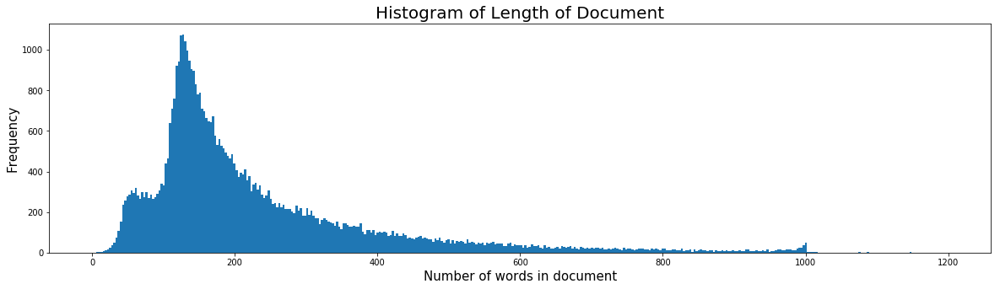

In [10]:
plt.figure(figsize=(20,5))
n, bins, patches = plt.hist(doclengths, bins=400, range=(0, 1200))
plt.title("Histogram of Length of Document", fontsize = 20)
plt.xlabel('Number of words in document', fontsize = 15)
plt.ylabel('Frequency', fontsize = 15)
plt.show()


In [11]:
print("Bin with highest frequency: ", bins[numpy.argmax(n)])

Bin with highest frequency:  126.0


In [12]:
freqdicttest = {}
for word, vocab_obj in model.wv.vocab.items():
    freqdicttest[word] = vocab_obj.count
    print(str(word) +  " " + str(vocab_obj.count))

story 35570
of 439802
a 491486
man 17593
who 65181
has 50809
unnatural 150
feelings 1160
for 133646
pig 325
starts 3768
out 51435
with 133918
opening 2850
scene 16551
that 218863
is 321729
terrific 1262
example 3770
absurd 855
comedy 10080
formal 74
orchestra 129
audience 6476
turned 2845
into 27490
an 65095
insane 759
violent 1707
mob 600
by 68234
the 1015086
crazy 1927
chantings 1
it 287723
s 197128
singers 190
unfortunately 4061
stays 493
whole 9419
time 37839
no 38561
general 2454
narrative 1189
eventually 2144
making 8735
just 53580
too 23499
off 18495
putting 1112
even 37496
those 14203
from 62411
era 1943
should 15089
be 81569
cryptic 57
dialogue 4717
would 37108
make 24517
shakespeare 571
seem 6519
easy 2506
to 407263
third 2283
grader 74
on 101871
technical 820
level 2965
better 17527
than 29730
you 103754
might 8702
think 21295
some 47825
good 44878
cinematography 2825
future 2753
great 27448
vilmos 9
zsigmond 8
stars 4804
sally 338
kirkland 25
and 494132
frederic 74
forrest 

screenplays 103
ibrahim 6
playing 4875
child 3824
understood 528
proper 623
trailer 1025
dum 61
hardly 1736
shook 61
angle 525
killing 2262
daft 101
unrealistic 747
e 2268
g 1341
handgun 34
kill 3793
city 3881
koyla 3
amrish 22
puri 88
outrageously 121
jokes 2848
jot 9
heard 3324
budget 5715
amount 1487
chance 3092
heels 165
million 1147
challiya 1
greece 116
locations 830
rubbish 831
discomfiture 1
detail 1082
justify 289
reviewing 160
alternate 299
opinion 2816
animation 2172
crud 60
alternates 35
pointless 1562
irritating 672
shell 234
sci 2167
fi 2176
slapstick 667
chore 96
kick 793
fest 453
considering 1625
excited 653
open 2090
expecting 1715
achieve 537
yaaawwnnn 1
kino 42
journey 1244
explains 567
type 3539
flop 294
worthless 349
grade 1397
pleasing 196
confidently 32
bombed 115
certainly 4468
deserved 824
honourable 34
handled 621
heavy 1433
project 1576
actual 2152
imitate 104
gadhvi 1
suffered 403
exhausting 51
audiences 1346
substances 25
tenderly 21
win 1325
hearts 386
rem

helmet 115
disney 1860
awry 129
gum 90
smacking 29
musical 2532
established 470
didi 12
conn 13
four 2800
roles 3306
british 2662
exchange 288
student 1229
pattern 178
cousin 459
likes 1409
hanging 634
rydell 40
beautician 12
hood 593
led 987
labeled 115
nerd 225
friend 4467
modern 2701
zorro 124
bicycle 86
teaches 238
ride 1439
leather 212
outfit 245
goggles 22
hide 681
pheiffer 5
cards 320
trouble 1643
bar 1112
outfitted 8
introduced 968
paths 138
dody 3
goodman 164
faculty 27
remotely 582
decided 2075
agreed 319
laughed 1083
tell 5048
pink 460
ladies 763
birds 250
former 1731
gangs 193
motor 82
cycle 188
enemy 745
gee 172
striking 450
hasn 1090
stopped 659
struck 458
lady 2263
stephanie 165
dresses 211
rebel 277
bandit 68
defeat 277
bikers 112
kicking 316
click 146
frenchy 5
graduated 79
glad 1309
bounce 86
punkette 1
arrow 161
reels 76
enterprise 272
courage 451
moxy 8
sheer 780
gall 34
predecessor 218
flames 128
jaws 385
exorcist 232
whimpers 11
amidst 151
messy 190
unfocused 67
s

barrel 215
fodder 176
teenagers 791
tips 63
scales 37
dooper 1
agent 1211
squat 20
escapes 467
located 174
afghanastan 1
rogue 153
dusky 3
heroically 16
swell 59
foop 1
fell 966
swoop 21
surplus 33
boom 252
booms 9
popeye 48
resources 260
silver 480
strike 450
miraculously 115
camouflaged 16
credibility 454
fade 196
disappear 294
lightning 192
users 177
pro 424
creativity 312
marcel 108
mandu 1
shockingly 152
dire 350
moderately 107
needlessly 88
complicated 571
bordering 47
whispering 62
salary 60
baps 3
display 647
endured 121
opinions 307
worlds 390
lousy 638
site 722
appalling 342
stink 130
marked 202
improvement 241
grand 1001
mediocrity 143
achievement 347
decline 161
hodge 52
podge 35
altered 187
conception 79
chemical 108
bizarrely 68
discover 894
conspiracies 59
weighing 16
filmic 68
toddler 54
nativity 5
performs 228
grimace 17
assedness 1
un 659
cruddy 25
castel 6
multi 424
obligatory 224
pocketing 10
chunk 89
remaining 388
elvis 299
pressley 8
sorted 22
argue 347
jaded 176


widmark 201
bancroft 29
elisha 71
cook 425
jeanne 98
cagney 670
cocoran 1
marries 222
hangman 18
noose 48
taming 13
reluctant 218
bride 488
sexist 139
erstwhile 31
saddle 28
fifties 228
horsewhips 1
whip 133
yanks 45
grab 345
spends 613
thirds 91
negotiates 9
bloodthirsty 98
squaw 14
diplomatic 41
negotiating 19
rejecting 31
seduce 146
keen 205
madison 129
unrealistically 41
fleming 120
flips 83
fiery 116
tomboy 43
root 338
tames 3
obstacles 134
irritate 46
influence 613
viewings 261
defiance 49
bullwhip 7
rhonda 43
morally 213
dubious 189
shape 481
motivated 130
greed 258
egocentric 30
victories 26
surrounding 454
despicable 193
taut 108
shuddering 10
sugar 216
cheated 264
lovely 1291
basing 34
observations 123
judgment 206
recovering 95
addict 187
terminal 116
cancer 284
victor 581
garber 14
outsourcing 17
fraud 112
stereotype 400
recite 71
secretly 264
backbone 66
watchful 15
almighty 88
organization 171
loony 82
beating 401
girlfriends 194
greedy 248
happily 467
bah 24
min 290
alto

recipe 145
bigoted 51
rooted 94
canada 486
export 26
rut 31
amused 228
lmotp 3
thinly 85
veiled 64
gimmicky 55
innocuous 42
septic 5
excels 134
zomg 1
rural 336
roflmao 3
ether 11
idiosyncrasies 34
stemmed 9
addressed 124
dichotomy 47
societies 75
represent 286
candians 1
feed 281
stereotypical 605
radical 178
feminist 214
sheila 70
mccarthy 188
programming 134
farmers 67
deathly 40
hammy 208
demanded 91
royal 399
inexperience 34
shines 436
offend 150
waving 95
resorted 27
patronizing 60
zany 135
disease 379
canadians 77
showcasing 58
outdoes 21
unwatched 11
sitcoms 129
induce 64
snl 189
cucumber 9
sandwiches 27
ramadan 3
ohhhhh 6
embody 38
inseparable 17
identifiable 45
disinterest 18
bump 112
commenter 70
mentions 227
puppets 207
helium 8
potentials 12
dodo 7
actra 1
ceeb 2
satirical 217
sketch 242
developer 53
pizazz 16
kensington 7
beachcombers 1
successes 85
clash 179
laziness 43
selection 185
religion 621
topical 61
newcomers 73
presenting 221
multicultural 20
diversity 104
refre

pickup 64
miscasting 63
phds 8
inconsistent 198
credentials 60
nitwit 16
fulfillment 69
soundbites 3
grammar 67
assignments 35
inexcusable 54
improves 69
disconcerting 53
graininess 10
outdoor 132
exhilarating 93
savior 89
incomprehensibility 9
ironside 69
diem 20
propeganda 1
totaling 6
reeking 14
crisp 212
abominable 89
werewolf 727
cinematographical 2
inconsistency 41
rostenberg 1
decidedly 164
partially 193
interpretation 434
pastor 47
religions 57
torah 8
koran 10
skeptical 131
rule 571
nothings 12
critique 172
irrelevent 6
dominican 22
roberto 87
perico 1
ripiao 1
husbands 214
republic 137
veal 4
cutlet 1
reversed 65
transition 269
via 522
dating 272
hmmmm 37
amelie 117
thailand 164
ong 19
bak 20
akira 109
layer 111
socio 50
jodedores 1
adopts 63
swearing 189
striving 59
schmidt 43
raves 33
clones 89
glitches 41
budgets 171
placating 1
distributors 87
marketplace 18
fewer 95
companies 230
preceded 84
salcedo 1
comedians 265
maka 1
gabrielle 69
kim 573
bassinger 23
morita 42
obliv

demeaning 44
surface 633
aishwarya 90
jibes 9
satish 10
kaushik 5
submissive 31
rebels 118
courageous 128
chauvinistic 23
cleans 36
shah 158
picturised 9
sonali 23
bendre 4
indigestion 9
maltin 81
inhabiting 34
immortality 78
dozed 27
sooooo 51
labor 207
milanese 5
underclass 11
neorealism 11
sica 45
fable 103
centring 3
cabbage 16
patch 115
orphanage 173
shantytown 9
milan 34
swanning 2
testing 129
tables 132
noodle 36
sublimely 29
sods 3
illustrate 119
miserables 20
fountain 50
capitalists 16
coats 36
cigars 34
deceased 226
guardian 157
dove 113
gifts 115
cigar 63
address 214
anderson 759
balked 8
duomo 1
broomsticks 20
unswerving 3
miracles 79
teller 96
nbtn 1
pathologists 1
drifted 23
sherlock 279
holmes 741
bonfire 18
improbable 173
bala 2
spotting 53
fulton 8
fraggle 8
barron 10
dors 14
subscription 13
subscribing 4
draaaaaags 1
mstie 5
fication 1
naaahhh 1
sickly 82
remarriage 4
economic 203
dates 213
conductor 86
excuses 142
addressing 88
hose 42
iturbi 54
nineteen 42
loleralac

polarized 14
heats 13
uber 93
titanium 6
insipidly 8
snappy 136
adrenaline 86
unsuccessful 99
willis 394
sizes 44
brands 8
fedex 4
audi 4
converse 38
commercialization 10
sec 28
dependable 57
recurring 127
revoked 10
hardass 4
stagebound 5
travelled 26
global 267
robots 394
smashing 97
inject 121
nanites 1
tin 118
shave 57
grater 4
culmination 37
flipping 108
somersaults 9
unnecessity 1
spray 80
detects 10
sparked 39
snoring 15
shia 45
labeouf 34
degrades 27
withing 1
acquaintance 76
ramp 24
pendulum 26
simpler 88
fulfill 128
grieco 37
hopper 272
occured 13
experiencing 176
backwords 1
impulse 61
cringed 66
rico 86
caucasian 74
painter 140
profiler 9
serie 10
coincidences 112
gove 1
dvds 211
blurbs 10
resumes 38
grimacing 11
conceit 78
catharsis 40
spice 164
greenlighted 18
zoned 11
splendid 313
dudley 139
arrogantly 17
pioneer 85
guthrie 14
boone 101
caudill 1
kentucky 90
downscaled 1
riverboat 13
puzzling 107
zeb 4
calloway 17
incidental 110
occupying 31
summers 39
hunnicutt 7
wyler 

strippers 63
guise 68
centrifugal 2
tomorrow 298
unrated 85
blessing 83
wishman 39
chesty 19
snakeeater 6
sank 56
vet 153
strap 25
shoves 30
palate 10
pins 39
solo 198
clampets 1
deliverance 112
gunfighting 10
caca 4
shity 2
eater 72
pee 114
pfft 5
lameass 1
goods 181
hillbilles 1
solider 12
palillo 16
josie 96
gagged 18
erschbamer 1
cheryl 85
cyborg 143
durians 1
bendingly 4
congenital 6
distract 148
rinsing 4
urine 28
laundry 69
arsonist 5
horshack 4
pallio 1
malcom 29
speculate 39
metric 4
boner 12
skateboard 16
teases 31
testicle 8
grapple 21
depravity 70
canceled 171
scuzziness 3
ska 4
dissy 1
bas 17
wurth 1
shouted 46
rosetta 14
tumbleweeds 7
grinding 56
depravation 1
forry 5
fared 37
mammaries 3
quease 1
dramamine 6
seasickness 7
necks 46
leprosy 6
subjects 331
input 60
uhm 17
bakery 24
waffle 19
reflections 65
unintelligent 49
slope 24
denominator 82
rove 5
mcmanus 8
respectable 209
intelligently 100
gladly 91
locking 41
wheres 16
surfers 79
earnt 3
funky 124
cineplex 13
odeon 

abetted 27
batting 20
mexicans 84
plunked 8
refried 2
knockabout 11
abbot 43
overbearingly 5
stoopid 14
rushing 85
highlighting 52
cans 59
envelopes 9
churning 83
esquire 155
buffett 2
alpo 2
brycer 2
scapes 4
silicon 11
spatula 13
boyd 95
pearly 5
trusty 36
steed 15
rancher 34
cowardly 99
yakima 14
canutt 16
schweibert 1
clu 24
gulager 23
hutchins 8
resurrect 75
grizzled 45
chip 129
excelled 38
oõtooleõs 1
diffident 11
playwright 108
pinter 13
japp 11
poirot 160
peering 23
shrubbery 3
alastair 33
sims 33
fascism 62
sympathies 56
mosley 30
allies 125
axis 32
bundled 6
absorb 57
electrolytes 1
stabilize 4
smne 1
leoni 24
schiff 10
watering 36
uninterrupted 23
enlightens 11
that´s 14
simone 72
groaning 45
haggard 49
indications 21
incredulity 15
longest 166
performace 8
typecasting 21
truely 22
pitty 2
appointments 4
chracter 3
nunn 13
momentum 154
factoids 5
algrant 1
baitz 1
overworked 41
dizzy 54
regretful 19
grubby 26
distinguished 114
unmade 5
spools 2
improbabilities 15
retreats 24

despot 5
disconnect 23
overboard 133
fathered 19
saxophone 24
instrument 103
jab 37
screwdriver 16
sonic 129
compound 62
kazoo 5
viscerally 10
earring 20
hyperbole 38
pumps 24
frantically 67
kramer 97
myth 248
blogg 1
fouled 7
rediscoveries 1
godfrey 45
trans 48
addicts 61
polyphobia 2
polyamorous 3
titillating 42
threesome 78
monogamistic 2
bleh 9
homophobia 50
priding 1
limitlessly 1
gayness 13
overlooks 12
sequential 15
polyamory 4
cutest 43
selections 38
adjusted 44
moynahan 12
unromantic 9
cavanaugh 10
lgbt 10
heterosexuals 11
freeze 152
cavanagh 16
pooch 20
nitty 14
slurping 11
iced 9
latte 9
gown 70
slurp 2
woops 2
bloomingdale 4
bridal 14
salon 41
mocha 1
zoologist 5
bachelorette 13
thon 16
objection 40
lovebirds 23
hiccups 10
queue 40
cummings 40
gordy 7
smittened 1
microphones 28
bouncer 9
sleeveless 11
satin 17
blouse 34
sibs 3
attuned 16
homo 92
sapiens 8
hotness 15
cabbie 29
horrifies 4
afflicted 41
rice 178
misinterpretations 4
sisterly 4
rivalry 115
affections 85
shies 1

rankled 7
inwatchable 2
manikin 2
eeeeh 2
mb 10
bollocks 3
inspectors 19
handguns 24
holsters 4
bulgarian 34
wobbly 39
dislikably 1
elitist 46
contractor 33
penniless 46
bulgaria 34
outperforms 4
lena 120
headey 9
inebriationit 1
contracter 4
ops 44
circulation 44
assination 3
colleague 163
apprehend 17
connivance 4
coppers 14
inconsequental 2
vauxhall 2
belmont 10
assignation 11
subaru 8
imprezza 2
toting 56
heathrow 5
posher 2
rigid 103
untried 4
unconsidered 3
greengrass 27
propagate 10
greengass 2
swipes 19
enhancement 26
unprofessional 64
ultimatum 66
inanely 9
crackling 30
yankee 87
tranquility 18
apprehended 20
windsor 62
befriends 198
unwitting 38
clearing 33
escapade 28
dawg 13
detonator 13
cheque 15
operative 66
dons 33
breeds 17
supervising 14
assignment 146
allied 98
courtrooms 8
liaison 38
routinely 50
enforcement 113
disjointing 3
encumbered 5
devolves 17
stroboscopic 6
confusingly 18
afield 11
formulated 26
mimic 117
ísnt 1
wept 23
urinates 8
commune 45
boatwoman 1
makav

grumpy 91
snatches 23
pathologize 1
bdsm 21
uncomprehension 1
programmatical 1
psicoanalitical 1
irc 4
chatrooms 2
pianiste 5
flicker 39
masochism 35
attributes 96
musically 44
athletically 2
competitive 78
relearn 4
gulled 1
salacious 40
jour 20
elfriede 1
jelinek 1
prizes 51
dinosaur 277
debased 10
gobble 14
orthographic 1
receipts 15
interrupt 35
kohut 2
accoladed 1
stony 17
husky 18
mum 188
institutionalised 6
hither 8
thither 3
handbags 3
gravelly 14
maman 19
profuse 6
apologies 72
leitmotif 13
elrika 2
alternating 54
voltage 26
hockey 179
pianist 171
cherchez 1
characterised 17
hostility 49
discouragement 2
hanky 18
panky 7
lovesick 9
swain 51
chillingly 34
shits 6
genital 11
rink 19
trousers 45
expelled 28
desirous 4
brute 101
renewing 6
declarations 6
expatiate 1
parentally 1
longs 60
ineffectively 6
stunted 24
soiling 1
lacerated 1
packs 164
mstking 1
jasonx 1
ftth 1
degenerated 26
prejudiced 38
maher 33
denom 1
objectivist 1
clergyman 11
professors 49
doctorates 1
verbal 161


beheads 6
goatee 20
oghris 1
brooker 2
vanquishing 2
gloating 5
smearing 9
paraded 27
builder 31
tolerating 6
barabarian 1
debauchery 26
machismo 43
woosh 2
barbarians 38
clothed 60
mongoloids 2
mexicanos 1
arriba 1
trompettos 1
warthog 9
gamorrean 1
ravish 5
deduct 9
pallette 9
deb 16
carson 131
ditzy 36
rump 5
cactus 20
manges 2
laughless 8
claudette 84
colbert 205
oozes 65
petulance 7
davenport 51
frawley 19
tarot 28
ritualistic 14
decapitating 11
ritualized 5
marky 19
mutes 8
inspite 13
darken 8
beforehaving 1
camra 3
tygres 1
folded 26
especialy 8
unfourtunatly 1
smut 52
demonicus 23
schya 1
feds 45
homicides 14
consults 7
samedi 4
esqe 10
stadium 106
voudon 1
loa 3
traditionally 55
oppressors 28
loki 1
trickster 11
voudoun 1
tay 12
igave 1
starkly 24
unimaginativestory 1
ifyou 2
willreally 1
baldand 1
ajampacked 1
whacks 17
andnobody 1
wasfilmed 1
hadknowledge 1
compositionactually 1
hearthe 1
laughwhen 1
vicitm 1
pumpkin 40
detatched 1
anda 3
hollar 2
louisiana 80
sabine 28
civl

romasanta 55
bun 5
creatively 64
buyer 25
lindenmuth 3
hereditary 6
shapeshifters 2
shapeshifter 24
envisioned 37
lindemuth 1
manbeast 1
websites 46
toth 34
slippery 26
alliances 22
asserted 13
chipe 1
interplay 109
contrasting 80
outskirts 22
capped 38
dehner 12
millican 2
whew 44
lavishing 4
downplay 16
ewwww 7
lucius 8
exuberant 51
cumulative 13
merging 27
nauseated 20
bisexual 73
sisterhood 9
mythologies 10
salvific 1
beaming 21
toothy 7
mammies 1
choirs 6
childlike 62
sensualists 1
muscals 1
halleluha 1
caricaturing 3
vaguest 8
brutalised 2
oppression 72
spousal 13
fulfilling 116
dominant 83
lesbianism 74
emphatic 19
ni 25
glorifying 31
ulster 5
nationalists 13
loyalist 20
intransigence 1
partition 50
irrespective 21
loyalists 12
demoralise 1
belfast 21
ahistorical 3
cheri 17
listeners 19
lewinski 2
karyn 13
bel 53
haters 59
impairs 2
thieson 2
gymkata 20
pleasuring 9
pleading 45
roxbury 5
coneheads 38
subtitling 13
parnell 13
libs 19
reviving 32
exploitationer 4
souvenir 12
deoda

techie 3
foiled 16
trainor 9
zemeckis 64
deviously 10
recycles 20
wised 2
qualitatively 2
martian 83
smallville 95
infliction 2
backflashes 2
varney 51
capote 70
nonfiction 13
underscore 24
starkness 10
imprisonment 39
ambivalence 20
hickock 40
rankings 10
enrage 13
holcomb 6
edgerton 13
belongings 27
ormondroyd 2
modernized 25
rickety 23
divvies 1
transsexuals 12
thunderous 16
distinctly 123
rahs 1
mirroring 28
weir 100
lisping 13
dickinson 84
delicates 1
tackiest 3
acme 19
scatological 24
handbook 20
gunpoint 53
perverting 3
insomniacs 18
lockjaw 2
anincoherrent 1
withissues 1
andthe 1
thepast 1
chevy 145
allabout 1
veryraunchy 1
doyourself 1
farsuperior 1
acutely 19
bettered 19
waaaaaaaaay 1
hitchiker 2
uranus 6
mayfield 16
songtotal 1
movieeverything 1
shapiro 20
mainline 5
approxiately 1
beetles 16
unclever 5
cleverless 1
craparama 1
nyu 18
cincy 1
carr 52
donned 15
clifton 30
bleepesque 1
trickle 10
monaghan 23
penciled 2
deanna 79
troi 9
pronouncement 5
elbowing 2
reminders 36
o

pinochet 9
qaida 7
sanctions 10
ciountrie 1
windingly 1
wackyest 1
buenos 39
aires 39
peronism 1
dearest 58
americanism 14
hurriedly 16
spectacles 24
translators 7
translator 35
microbes 5
attilla 2
hun 17
preliterate 3
hellenic 3
tablecloths 2
canuck 3
cleansed 8
supplier 13
vigalondo 7
showman 26
kodak 9
pungent 18
oder 5
stroptomycin 2
fermenting 5
byproduct 11
troublemakers 9
rec 15
socials 3
chaparones 2
babu 17
riba 4
foursome 25
lemma 2
psh 2
sufferance 4
misstepped 1
hawke 152
indecisiveness 7
perpetually 73
berating 9
constipation 13
insured 11
alternatives 34
castrated 17
singleton 57
boyz 46
seafood 8
preyed 8
roomed 2
busta 14
colleges 34
malik 52
conner 39
remy 24
writ 15
institutions 45
tupac 38
shakur 23
shea 42
rappaport 18
inequality 16
instigating 4
skinhead 25
sternness 4
pinetrees 2
appaerantly 2
forrests 4
russells 5
andersons 8
detonating 8
shanks 44
teal 28
jaffa 14
aaaarrgh 2
crystals 28
ideologies 37
screed 7
structuralist 4
tendentious 4
reappropriated 1
strid

clichéreason 1
deployment 12
hoffa 5
cronkite 3
revising 3
spontaneity 29
yehweh 1
niagara 11
prayers 33
wittiness 12
imbd 6
stuttering 60
petite 35
quits 52
bantam 4
fab 38
stingers 3
reprehensibly 3
refractive 1
hq 26
manchu 51
ely 17
bama 3
eldon 1
hensley 9
ardala 4
valmar 1
calkins 1
tuska 1
wexler 14
sling 82
ire 22
sousa 7
evildoers 6
cliffhanging 4
fedora 29
bronzed 6
ubermensch 1
kryptonite 22
exuding 12
seas 69
robyn 5
drawbacks 45
biplane 6
rumours 35
underlings 27
bobbing 26
skyscrapers 13
curtains 70
moulded 11
koenekamp 7
sprang 12
zeus 33
tmob 1
autographed 12
flacks 6
intercepted 12
reprints 2
comicon 2
blackhawk 4
sidenotes 3
archenemy 4
diego 111
dorkknobs 1
portfolios 6
sommerset 6
maugham 73
contempory 1
anycase 2
maughm 1
popularist 3
storyteling 1
redd 9
schlatter 10
pimpy 3
waylon 6
bobrick 2
wristed 8
woe 30
dugan 20
wayland 8
gft 34
illeana 8
ninotchka 15
comedown 6
plainclothes 3
blondell 128
tashed 1
brophy 18
furlough 9
macbride 13
conlin 5
alberni 4
willock

gynaecological 1
psychodramas 3
discomfiting 5
masts 2
flayed 4
poignantly 41
richest 30
dantes 11
composing 28
infernos 3
pedantry 3
shambolic 9
groucho 77
opportunism 15
railway 60
livelier 11
paralysing 1
tz 9
stoical 3
schenck 2
pressured 34
dardis 1
smiler 3
grogan 15
incompatible 16
stealer 48
commendably 13
postmark 1
manservant 20
jostle 6
intermesh 1
eggheads 5
intellectualises 1
hepcats 1
kale 27
excitable 12
bankrolled 4
armetta 3
bankrolling 3
pursestrings 1
servers 4
mormonism 5
reenacting 10
naturedly 2
sloooow 3
rugs 8
howzbout 1
plural 15
polygamy 18
tarred 4
feathered 24
hyrum 5
carthage 3
nauvoo 4
doorways 16
expositor 1
baseless 13
bushman 12
binder 52
seer 11
masonic 5
newbold 1
methodist 7
stapled 8
shelving 2
yuma 36
fangled 13
hoariest 3
prickly 16
spermikins 1
miscarriage 34
insemination 4
pillow 57
petticoat 11
zoomed 13
millimeter 10
klieg 2
starched 6
wove 12
shootist 6
obituary 6
botch 19
complacency 15
genre’s 1
outwits 6
hershey’s 2
greenhorn 9
fordian 1
h

dinosuars 3
ariauna 6
tempe 6
nough 1
roadrunners 1
parasitic 23
worshipped 13
uncertainty 65
leech 18
archetypal 53
clinkers 7
morocco 26
mona 84
juggernaut 18
sartorius 1
propositioned 3
hypo 6
hunched 5
lacanian 6
lacanians 2
lacan 11
hegel 3
expounds 5
superego 7
zeppo 9
sinthome 1
attributing 4
jouissance 7
isabella 70
rossilini 1
maclachalan 1
articulated 11
dogmatists 1
botega 1
psychoanalyst 23
universalised 1
rationalised 2
leninist 2
unphilosophical 1
consumerist 8
readymade 1
branching 7
mayberry 18
breakneck 25
schnook 5
capitalizes 10
spiritless 6
neilsen 19
kazuo 9
komizu 7
seemly 18
climaxing 13
docile 29
entrenches 1
subjectively 8
vanload 2
slay 31
masturbates 23
snapshotters 1
molest 8
schlonged 1
mangles 5
panty 9
fogged 5
gaira 3
tailermy 1
penetrator 1
prototypical 16
smidgen 20
croûtons 1
entrailing 1
gawked 2
mediums 27
compromising 36
uks 1
charleson 3
celluloidal 1
insincerity 3
bolstered 15
emanuelle 25
macao 6
peopled 20
rassimov 2
shubert 2
stracultr 1
gemse

foundationally 2
chiaroscuro 8
immersive 14
agnès 1
merlet 1
petto 7
toymaker 4
sprouts 6
landlord 81
evicting 4
larvae 7
kenitalia 1
whee 2
yuzna 88
leftovers 22
neith 1
kitrosser 1
stepdad 4
ensnare 12
higginson 2
fraim 2
drinker 18
gecko 4
laughlin 33
unratable 1
geico 14
prefect 6
peeew 1
unfrozen 3
fuhgeddaboudit 1
milligans 1
completeist 1
schedual 2
aflac 1
nominates 3
chortle 4
jiving 4
speculated 10
slapi 1
shortlived 1
compellingly 33
varhola 1
skirmisher 1
dieter 15
bohlen 7
parvenu 2
megaeuros 1
deutschland 4
sucht 1
abbreviated 16
dsds 2
naddel 1
verona 7
bild 1
rtl 4
wetten 1
dass 4
squirt 11
womenfolk 7
splutter 4
dramatisation 23
accorded 12
nous 7
simplify 11
contessa 3
guiccioli 1
ravenna 2
pisa 5
gravitational 8
childe 1
missolonghi 1
gambas 1
attachments 20
royale 69
americanime 2
dreadlocks 11
imaginings 14
icegun 1
jlu 5
remarking 16
gasses 3
pfeh 1
cluemaster 1
thunk 10
fastardization 1
timm 11
dini 10
tonalities 10
corpulence 2
blanka 1
reggae 13
batarang 1
batb

manana 2
neg 1
cutters 5
morrisey 14
tramell 13
darkman 40
soften 30
westlake 7
squint 12
roxann 2
elanna 5
dodges 16
telletubbes 1
dolf 8
washburn 12
sorenson 2
pedtrchenko 1
mails 15
waxork 1
milennium 1
codependence 1
deepens 16
noirest 1
excerpts 41
solicitor 26
hedonic 1
crossers 2
eek 5
heisei 6
bonafide 11
godzillasaurus 1
seens 4
nudges 8
tristar 4
ghidorah 12
behemoths 3
rogen 19
shoah 4
cannibalizing 6
annexed 2
baldness 5
saucer 38
nippon 2
nucyaler 1
erred 2
ductwork 1
liability 26
chintz 1
nonfunctioning 1
fukuoka 1
metalflake 1
hydra 3
jumpstart 7
shipwreck 32
revamped 17
pities 5
ghidora 2
joystick 3
masonry 2
megumi 6
odaka 2
micki 2
colossus 91
copulation 12
stying 1
upholds 5
skivvies 6
georgy 2
subhumans 3
unchallenged 13
finis 2
stratagem 3
scotched 1
chatham 1
eulilah 1
tatum 58
ewashen 1
fossil 11
ashleigh 4
dassin 12
konchalovsky 8
vivaldi 3
hoffer 2
rififi 4
topkapi 8
risa 4
goto 10
kohara 2
osamu 5
exsist 1
fussy 27
caugh 1
caputured 2
definitly 6
newspeople 1


doppelgangers 5
peeking 15
enhancing 29
sunrising 1
tensity 3
mcvey 2
ø 1
intermediate 5
cashback 2
distilled 10
unconventionally 9
headley 4
louche 11
crawly 5
doppelgang 1
suderland 1
somesuch 5
dotted 14
serling 96
neve 73
paras 2
twirls 2
corncob 2
cushy 5
pubertal 2
assessments 6
ange 8
democide 2
egalitarian 8
bamboozles 2
pleb 1
panegyric 2
soi 7
disant 2
amis 11
readable 13
solimeno 1
vaunted 5
druggy 4
oeuvres 5
irvine 13
bettany 63
cobs 1
frankenfish 4
hussy 10
smackdown 27
withnail 11
apidistra 1
plater 3
prate 1
aspidistra 1
emphasises 14
comstock 8
shafts 11
lambeth 2
urchins 5
bonhomie 2
clunking 8
richness 52
horlicks 1
torpedo 20
dde 2
crewed 5
excessiveness 7
uss 20
accomplishments 49
specs 13
everts 1
whiners 7
commence 14
hartford 5
constrictions 3
gravedigger 16
reprobate 4
gravediggers 2
grandsons 7
discontent 21
kidulthood 3
kes 7
haine 6
dibb 1
overhauled 3
estabrook 1
trainables 2
zenith 23
thuggish 24
silos 8
newell 8
analyst 26
pipedream 1
proliferation 15
col

nikelodean 1
rade 8
serbedzija 5
wonman 1
organizer 16
druing 1
andalusian 5
begotten 7
multinational 15
woodmobile 1
headroom 3
twizzlers 1
flakiest 1
barres 12
jeckyll 2
bordeaux 3
viagra 9
kinki 4
viciado 1
embarrassly 1
scenethere 1
dispenser 1
monotonously 11
ordell 1
derrida 64
crimminy 1
wipers 3
feasibly 3
documental 2
oldish 2
restrictive 20
directivo 1
invesment 1
corder 4
segways 3
natashia 1
begly 1
recordfirst 1
cksecondly 1
brutsman 1
nymphomaniacs 9
indignantly 8
indiscretions 16
ravishment 4
thrusting 17
compulsiveness 4
restaurateur 10
inborn 1
defect 28
convincedness 1
einon 3
draco 18
postlethwaite 7
glockenspur 1
felton 8
aislinn 1
gens 6
couleur 6
sunjata 2
peacocks 5
gardeners 2
expenses 37
psychotherapy 7
bulow 2
peggey 1
ooooh 17
msting 2
gumby 8
underated 6
conpiricy 1
atmosphoere 1
conway 119
unbeknown 12
nichol 7
talker 12
gutsy 41
freeeeee 1
coooofffffffiiiiinnnnn 1
yaaa 1
aaawwwwnnn 1
projector 50
unfurnished 3
admonishing 6
transgressions 14
belowthe 1
woo

supersoftie 1
maximal 2
supervillains 3
superaction 1
superfun 1
supersadlysoftie 1
superlame 3
wroting 1
kidder 28
ironman 1
wrecker 3
maury 86
povich 25
razing 3
waddle 3
avg 12
superpeople 1
maneur 1
supermoral 1
superpowerman 1
supermortalman 1
elated 8
sneezes 1
ineresting 1
damages 21
superbrains 1
lunges 6
premeditation 6
kyrptonite 1
averted 11
poupon 1
conman 14
tesmacher 1
cyclops 27
scorecard 5
puttered 1
corporatism 2
latently 3
hoist 4
jor 5
dunce 7
zam 1
whap 1
attains 13
pore 15
dreamscapes 10
auspiciously 4
pickman 1
boomslang 3
afrikaans 3
sm 16
credo 9
fetishist 8
eion 2
cog 10
homeward 28
opportunites 2
circumspection 1
nightshift 2
overstay 11
averaged 5
synopsizing 1
battleground 8
tot 21
umney 4
chandleresque 2
usurping 4
miserabley 2
farnel 1
rwandese 1
lanuitrwandaise 1
rwanda 48
tutsi 4
rawandan 2
furls 1
rawanda 3
immanent 1
sondergaard 15
elk 13
purification 4
sioux 24
imposters 2
encroached 1
trainees 7
thhe 10
aja 19
radiated 6
reservist 3
mountainbillies 1

toklas 8
octogenarian 10
prospered 4
snubbed 14
vestigial 2
deadhead 2
massochist 1
matchstick 4
clubgoer 1
walpurgis 10
morsheba 1
xiv 7
xi 25
armourae 8
bankcrupcy 1
suncoast 5
englishwoman 7
burtis 1
eleanore 1
rogell 2
orwelll 1
expressionistic 31
communistic 2
ninteen 1
shallower 4
siemens 2
organics 2
adopter 1
eurythmics 1
ingsoc 2
winstons 3
goldstien 2
unpersons 1
hearsay 9
bandied 6
eurasia 2
jointed 2
proletarions 1
facism 1
newspeak 1
syria 10
illogicalities 2
supervise 6
jax 9
antagonizing 5
housework 11
dinsey 1
appellate 1
beter 1
coolish 1
paled 8
fic 2
wrinkler 1
retell 13
gooodie 1
coordinates 7
permutations 9
indefinable 6
architects 7
barbarash 2
zachary 24
dodd 30
huband 1
felons 15
functioned 10
hermetic 1
elucubrate 1
sempre 3
parton 11
magnolias 12
featureless 9
adriensen 1
sno 2
britcoms 4
mccaffrey 4
authorisation 1
fonz 13
hervé 1
villechaize 2
sining 2
cyclorama 1
cycs 1
abner 40
couorse 1
jordi 7
mollà 3
leonor 18
watling 10
valencia 3
ulises 24
martina 9
b

excpet 1
persepctive 1
reviewied 1
vela 4
rda 4
boltay 1
kravitz 1
termite 14
theodor 4
percolating 4
pulverized 5
quarantined 13
itis 4
snafus 4
cellphones 9
demoralize 1
koolhoven 3
honoust 2
grot 9
gouden 2
ei 5
egon 20
wagter 2
huêt 2
benja 1
bruijning 1
hensema 2
graaf 2
laggan 1
devdas 20
fedar 1
festooned 1
frontbenchers 1
quentessential 1
gapers 1
dishum 2
leonine 3
narasimhan 1
gawkers 1
aishu 2
idia 1
elase 1
zubeidaa 3
karima 1
vamsi 2
nandini 16
tiku 1
talsania 1
jaspal 3
bhatti 3
gidwani 1
reachindia 1
havel 1
nandani 1
harrowed 1
ismail 11
darbar 5
kameena 2
versatility 59
fratricidal 2
begetting 2
extents 8
dipti 1
nanadini 1
vamshi 1
impulsiveness 3
outbreaks 2
tigress 3
sensitises 2
miley 4
damroo 1
bhaje 1
pukara 1
warlords 18
gaity 1
dispensed 13
choses 3
ritu 1
shivpuri 6
rajshree 2
solanki 1
wamsi 1
unevenness 9
ostentation 1
versailles 33
megalomania 7
boppers 8
daltrey 9
entwistle 3
aving 3
crowed 5
tassel 2
martins 35
overture 7
pcm 1
bisaya 1
nipongo 1
mmff 1
l

pissy 4
salvatore 5
lando 18
calrissian 3
friendlier 7
stealin 1
unscheduled 4
reassures 14
lundquist 2
skewering 15
visser 1
blowjob 2
solicits 5
dishwasher 8
pedestrians 19
jobcons 1
ruinously 3
ratzo 3
viccaro 1
schlesinger 32
sordidness 4
compunction 4
unremitting 15
intensification 2
erosion 7
garbed 8
partnering 5
tatters 5
holender 1
thielemans 1
cowpoke 7
forge 21
schlessinger 3
migrates 2
georgeann 1
fatso 5
hankies 9
voigt 4
guiltily 3
lennie 53
steinbeck 53
grittily 3
unheated 1
recognizably 14
candide 10
hustled 3
wormy 5
peculiarities 15
deviances 2
lonelier 3
mcgiver 3
balaban 14
delineated 11
rancor 5
cosmopolitans 2
snifflin 1
spurn 2
impelled 4
westside 3
scums 2
migrate 7
uninhabited 8
herilhy 1
upends 2
immerses 12
glimmering 1
blowsy 5
barnard 16
tutti 11
fruttis 1
bernhards 2
resituation 1
authorizing 3
odysseys 2
giggolo 1
suppresses 4
virile 29
jb 15
cordial 9
cyclonic 3
amorality 13
schelsinger 1
alonzo 122
bodden 1
funhouses 1
burketsville 1
cassevetes 6
caseve

sidetracking 1
frictions 4
lightheartedly 2
dote 2
wilkie 7
dialectics 3
oppositions 2
abolished 14
concretely 2
chiastic 2
schema 3
legitimated 2
alexanderplatz 3
mieze 1
exert 10
assuredness 8
prunella 3
blabbermouth 2
formalities 6
gyneth 5
birtwhistle 1
spectular 1
interwhined 1
ruts 6
ambience 11
schiffer 3
emmas 1
beckingsale 1
snobbishness 5
girlishness 1
caalling 1
austeniana 1
teazle 1
merriest 1
carrollian 1
beckinsale´s 1
character´s 1
kake 1
irreproachable 2
emmily 1
byington 11
haydon 3
milly 2
remi 14
herge 12
rackham 1
outgrowing 2
colorist 1
numa 1
sadoul 2
cassettes 6
rightist 1
hergé 8
reconstructions 11
trampa 8
alucarda 6
mejia 3
trespassing 16
alejandra 3
charly 9
tono 6
mauri 3
mauricio 5
marisol 2
santacruz 1
plascencia 3
tsh 3
abba 7
watertight 2
unofficially 6
pistoleers 1
victoriously 4
uttermost 1
competitiveness 7
filo 1
caballo 1
armoury 4
gallindo 2
kruegar 3
majorettes 3
simpley 1
trueba 4
wans 1
portraited 4
beggining 2
ferula 3
brownish 5
whetted 4
prot

sacking 5
operish 3
caucasions 1
madding 4
coals 6
sexualin 1
couldrelate 1
actiona 1
fortyish 2
baldry 1
spinsterhood 2
dejectedly 5
excoriates 2
warmest 8
amnesic 3
recrudescence 1
mélanie 1
thierry 21
radivoje 1
bukvic 1
extremal 1
twined 1
bandes 1
dessinées 1
laserdiscs 4
matuschek 23
unfussy 3
boatloads 4
postpone 7
kralik 17
blustery 11
quaintness 2
recaptures 7
carlucci 1
avanti 1
schildkraut 42
balta 1
unwinds 7
ferencz 1
vadas 5
novodny 1
pirovitch 5
pepi 7
katona 4
katchuck 1
destry 14
subtlties 1
bressart 14
brusque 11
popkin 2
brusqueness 4
stewert 2
perovitch 1
darndest 2
leland 5
heyward 2
kanoodling 2
renault 2
lazslo 2
nostalgics 3
lubitsch 1
locus 3
transient 9
unvented 1
toadying 7
meted 10
halton 4
colcord 1
recognisably 3
specialness 5
zabar 1
stewarts 5
rejuvenate 7
nudists 6
commutes 4
feld 7
lanoire 1
masayuki 5
suo 7
shiko 2
funjatta 2
naoto 2
takenaka 3
sugiyama 14
enrolled 17
dansu 5
salaryman 3
swd 5
champaign 3
masauki 1
theactors 1
kusakari 3
tamiyo 3
yak

kawai 7
complementing 12
cinematek 1
tachigui 3
retsudendirector 1
toshio 4
hyodo 1
katsuya 2
terada 4
koichi 11
yamadera 3
consolidate 2
trendsetter 1
shinya 11
tsukamoto 33
yomiuri 1
ghibli 29
bebop 61
soba 1
ramen 1
gyudon 1
trays 5
defers 1
yoshinoya 1
andrez 1
elways 1
juts 2
polack 2
gulagher 1
mcgoohan 21
salmi 8
sanka 2
spierlberg 1
frankin 2
standalone 21
notability 1
familiarness 1
enthuses 1
facilitates 6
unfavourably 4
feriss 1
settee 6
spieberg 1
necessitated 7
bocho 3
capitulates 2
superstardom 11
outgrew 4
macca 2
scouse 4
adien 1
performaces 1
genreor 1
backbeat 9
pleasent 1
catcher 27
seperated 4
offhanded 1
beatlemaniac 1
stanfield 9
saccharin 5
chrecter 1
jumpedtheshark 1
scrappys 1
scoobys 1
intriguded 1
yabba 2
yiiii 1
vachtangi 1
kote 1
daoshvili 1
germogel 1
ipolite 1
xvichia 1
sergo 1
zakariadze 1
sofiko 1
chiaureli 1
verikoan 1
djafaridze 1
sesilia 1
takaishvili 1
abashidze 1
evgeni 1
leonov 3
danelia 14
georgi 2
goryuy 3
tillier 1
oncle 2
manette 2
grusiya 2
g

cornily 1
sakez 1
abolitionism 1
unrushed 3
traumatise 1
shrines 3
republica 2
dominicana 1
bernal 13
bracho 2
suares 1
thinkfilm 3
keital 1
clucking 3
iben 12
hjejle 11
overracting 1
satelite 4
mistrustful 2
reproach 8
shamanism 2
zaitochi 1
ichii 2
yomada 1
shintaro 15
daisuke 11
heiki 1
gojo 3
shinto 2
nixflix 6
boddhist 1
leeched 1
chambara 10
benkai 1
musashibo 1
mahayana 2
makoto 8
watanbe 1
actingwise 2
traditionalism 2
adventurously 1
yoshitsune 10
retainer 4
mappo 1
heian 1
fuji 7
taira 3
heike 21
minamoto 3
karuma 1
shingon 1
tetsukichi 1
scavenging 9
pone 2
texel 1
wantabee 1
corrigan 22
kinsella 7
tatooed 1
unadorned 9
travelogues 2
bosh 1
reisman 1
serra 18
patrizio 1
flosi 1
ferilli 1
montorsi 1
transunto 1
sforza 1
boswell 10
ogres 3
sheirk 1
demoni 3
orco 6
charel 5
trifiri 2
advices 6
maturing 20
stanywck 1
smalltown 6
intrigiung 1
preordains 1
incridible 1
softfordigging 1
manoven 2
projcect 1
zippier 1
impertubable 1
pomeranian 5
taster 3
aweigh 37
luckier 6
fantasyl

deverell 1
gregson 17
sandt 1
wadd 4
diggler 2
kilmore 1
plopped 4
apon 3
prosthesis 1
amplifying 2
loath 13
strutts 1
exhude 1
blackfoot 2
slayings 6
conspirator 11
mcdemorant 1
personia 1
salton 3
splenda 1
excellance 2
berlingske 1
tidende 1
mamoulian 22
braided 4
daumier 2
cavils 2
doorpost 2
berr 1
fewest 5
meowed 1
omigosh 2
mapother 1
fidget 2
talkd 1
whathaveyous 1
nonlinear 5
susco 1
linearity 10
unreasoning 3
hertzfeldt 3
lummox 2
buzzes 3
harrowingly 5
crevices 5
hwl 1
respiratory 1
disseminating 2
sequiters 4
harped 3
dumland 1
davidlynch 2
hulce 21
dominick 45
ebbs 4
geno 7
forfeit 8
pharmacology 1
studder 1
eratic 1
belieavablitly 1
trudges 6
unaccounted 5
peary 5
goodhearted 4
macleans 3
cinematopghaphy 1
trashman 1
interessant 1
quebeker 1
jostling 6
concoctions 10
psycopaths 1
podunk 7
deputize 1
cyphers 9
carbone 3
cronjager 2
deputized 1
coos 5
peeters 1
gov 21
screenlay 1
heartpounding 3
fising 1
neighborrhood 1
frazer 5
rousch 1
sandbag 1
revoew 1
abolish 5
disaste

frenchie 2
xv 26
cavalcades 1
megalomanous 1
definitley 4
someome 1
deana 4
hurtful 12
throve 2
voltaire 9
antimilitarism 1
mourir 1
rauol 1
dryfus 1
delany 10
dragooned 1
paradorian 3
stroessner 1
mazurszky 1
parador 15
homogeneous 4
stockinged 2
cosmetically 2
demurely 1
peron 4
untrumpeted 1
sot 7
alfonse 2
strausmann 2
tkotsw 1
beguine 3
pyche 1
meatlocker 1
cowman 1
concurrent 10
tuscosa 1
beautifull 3
hearp 1
obligates 1
inaugurated 2
posteriorly 4
¨big 1
gun¨ 1
unearp 1
doan 1
macadam 1
honorably 7
argonautica 1
acquisition 20
antiquity 7
vulgate 1
correlative 1
specters 9
conflation 4
underlie 2
redirect 5
fatalistically 1
patrolled 5
encw 1
decaf 2
flippens 1
progrmmer 1
dureyea 1
boyscout 2
gunrunner 3
robers 2
heists 15
durya 1
mcnalley 1
mustached 9
jutting 2
clearcut 1
visualising 2
persistance 2
weoponry 1
wholeness 3
defraud 3
circularity 3
tangibly 2
stagecoaches 4
intensities 2
brothera 2
unkwown 1
ctu 15
surnow 2
napping 5
tock 12
rovner 1
kuala 3
lumpur 3
haige 1
na

piggys 1
whitmire 1
disbanding 3
rejections 5
hibernate 1
liosa 1
beckett 39
mankinds 1
madnes 1
appologise 1
hathcock 3
hathcocks 1
unconfirmed 4
sidious 4
calomari 1
sullesteian 1
endor 21
cpl 8
upham 1
aggresive 1
enterntainment 1
llosa 12
movive 1
beccket 4
actuall 2
selve 2
windu 8
jedis 5
younglings 1
flawing 1
riflescope 1
gunny 3
vietcong 19
backett 1
medalist 2
alveraze 2
miraglittoa 1
ochoa 7
spotter 1
papich 2
aden 10
eward 1
neurosurgeon 3
souler 3
stabler 1
losvu 1
janel 7
moloney 4
thea 14
militarist 4
inmho 1
âme 2
bejard 1
deshimaru 1
herder 5
eatery 17
eroding 5
trounce 4
cobblestoned 1
mcphillips 1
mclaglin 1
jihadists 4
ocars 1
seiner 1
gypo 71
mcphillip 12
gwtw 15
mcdiarmid 7
briish 1
gyro 3
kaite 1
informers 10
ruffian 6
birnam 1
levelled 6
foggier 1
spasms 7
lout 17
carfare 1
shnooks 1
dribbles 6
tablecloth 6
hing 2
bedder 1
wader 1
tels 2
cashiered 1
fiernan 1
farthing 1
brogues 1
sinn 2
fein 4
irishmen 3
nanak 1
viren 3
sahay 3
aryaman 1
chawala 1
khakkee 1
chew

brawlin 1
outlasting 1
outliving 2
fleischers 14
brooms 3
seeding 3
undoubetly 1
sanufu 2
sandell 4
tuareg 1
tuaregs 1
wunderbar 1
doctoring 9
slavers 3
procure 9
flavia 63
gelded 1
islamist 2
bolkin 2
casares 3
underclothing 1
agathaclosing 1
gaetani 1
otranto 3
monaca 1
muslmana 1
hexploitation 2
misdemeanor 1
falvia 1
mingozzi 3
skinnings 1
spikings 1
sevizia 1
paperino 1
convents 4
nunsploit 3
feministic 2
hastening 1
rupture 6
casarès 1
childbearing 1
tarantulas 31
reportedy 1
complicitor 1
corlan 1
katee 2
calicos 2
loerrta 1
spang 4
cassiopea 1
swartz 1
stauffer 3
sparce 2
bonaire 1
ragging 1
rackets 13
reformatory 9
cuttingly 1
fotp 1
popculture 2
bedpost 4
ericka 1
crispen 1
ayatollahs 2
bahrain 15
supurrrrb 1
marginalization 2
sima 1
mobarak 1
shahi 1
shayesteh 2
ayda 1
sadeqi 1
golnaz 1
farmani 1
mahnaz 1
zabihi 1
panahi 42
offside 31
similalry 1
mandartory 1
corralled 3
kheir 2
abadi 2
freeform 2
shadmehr 1
rastin 1
truffault 3
subordination 2
egality 1
ruing 1
pvr 3
lavvie

grouchytown 1
patankin 1
grouches 2
anthor 1
handiness 1
victimising 1
hobbes 14
natasa 2
ninkovic 2
yahwf 1
holidaymakers 4
mothish 1
locomotion 6
croasian 1
uninhabitable 2
plitvitce 1
krka 1
placated 2
ember 60
herzogovina 1
scummier 1
bosniaks 5
redelivery 1
garned 1
newsclips 1
personna 5
unresolvable 1
inveigle 3
fainthearted 3
degredation 2
cryed 1
hapsbugh 1
let`s 4
don`t 29
hvo 1
joshua`s 1
massacared 1
i`d 10
wouldn`t 11
can`t 15
platoonesque 1
ubisoft 2
immersiveness 1
yuri 15
lowenthal 1
kalina 2
sissified 1
inf 1
seris 1
ledges 4
polygons 4
mechner 1
spamming 5
daggertail 1
playability 6
platforming 1
macfarlane 15
otar 2
iosseliani 7
plancher 1
vaches 1
misinterpret 7
emlyn 9
konstam 1
lydecker 3
aesthetes 2
timepiece 3
cannibalising 2
bordertown 1
bern 6
waken 1
chiming 4
ripest 3
cuttings 5
fusses 4
pretorius 1
homini 2
eyssen 3
doood 1
fairty 1
japanimation 4
ooohs 2
aaahs 2
tengiz 1
abuladze 1
monanieba 1
hallman 2
waaaaaaayyyyyyyyy 1
toooooooo 1
clicheyed 1
homaging 

schuyler 6
loise 1
bourget 1
otterbourne 7
debellefort 1
rota 7
ottobourne 1
houssey 1
gord 1
chrisitie 1
chrsitie 2
wends 1
ramses 9
simbel 2
slueth 1
sloving 1
schyler 1
bellifort 1
dendara 1
philae 1
aswan 1
nefetari 1
motoe 2
mooned 3
servantry 1
myestries 1
overlength 3
significanlty 1
colonal 1
guillerman 2
mccorkindale 1
vaht 1
dunit 1
allertons 1
dipsy 1
synchophantic 1
holidaying 3
lyddie 3
chiu 3
underpowered 6
hehhehehee 1
brainier 1
sergant 1
velcro 1
dishrag 2
pasties 8
raport 1
mardukas 17
moscone 3
pantilano 1
dorfler 3
brest 12
kopek 1
bondsman 6
crudities 3
encumbrance 2
rcs 1
cukoo 3
kooder 1
skeptimism 1
meeter 1
rawly 1
waise 2
brainers 3
johnaton 1
yaphat 2
markukas 1
darvo 1
foronjy 1
dofler 1
bettlejuice 1
coens 25
gutterspeak 1
substract 1
unpretentiousness 2
unsatisying 1
pantolino 1
angleles 1
transactions 5
fistophobia 1
funked 1
charchter 1
excillerating 1
alikes 8
presumptions 5
abscam 1
genderless 2
oreal 1
pushbutton 1
pk 3
legwarmers 1
jlc 1
rhinoplasty 

visitation 5
sloe 1
crags 2
mollie 3
howitt 2
cremates 2
ezoteric 1
eraning 1
menioned 1
briiant 1
liddell 2
liddells 1
lochals 1
foreigns 1
bernt 1
misadvantures 1
surpising 1
pepped 1
glaze 6
himelstein 1
pastores 1
penns 4
smokehouse 2
hargarty 1
alica 2
proficiently 1
reena 9
champing 2
sunbeam 2
windowpane 1
himeslf 1
cabrini 13
beula 1
margery 1
fawkes 3
suurface 1
robetei 3
apiary 1
proliferate 1
woodpile 1
parapsychological 1
blotches 2
neons 3
fodders 1
gumdrops 2
ingeniousness 5
pauperized 3
psychedelically 2
corrington 3
chisels 1
zerbe 17
photosensitive 2
roselind 1
creepified 1
oddyssey 2
snovel 1
oponents 1
oponent 1
resurected 1
rosaling 1
clamped 4
cybernetic 3
xao 1
cowls 1
climatically 1
corringtons 1
hippiedom 1
libertarianism 2
renascent 1
mediaevalist 1
technophobe 1
[rosalind 1
]this 1
[effects 1
inpact 2
]i 2
commack 1
bathrobes 2
hefting 2
bacillus 1
chortled 3
microorganism 1
equivalency 2
vampirus 1
collectivistic 1
technologists 1
mansonesque 3
eucharist 2
sw

nasser 2
butant 4
surges 4
yaar 5
chhota 1
reavis 35
arizonia 1
sentimentalist 8
marinacci 1
lippert 3
schemed 1
homesteaders 3
clubby 1
lynchers 2
guadalupe 3
displacing 4
conquistadores 3
parchments 1
inks 1
deeding 1
unstitched 1
restitched 1
mestiza 2
bluebloods 1
connivances 1
vamoosed 2
mesquite 3
malfunctioning 7
rehte 2
hamara 2
paas 2
loured 2
aftab 12
bhaigiri 1
sunil 10
aftaab 2
shivdasani 6
bluffmaster 1
sms 3
sherawat 3
barzini 3
handicraft 1
kleptomania 6
endore 2
korvo 42
seedily 1
dabbles 10
astrology 7
tarries 1
suttons 2
stanch 1
shickel 1
schikel 1
sarris 1
tierny 1
connives 4
hect 2
solt 3
rer 4
schurer 2
dimmest 4
disabuses 1
slyness 2
berent 1
hypnotises 1
supernal 1
coltons 1
ontological 4
astrologer 4
cyranno 1
ade 22
jeweled 3
unplausible 1
cinemotography 2
paedo 3
geddon 2
sarah`s 1
he`d 2
show`s 1
nonce 1
child`s 1
suseptable 1
they`re 10
dog`s 1
exacerbating 1
gedden 1
newsdesk 1
graphs 1
dowler 1
cambridgeshire 1
scaremongering 1
aphorisms 5
americanese 1
b

turi 5
blushes 2
errico 16
zeniths 2
_why_ 1
startlement 1
excrutiating 1
angelis 7
gat 2
nedrick 1
haslett 2
tees 2
roosterz 1
robitaille 1
resuurrection 1
hellworl 1
candyamn 1
reashes 1
jeapordy 1
jakki 1
degg 1
ironbound 3
halloweenish 1
clarissas 1
wishaw 1
aitken 5
nepotistic 1
messaien 1
jad 1
penhall 8
disavowal 1
obsessional 2
interlinks 1
mainstreamitis 1
bondish 1
tresdodge 4
perceptiveness 2
misread 10
shooed 3
ballooning 2
clerambault 1
exhilaratingly 3
pixels 10
haris 3
zambarloukos 3
observationists 1
evasions 2
rivetingly 3
uncertainly 4
gaster 1
applomb 2
oxfordshire 1
wavey 2
timescale 3
perhpas 1
kickstart 3
acquiesces 2
existenz 5
acclimated 2
intimations 3
swaths 3
sociologist 4
sociobiology 3
sociobiological 2
bassermann 1
bergner 2
filmsand 1
caryl 4
dubrok 2
piccolo 8
fionella 2
primavera 1
kpt 1
starwars 13
xl 3
starkey 5
millen 3
sendelweck 1
bayder 1
bacala 1
prouse 1
vaders 2
gameboybob 1
fanout 1
ssw 1
savingstarwars 1
gearge 1
eichler 1
haymes 5
woodhull 1

lykawa 1
scarpellini 2
julike 1
gheogiou 1
korgan 1
westson 1
demonizes 4
kindergarden 5
schoolteachers 3
descriptors 2
alyosha 32
skvortsov 8
overprotected 1
lykowa 1
charmful 1
herewith 1
nudescenes 1
chukhrai 11
ayosha 1
cappello 10
allege 3
[with 2
becoming] 1
nelvanamation 1
corus 1
hup 2
detente 1
causation 2
ivashov 13
pell 6
mell 5
berm 1
hupshuh 3
hupcha 2
melegg 1
hupshun 1
erkan 4
gokce 1
akcelik 1
takva 8
islamica 1
sheikh 12
guven 2
kirac 1
rauf 2
meray 1
ulgen 1
taqwa 3
dargah 3
dhikr 2
oscillates 4
brotherhoods 3
worldlink 1
cinematagrophy 1
rigidly 5
ecstatics 1
irresolvable 1
cemal 2
cakar 2
kiziltan 2
dervishes 3
instructively 1
euphemised 1
notionally 1
dervishs 1
mevlevi 2
insan 2
kamil 1
uncomforting 2
letyat 1
zhuravli 1
ballada 4
soldate 3
shura 8
zhanna 5
prokhorenko 7
volver 5
empezar 3
undergang 2
fian 1
ailles 1
restates 1
encarna 1
antedates 1
foreigh 1
redrabbitbone 1
miskatonic 1
univ 2
whatley 1
hpl 6
drudging 2
whateley 4
whateverable 1
orgiastic 3
prine

walheim 2
darnation 1
apperantly 3
soldiered 2
paperthin 2
opar 3
postpones 2
figueras 1
piglia 2
bredice 1
darek 1
crapfests 4
canes 1
sanrio 4
morphia 4
worley 3
minden 1
gwinn 1
baumann 16
danker 2
valee 8
firelit 1
halik 2
dere 2
khead 1
trecking 1
snuggling 2
dummys 1
giganto 1
assumedly 1
hairnet 1
shallows 3
microcephalic 1
kruegher 1
larynx 2
ngel 12
worsening 8
echarri 1
chiquititas 1
signo 1
leyenda 1
tanguito 1
caballos 2
salvajes 2
licorice 1
encloses 1
kahlil 2
gibran 2
butters 23
accountabillibuddy 1
criminy 1
nhfotofreak 1
rtn 1
netork 1
subfeed 1
converter 2
rtnville 1
aliie 1
coben 1
persky 2
marlo 2
mcardle 11
koehler 1
sharazod 1
jdl 2
reedgraves 1
impels 1
mengaler 1
rivetting 2
zimetbaum 1
ideajournal 1
berenson 8
fania 2
fanelon 1
newswreel 1
atomik 1
zabou 1
breitman 1
gallienne 1
aise 2
mostra 4
lellouche 3
doutey 1
drucker 1
aurouet 1
berl 1
cile 3
nightclubber 1
narco 1
karateka 2
poelvorde 2
leny 2
klopp 1
reocurring 2
proccesses 1
effaced 1
contravene 1
psyc

lascaster 1
gunrunners 1
sherin 1
slingers 1
dusts 3
instincs 1
satch 2
grizzlers 1
curlicues 1
unidimensionality 1
jetlagged 1
bleeehh 1
fis 2
kervyn 1
emt 3
embracer 1
gataca 1
receptivity 1
formalistic 1
borealis 1
caviel 1
delorians 1
hellcop 7
stickshift 1
rhoades 4
travino 1
waterplant 1
mcclaine 2
becoz 4
cantrow 2
kolodny 1
towtruck 1
lucious 1
cavorts 3
unclench 1
remedying 1
undermentioned 1
cathrow 1
overindulged 2
factoid 6
precognizant 1
miyaji 1
yoshiko 1
twinges 1
adlib 2
ketzal 2
aukland 2
taratinoesque 1
tussling 1
playact 1
recods 1
galeotti 2
danneel 7
sweatshirts 2
waggle 2
bodie 3
iphone 2
outragious 1
tih 2
sifted 1
inconsiderable 2
daneel 1
vidgeon 2
gidley 2
pearler 2
halleluiah 3
ptb 2
unwomanly 1
chelcie 1
demoralizing 3
droool 1
victimised 6
ardrous 1
productivity 2
sweatt 1
hth 2
norowzian 3
angleheart 1
bligh 4
mehdi 24
mcloughlin 3
dwops 1
pwecious 1
curtails 1
garnet 1
harmonizers 1
clotheshorse 1
barrelhaus 1
mcmahan 1
ux 1
receivership 1
mizner 1
agua 3

amador 1
lazaro 24
marcelia 1
cartaxo 1
flavioi 1
bauraqui 1
fellipe 1
marques 1
mausoleums 1
influencer 2
audren 1
popal 2
audran 18
popaul 22
outdistance 3
disengagement 2
grumbach 1
rudel 1
beccara 2
mcguffen 1
schoolhouses 1
tremolat 1
rigord 1
festin 1
menuet 1
gentilhomme 1
moli 5
lully 3
meure 4
janse 1
domonique 1
zardi 1
slightness 2
forebear 5
schoolmistress 1
forestalling 1
pregnantly 1
dordogne 1
unibrow 5
vernoff 1
appendectomy 1
photophone 1
noiseless 1
diabolik 5
ohmss 1
diabolico 1
emp 5
vier 1
charismaless 1
thair 1
bonders 1
gun_ 1
twice_ 1
_o 1
connery_ 1
supervillainous 1
eurobabe 1
saltzman 1
hypno 5
henchwomen 1
londonn 1
dialling 2
ricarno 17
mileaway 8
maranzano 1
janney 9
fueds 1
chaarcters 1
innuendoed 1
immagini 3
convento 3
religieuse 1
senatore 1
satyr 1
hotspot 1
induct 3
forida 1
fairfield 1
hones 4
gussies 1
grewsome 1
oldtimers 1
severson 1
mapson 1
joggingly 1
ortlieb 2
ortliebs 1
donette 1
regardles 2
hot_rod_horror 1
fresno 2
raisins 4
autozone 1
bak

colemen 1
susans 1
charator 1
benjimin 1
dimmick 6
marable 5
creeeeeeepy 1
deselecting 1
shaquinna 1
barbuscia 1
dunderhead 4
marrable 20
dimmock 10
tawt 1
somtheeng 1
typify 3
rrcs 1
katzin 5
battleaxes 1
ratcheted 3
battleaxe 2
apstein 2
tinsley 2
whatver 1
fertilize 1
seatbelts 3
`trip 1
fugetabowtit 1
crabgrass 1
tardy 4
`punctuality 1
maharati 1
fiesty 2
spuriously 1
cackled 2
sapling 5
catrina 1
rediculed 1
terriffic 1
chabrolesque 2
bosload 5
luberon 3
europeon 2
nizza 1
julies 3
cesarean 1
perceivably 2
copascetic 1
ludvignie 1
prefacing 1
agathe 1
christi 1
cordwood 1
intergeneration 1
knapsack 1
parliment 2
`swimming 4
chloroful 1
chateau 1
breaststroke 1
hmph 2
hemorrhoids 2
outwardness 1
clarifications 1
beira 1
piscina 1
sud 1
studiousness 1
brattish 1
dimartino 2
outmodish 1
kith 2
inattentions 1
writerly 1
fredddy 1
mintues 1
percieved 1
critisize 1
deprieve 1
lustfulness 1
backlog 2
colaboration 1
massachessi 1
filmings 1
swcharzenegger 1
jelic 1
rachmaninoff 5
sheara 1

darell 3
cinemaphotographer 1
supercharger 1
youn 1
xactly 1
hardrive 1
marraccini 1
scnenes 1
unatmospheric 2
`seven 1
`brad 1
`morgan 1
describable 1
goldmines 2
byrum 2
bastian 6
shlockiest 1
debaters 4
yakety 1
darrel 4
conferate 1
upposed 1
canyonero 1
carjacker 1
cowpie 1
vingan 1
flesheater 1
dishonorably 1
swimteam 1
jtt 7
theacher 1
alighieri 2
pedigreed 1
playwrites 1
princing 1
deitch 1
ssssshhhhh 1
ryuzo 2
kikushima 2
murakami 36
shimura 20
takhashi 1
satchels 1
harumi 2
yusa 14
shumura 1
minoru 1
roshi 2
jurk 2
visioned 1
ditinquish 1
differentaces 1
namiki 1
chripping 1
transfigures 1
ballistics 7
purposelessly 1
undergrowth 3
ciopron 1
zahra 1
satori 2
terque 1
bourgeosie 1
fluoride 1
mifine 1
murukami 3
sweatiest 1
hirokazu 1
kore 1
eda 1
donzoko 1
mikio 1
naruse 1
universals 1
sureness 1
indifferencies 1
consolidations 1
rummages 2
disagreeableness 1
gibralter 1
jolla 1
misapplied 2
jergens 5
brier 1
rolph 1
endfield 3
zarindast 10
lavette 1
lunde 1
`tony 1
conroe 1
cr

gurley 1
forewards 1
victoriana 1
paraffin 2
forbiddingly 1
enfranchised 1
spr 2
ngaren 2
niner 1
nutley 4
bergstr 1
streetcred 1
mainpart 1
fictionary 1
marklund 1
sadden 1
bucketload 2
discouragements 1
lkfs 1
osborn 9
qhen 1
ideologys 1
happyness 1
bernadelli 1
seabed 1
mahoganygirl 1
whimps 1
jadyn 1
kain 3
buggieblade 1
rubrik 1
eyeblinks 1
rebelfest 1
faif 1
cutty 1
mozzie 1
covincingly 1
pacs 2
gridlock 1
misconfigured 1
peyaow 1
chippy 3
maori 18
taniwha 1
iane 1
deswick 1
chewers 1
clickers 2
mcgoogin 1
flashbulbs 1
pretentiounsness 1
idealize 1
portrayd 1
costners 1
slanderize 1
clanton 1
halladay 1
clantons 2
inline 1
playbills 1
inacurate 1
urilla 1
typhus 1
behan 2
urella 1
corrall 1
sasson 1
labled 1
beehan 2
valdosta 1
mclaurys 1
scrool 1
atmostphere 1
baggies 1
tized 2
glaucous 1
glaucousness 1
bebber 3
varveris 1
unloads 4
disturbingness 1
squallor 1
fastforwarded 1
synthetisizer 1
moneygrubbing 1
povertic 1
tromatized 1
fianancial 1
dunlan 1
unfrustrated 1
studlier 1


werm 1
settebellezze 1
konzentrationlagers 1
personhood 2
kjell 3
aukrust 3
burnoff 1
winsomely 1
maltreated 2
dentally 1
channelsurf 1
haloed 1
delightly 1
quartermane 2
chamberline 2
sorais 1
recupero 1
straniero 1
backprojection 1
zimbabwean 1
forfeiting 1
khyber 4
cardew 3
umslopogaas 1
scrunched 3
razorblades 3
manabe 1
tiersten 3
brye 1
sleepway 1
bewbies 1
tutame 1
inferis 1
reguardless 1
looketh 1
conchords 1
meeteth 1
transfatty 1
playest 1
smokest 1
spoketh 1
castrations 2
knowest 1
teasery 1
whenst 1
foolist 1
hiltzik 1
hoody 1
wedgies 1
suplee 8
comedicly 1
overrode 2
suckes 1
blunderer 1
lewkowitz 1
sluttiness 1
shltty 1
drumstrings 2
kalem 1
drumstring 1
clotelia 1
dilsey 1
faulker 1
gigante 4
wangon 1
condesending 1
wogan 1
wigmakers 1
brookside 3
mickybo 2
grandprix 1
defintley 1
theyre 1
couldint 1
shiz 4
horrorflick 1
cystic 1
bjergk 1
lannini 4
walley 1
jamaicinglish 1
dignan 3
musgrave 1
pinchcliffe 1
unauthentic 3
_harold 1
maude_ 1
greenburg 1
_prime_ 1
shight 1
n

unrecommend 1
krona 1
bloodlessness 1
thingys 1
inarticulation 1
bse 1
mabey 2
sseem 1
boggs 4
kantner 1
whitherspoon 1
wowo 1
neuremburg 1
whatshisname 3
rbtv 1
unmakes 1
pizzle 2
ljs 1
smollet 1
arrr 1
jib 1
spanker 2
phishing 2
rangy 1
rls 2
bonney 1
jhon 4
trueful 2
mho 1
beelzelbub 1
soliloquise 1
headwear 1
allegiences 1
gulaam 1
vikram 3
beteween 1
facedly 2
experiene 1
nutbars 1
krasser 2
stanislaw 3
scorecese 1
donatas 1
banionis 1
lems 1
giancana 4
exner 7
dinger 1
palming 2
versaille 1
schuuuuuuuullltzzz 1
gott 1
mengler 2
gurion 1
xers 1
wagnalls 1
encarta 2
borsch 1
mundt 2
xeroxes 1
darter 1
montanans 1
timberjack 1
chipman 1
cushman 1
trucolor 1
blecchh 1
torcherous 1
dangerfeild 2
rodfather 1
oddfather 1
budafoco 1
renosize 1
excrutiatingly 2
eero 12
topi 1
majaniemi 1
marjaana 1
maijala 1
aideista 9
parhain 9
kirsti 3
unpaved 2
hjalma 1
lundqvist 1
jonsson 1
sustenance 2
overemphasize 2
crescending 1
preventive 1
everwood 2
cherone 1
belbin 1
alys 5
cossins 1
kassner 3

boreal 2
scheimer 1
moonbird 3
creston 1
yoshihiro 2
ibaraki 1
shiraishi 4
kwaidan 2
kumo 1
sukima 1
onamakubi 1
kinpatsu 1
yokan 2
refashioned 1
rascality 1
surprinsing 1
treston 1
cnarla 1
squadmembers 1
mythologically 1
intoning 1
chiltern 1
`ginger 2
soothed 1
shanton 1
adorableness 1
folktales 1
mitnick 11
editend 3
descrambling 1
criminalization 1
familarity 1
mitchnick 1
yoda_the_jedi 1
northamptonshire 1
shimomura 6
markoff 4
payphone 2
utitlities 1
profered 1
money] 1
lipservice 1
mutiple 1
phonebooths 1
mitnik 1
mitnuk 1
excremental 1
kolob 1
brancato 1
katleman 1
nerdiest 1
primevel 1
peole 1
mismatching 2
primevil 2
aviva 1
rst 3
cyon 2
bonggong 1
chemicle 1
pennywise 3
raegan 1
tsol 1
indk 1
jerrys 1
mdc 1
nig 1
ubu 2
siouxsie 4
koffin 1
mackaye 1
marihuna 1
tuturro 1
tuh 1
curdles 1
blm 1
mangos 4
dbgt 15
buu 4
faulconer 2
hfil 1
ssj 1
saiyans 1
sayian 8
krillen 2
christoid 1
sahagun 1
cluless 1
mazin 1
moneybags 1
slyttle 1
unstimulating 1
idiolect 1
stalemated 1
bestie 

puleeeze 1
navaid 1
concievable 1
unbelivable 1
neccessary 2
tevin 3
conviently 2
sdi 1
italic 1
sherrie 2
unsoiled 1
peepinto 1
molecule 2
wachtendorf 2
geppetto 1
tino 2
jiminey 1
aqequate 1
telemall 1
brutalsied 1
sloooowwww 1
grammer 1
odgen 1
scribers 1
steinkellner 1
bjorklund 1
natfilm 1
kard 1
pbob 1
ousman 1
federovsky 1
hollywoood 2
pheloung 1
wieldy 1
wpc 1
spicer 2
perrey 2
parvez 1
lateef 1
mcgurkin 1
iannuci 2
creteil 1
mcgukian 1
blockbutser 1
homemovies 1
hoppin 1
sillacious 1
aggreassive 1
mcguckian 3
veiwability 1
hurston 7
ealy 4
killicks 1
glade 2
halie 2
janies 2
eatonville 1
intraracial 1
riitter 1
suarian 2
legation 4
suari 5
suaria 2
sauria 1
dashieky 1
pinkston 2
cera 10
muniz 5
tubish 1
milonokas 1
illicite 1
rejectors 1
kriss 1
kozy 1
munitz 1
standups 1
cringefully 1
______ 2
beanstalk 4
expection 1
praid 1
pacefoot 2
campaigner 3
leybourne 1
oakes 1
trollope 1
emmeline 1
shareena 2
razi 1
teenyboppers 1
upen 3
rohatgi 1
agneekaal 1
rohatgai 1
ishaa 1
sambha

hunkish 1
frontals 3
gayed 1
bobbles 1
steamier 3
oooookay 1
highrise 2
norwich 2
linzi 1
unregulated 1
furore 1
sloop 1
desiccation 1
tintorerra 2
cardon 2
corals 2
unprofor 2
bell`s 1
amichi 1
travnik 1
gornji 1
vakuf 1
vitez 1
libary 1
glenny 1
kosminsky 4
gruffodd 1
ncipe 1
ribera 1
wierdnesses 1
biweekly 1
prescribing 3
liquored 2
thumbsucker 4
cruft 1
eugenie 3
erotismo 1
gustin 2
awkardward 1
uncommercial 1
newy 1
synced 3
teleprompt 1
inadverdent 1
blunting 1
sloman 1
valverde 1
nonna 1
gristle 1
gili 1
debevoise 1
scaife 1
quinones 1
silberg 1
remal 1
vapourised 2
azebeth 1
frizbees 1
oteri 3
eris 3
goryness 1
cerenkov 1
_edge 1
darkness_ 1
wizzing 1
homebuilt 1
tokamak 1
spillover 2
giraldo 1
collarbone 2
heeere 1
lampernelli 1
lpokeefe 1
warsy 1
cinefantastique 1
zimmy 2
windowpanes 1
crosscut 1
kronborg 3
pattrick 2
messaged 2
bignesss 1
wall_e 1
mullan 13
casterbridge 4
manhaul 1
tildesley 1
presuppose 1
honkytonk 1
dalglish 3
espression 1
beachy 1
farfrae 3
straggly 2
har

lorelai 1
mesch 1
aghghhh 1
pentium 1
webscoe 1
defrauded 1
websters 2
lorilei 1
minky 2
gumbo 1
loufa 1
parallagy 1
cyberpunks 1
aramaki 1
shibukawa 1
teleshopping 1
stacys 2
ndh 1
righ 2
`lois 1
kerns 3
rykker 3
lahana 1
saylon 1
helichopter 1
agon 1
satnd 1
dilaurentiis 1
varona 1
ayy 1
kousin 1
kkkk 1
nubby 1
donold 1
scoutmaster 1
fhss 1
heteronormativity 6
heteronormative 2
merric 1
antonios 1
wilbert 3
awdry 5
merchandised 1
orzari 3
seaberg 1
laurier 2
azzopardi 1
shankings 1
aggregated 1
kirstine 1
deplict 2
anywheres 1
faune 4
conglamorated 1
earholes 1
_simply 1
irresistible_ 1
galaxyquest 1
irresistibe 1
chemisttry 1
assemblyed 1
isacsson 2
`down 1
iascsson 3
entimann 1
kejar 1
sungkar 2
mooresque 1
detains 1
charnetski 2
schrum 1
manoogian 1
dehaviland 1
quilty 4
dutroux 1
glengary 1
coto 2
ilok 1
willson 1
inpatient 1
naughy 1
connective 1
gibby 1
kdc 1
kret 1
romperstomper 1
ahx 4
baadd 1
fluffing 1
alienatory 1
palindromic 1
unimpeachably 1
micha 2
balerdi 1
gossington 

bluey 1
deffo 1
speedup 1
hyperion 2
rubouts 1
hubs 1
hustla 1
lunkheaded 1
mccolm 3
`conway 1
krago 2
mahowny 11
triumvirate 4
ingenuine 2
floorman 1
suppossed 2
tranquilized 1
gothics 2
quivered 1
uhoh 1
duu 1
uuh 1
scarelett 1
dahila 1
echardt 1
wushy 1
mcconnaghey 1
elizebeth 1
filmization 1
beavan 1
bleichert 7
harnett 2
linscott 1
linscotts 1
lawrences 1
mccormic 1
smelters 2
supersta 1
estavez 1
readmittance 1
brundle 47
telepod 4
scorby 1
underwrites 1
dickweed 1
quaife 5
abhorration 1
sommersby 2
hurriedness 1
petronas 1
malacca 2
malaysians 1
mcmonaughey 1
wiffle 1
czj 1
hellenesque 1
unsatiated 1
laserbeams 1
gabbiest 1
underclad 1
assilaints 1
buxbaum 1
sandpoint 1
polestar 1
catarina 1
starwarsy 1
catostrophe 1
chakin 1
dysfunctionally 1
newswire 1
cimber 1
blowzy 1
gatanebo 21
rto 2
kessling 5
syliva 1
vudu 1
sangriento 1
carig 2
gatanebos 1
diminguez 1
sambrell 2
nebo 2
haitan 1
curare 1
binchy 1
kolohehele 1
zoltanne 1
hucks 1
voodie 1
usler 1
whitten 2
yassir 1
massa 1

sleazoidness 1
humanish 1
kryptonian 3
toulemonde 2
caterine 2
blagojevich 1
basiil 1
ooms 1
acward 1
fpv 1
dreben 1
aliasing 1
pixelization 2
fassbinders 1
froese 1
strousing 1
krystopompas 2
yardburger 1
descibe 1
mofia 1
moffia 1
slitz 1
gismos 1
kepn 1
scrpter 1
cussy 1
hids 1
jimunji 1
zorgons 1
paraiso 2
reina 2
horreur 1
nomie 1
payphones 1
peirs 2
morgans 3
paus 1
buzzers 2
fater 1
biyach 1
crazytown 1
aaaaarrrrrrrrrrggghhhhhhhhhh 1
agt 1
violinists 1
jugglers 1
displace 1
versity 1
sideswipe 1
idolish 1
prescinding 1
overexcited 1
cushings 1
shakiest 1
rafkin 1
exraordinary 1
supercops 1
nightwatchman 1
mortuaries 1
bitchingly 1
charabanging 1
camberwell 1
dougal 1
derangements 1
jerkin 1
trustafarian 1
borstal 1
digicam 1
mescalito 1
salvia 1
divinorum 1
wycherley 2
hazen 1
greczyn 1
clichrooms 1
marianelli 1
inbreeders 1
shroom 3
regurgatated 1
trippyness 1
sett 1
hyperventilates 1
permanency 1
judaeo 1
horrorthon 2
backwoodsmen 1
junoisms 1
deedley 1
scannan 1
heireann 1
jo

tourque 1
provine 1
opie 1
nik 1
keesey 1
sherrill 1
ingeniuosly 1
buxomly 1
hankins 2
scrambler 1
pantomimish 1
henpecking 1
thrus 1
litho 1
hanton 3
jayson 1
garity 1
schotten 5
belem 1
weaopns 1
zombiephile 1
raggedly 1
redneckville 1
necrotising 1
faceitis 1
undercranked 1
shotten 2
sabbaththemovie 1
krispie 1
bahhhhhh 1
telecine 2
compairing 1
mobilising 1
atomfilms 1
dappankuthu 1
bharathanatyam 1
ganryu 4
exacly 1
robitussin 2
johndrow 1
robitussan 2
loserly 1
dragoons 2
papyrus 1
millinery 1
duverger 1
varalaaru 1
kanika 3
excercises 1
parys 1
`les 1
maillan 1
delamare 1
magali 1
imavision 1
`histoires 1
extraordinaires 1
`beauties 1
barsacq 1
manoevres 2
csrtwright 1
oedipul 1
ravikumar 6
zigra 1
jiger 10
jigers 1
mixin 1
missin 1
kissin 1
muhlbach 5
barrymored 1
pouched 1
accruing 1
restview 1
fingerprinted 1
eugenepallette 1
kannal 1
kanbadhum 1
poi 2
ketpadhum 1
mobray 1
patagonia 2
peronists 1
marcha 2
rioplatense 1
desaparecido 1
aparecidos 2
guatanamo 1
vanguards 2
hided

commador 1
superdweeb 1
koresh 1
excecution 1
identifiably 1
razzing 1


In [13]:
sorted(freqdicttest, key=freqdicttest.get, reverse=False)[:10]

['chantings',
 'loooonnnnng',
 'halitosis',
 'excoriated',
 'sontag',
 'decrescendos',
 'bleibtreau',
 'ufortunately',
 'overexciting',
 'rodding']

### Training Doc2Vec

Now we train the model. The model is better trained if **in each training epoch, the sequence of sentences fed to the model is randomized**. This is important: missing out on this steps gives you really shitty results. This is the reason for the `sentences_perm` method in our `LabeledLineSentences` class.

We train it for 10 epochs. If I had more time, I'd have done 20.

This process takes around 10 mins, so go grab some coffee.

In [14]:
%%time
for epoch in range(10):
    model.train(train_sentences.sentences_perm(), total_examples=model.corpus_count, epochs=model.iter)

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\ipykernel_launcher.py:2: DeprecationWarning: Call to deprecated `iter` (Attribute will be removed in 4.0.0, use self.epochs instead).
  


Wall time: 15min 35s


### Inspecting the Model

Let's see what our model gives. It seems that it has kind of understood the word `good`, since the most similar words to good are `glamorous`, `spectacular`, `astounding` etc. This is really awesome (and important), since we are doing sentiment analysis.

In [15]:
model.most_similar('good')

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('decent', 0.7273871898651123),
 ('great', 0.7125159502029419),
 ('bad', 0.6385679244995117),
 ('fine', 0.6084454655647278),
 ('nice', 0.6058403253555298),
 ('terrific', 0.5702929496765137),
 ('solid', 0.5615344643592834),
 ('wonderful', 0.5450752377510071),
 ('poor', 0.5204978585243225),
 ('excellent', 0.5128607153892517)]

In [16]:
model.most_similar('frightening')

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('scary', 0.5139815807342529),
 ('disturbing', 0.48361560702323914),
 ('terrifying', 0.4656176269054413),
 ('shocking', 0.4445151686668396),
 ('unsettling', 0.4344617426395416),
 ('creepy', 0.4177686870098114),
 ('effective', 0.40245628356933594),
 ('chilling', 0.39395368099212646),
 ('funny', 0.38414305448532104),
 ('horrific', 0.37996137142181396)]

In [17]:
model.most_similar('sexy')

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('attractive', 0.5535274744033813),
 ('hot', 0.46295666694641113),
 ('beautiful', 0.45491233468055725),
 ('fetching', 0.45420366525650024),
 ('sensual', 0.43759194016456604),
 ('charming', 0.4321809709072113),
 ('gorgeous', 0.4313875734806061),
 ('lovely', 0.4283352196216583),
 ('blonde', 0.425439715385437),
 ('brunette', 0.4056221842765808)]

We can also prop the hood open and see what the model actually contains. This is each of the vectors of the words and sentences in the model. We can access all of them using `model.syn0` (for the geekier ones among you, `syn0` is simply the output layer of the shallow neural network). However, we don't want to use the entire `syn0` since that contains the vectors for the words as well, but we are only interested in the ones for sentences.

Here's a sample vector for the first sentence in the training set for negative reviews:

In [18]:
model['TRAIN_NEG_0']

array([-5.55223703e-01, -7.63026595e-01, -5.24329901e-01,  5.63460439e-02,
        1.97460532e-01,  1.04891145e+00, -2.71029264e-01, -6.42653525e-01,
        1.32588327e+00,  1.26585811e-01, -1.40778646e-01,  1.87964439e-01,
        2.64622211e-01, -3.60157102e-01, -2.50212066e-02, -1.22772264e+00,
       -4.88164514e-01, -3.04953635e-01, -3.03390265e-01,  1.04654753e+00,
        2.72091985e-01, -2.58303553e-01, -2.27970570e-01,  4.70451377e-02,
       -5.49237132e-01,  4.19116080e-01, -9.41535830e-01, -7.03836799e-01,
        8.99855793e-02,  1.11877315e-01, -6.09256625e-01, -3.68758172e-01,
        1.45196348e-01, -8.32013547e-01,  8.23826492e-01,  9.17539299e-01,
       -4.04293925e-01, -4.49879646e-01, -9.41739798e-01, -4.29835729e-02,
        6.42295778e-01,  5.20930409e-01,  1.20099521e+00, -1.08694002e-01,
        5.05506583e-02,  6.72144175e-01, -5.67229688e-01, -1.30167127e-01,
        9.27113220e-02,  6.64836019e-02, -3.04535329e-01, -7.00755417e-01,
       -6.46572769e-01,  

In [19]:
model['TRAIN_POS_1']

array([ 3.9586715e-02, -4.0789056e-01,  3.0256435e-01,  7.2993380e-01,
       -4.2328484e-02,  5.1847614e-02,  6.5037978e-01,  2.9177955e-01,
       -3.5907161e-01, -3.3862463e-01,  1.2781325e-01, -7.4797377e-02,
       -1.5231372e-01,  3.0760032e-01,  1.6692907e-01,  1.1066978e+00,
        1.3400142e+00, -2.3399854e+00,  2.3746736e+00,  9.2847115e-01,
        1.1579825e+00, -1.3959196e-02,  1.2962274e-01, -6.7990369e-01,
       -9.2613184e-01, -1.4229481e+00,  1.7287533e+00, -8.2319123e-01,
        3.3803990e-01, -1.0020548e+00,  1.4060994e+00,  6.7005813e-02,
       -3.2700929e-01,  1.8535684e+00, -4.2979509e-01,  1.7326416e+00,
        4.9960443e-01,  7.5327188e-01, -2.0045028e+00, -5.2824581e-01,
        1.1396042e+00,  2.6218790e-01, -1.5246318e-01, -2.5478990e+00,
       -2.1400517e-01,  1.9603125e+00,  8.6002946e-01, -8.7252802e-01,
        5.8413064e-01, -4.2520946e-01,  5.0069994e-01,  7.5598913e-01,
       -3.3297661e-01, -1.6631192e+00,  1.0576098e+00,  9.6227586e-01,
      

### Saving and Loading Models

To avoid training the model again, we can save it.

In [20]:
model.save('./twitter.d2v')

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\smart_open\smart_open_lib.py:402: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


And load it.

In [28]:
#model = Doc2Vec.load('./imdb.d2v')

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\smart_open\smart_open_lib.py:402: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


## Classifying Sentiments

### Training Vectors

Now let's use these vectors to train a classifier. First, we must extract the training vectors. Remember that we have a total of 25000 training reviews, with equal numbers of positive and negative ones (12500 positive, 12500 negative).

Hence, we create a `numpy` array (since the classifier we use only takes numpy arrays. There are two parallel arrays, one containing the vectors (`train_arrays`) and the other containing the labels (`train_labels`).

We simply put the positive ones at the first half of the array, and the negative ones at the second half.

In [21]:
train_arrays = numpy.zeros((25000, 250))
train_labels = numpy.zeros(25000)

for i in range(12500):
    prefix_train_pos = 'TRAIN_POS_' + str(i)
    prefix_train_neg = 'TRAIN_NEG_' + str(i)
    train_arrays[i] = model[prefix_train_pos]
    train_arrays[12500 + i] = model[prefix_train_neg]
    train_labels[i] = 1
    train_labels[12500 + i] = 0

The training array looks like this: rows and rows of vectors representing each sentence.

In [22]:
print(train_arrays)

[[-4.13468480e-01  6.58878446e-01  2.25066930e-01 ... -5.82190990e-01
   3.84095073e-01  4.89251733e-01]
 [ 3.95867154e-02 -4.07890558e-01  3.02564353e-01 ...  4.08279926e-01
  -2.01820540e+00  1.05094445e+00]
 [ 8.40133056e-02  3.85496885e-01 -1.70687661e-02 ... -1.21041230e-04
  -1.15804732e+00  1.10106325e+00]
 ...
 [ 3.24440658e-01 -6.16834462e-01 -4.67876315e-01 ... -7.75370896e-01
  -2.89003253e-01 -5.94468117e-01]
 [-7.35817194e-01 -9.37474132e-01 -4.84942496e-01 ... -3.64938170e-01
  -8.62594545e-02 -4.50769633e-01]
 [ 3.07627261e-01  2.15235516e-01 -6.57692075e-01 ... -1.88855663e-01
  -1.68115228e-01  1.25707332e-02]]


The labels are simply category labels for the sentence vectors -- 1 representing positive and 0 for negative.

In [23]:
print(train_labels)

[1. 1. 1. ... 0. 0. 0.]


### Testing Vectors

We do the same for testing data -- data that we are going to feed to the classifier after we've trained it using the training data. This allows us to evaluate our results. The process is pretty much the same as extracting the results for the training data.

In [29]:
test_arrays = numpy.zeros((25000, 250))
test_labels = numpy.zeros(25000)

for i in range(12500):
    prefix_test_pos = 'TEST_POS_' + str(i)
    prefix_test_neg = 'TEST_NEG_' + str(i)
    test_arrays[i] = test_model[prefix_test_pos]
    test_arrays[12500 + i] = test_model[prefix_test_neg]
    test_labels[i] = 1
    test_labels[12500 + i] = 0

### Classification

Now we train a logistic regression classifier using the training data.

In [25]:
classifier = LinearSVC()
classifier.fit(train_arrays, train_labels)

C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\sklearn\svm\base.py:929: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


LinearSVC(C=1.0, class_weight=None, dual=True, fit_intercept=True,
          intercept_scaling=1, loss='squared_hinge', max_iter=1000,
          multi_class='ovr', penalty='l2', random_state=None, tol=0.0001,
          verbose=0)

And find that we have achieved near 87% accuracy for sentiment analysis. This is rather incredible, given that we are only using a linear SVM and a very shallow neural network.

In [30]:
y_pred = classifier.predict(test_arrays)
print(classification_report(test_labels, y_pred,  target_names=['pos','neg']))

              precision    recall  f1-score   support

         pos       0.50      1.00      0.67     12500
         neg       0.00      0.00      0.00     12500

    accuracy                           0.50     25000
   macro avg       0.25      0.50      0.33     25000
weighted avg       0.25      0.50      0.33     25000



C:\Users\elind\Anaconda2\envs\py36\lib\site-packages\sklearn\metrics\classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [31]:
classifier.score(test_arrays, test_labels)

0.5

Isn't this fantastic? Hope I saved you some time!

## References

- Doc2vec: https://radimrehurek.com/gensim/models/doc2vec.html
- Paper that inspired this: http://arxiv.org/abs/1405.4053